# Traitement des images 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import os
from PIL import Image
from PIL import ImageFilter
from PIL import ImageOps
import keras
import cv2 as cv

import datetime
import time


from sklearn.cluster import MiniBatchKMeans
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import normalize
from matplotlib import offsetbox
from sklearn.decomposition import PCA

Using TensorFlow backend.


In [2]:
pd.set_option("display.max_columns", 150)
pd.set_option("display.max_rows", 1050)
pd.set_option("display.max_colwidth", 2500)

## Fonction  pour nos modèles 

In [3]:
def afficher_visual_words(image, keypoints):

    plt.figure(figsize=(10, 10))
    plt.title('SIFT Visual Words des 16 premiers descripteurs')
    for i, kp in enumerate(keypoints[0:16]):
        # Get the coordinates of the center and size
        plt.subplot(4, 4, i + 1)
        x_center = kp.pt[0]
        y_center = kp.pt[1]
        size = kp.size

        # Set the border limits
        left = np.ceil(x_center - size / 2)
        upper = np.ceil(y_center + size / 2)
        right = np.ceil(x_center + size / 2)
        lower = np.ceil(y_center - size / 2)

        # Crop the image and show the parts
        cropped_np = np.array(image)[
            int(lower):int(upper), int(left):int(right)]
        plt.imshow(cropped_np)
    plt.show()

In [4]:
def orb_extraire_features(images):
    orb_vectors = {}
    descriptor_list = []
    orb = cv.ORB_create(nfeatures=1500)
    for key, value in images.items():
        # display(key)
        features = []
        kp, des = orb.detectAndCompute(value, None)
        # in case no descriptor
        des = [np.zeros((128,))] if des is None else des
        descriptor_list.extend(np.float32(des))
        features.append(des)
        orb_vectors[key] = features
    return [descriptor_list, orb_vectors]

In [5]:
# PCA reduction
def pca_function(to_fit):
    pca = PCA(n_components=0.90,
              random_state=0,
              ).fit(to_fit)
    x = pca.transform(to_fit)
    print(x.shape, end='\n\n')
    return pca, x


def pca_graph(pca):
    cum_var = pca.explained_variance_ratio_*100  # percentage
    plt.figure(figsize=(12, 5))
    plt.plot(np.arange(len(cum_var))+1, np.cumsum(cum_var))
    plt.title('Somme cumulée de variance des composantes du PCA : 90%')
    plt.xlabel('Nombre de composantes du PCA')
    plt.ylabel('Variance cumulée (%)')
    plt.axhline(90, lw=1, c='red')
    plt.text(1, 90, '90%', c='red')
    plt.show()

In [6]:
def plot_embedding(X, title=None):
    x_min, x_max = np.min(X, 0), np.max(X, 0)
    X = (X - x_min) / (x_max - x_min)

    plt.figure(figsize=(20, 20))
    ax = plt.subplot(111)
    ax.set_axis_off()

    if hasattr(offsetbox, 'AnnotationBbox'):
        shown_images = np.array([[1., 1.]])
        for i in range(feat_pca.shape[0]):
            dist = np.sum((X[i] - shown_images) ** 2, 1)
            if np.min(dist) < 2e-3:
                continue
            shown_images = np.r_[shown_images, [X[i]]]
            props = {'boxstyle': 'round', 'edgecolor': 'white'}
            imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(
                Images[i], cmap=plt.cm.gray, zoom=0.04), X[i], bboxprops=props)
            ax.add_artist(imagebox)
    if title is not None:
        plt.title(title)

In [7]:
cv.__version__

'3.4.2'

## Import des données

In [8]:
df = pd.read_csv('flipkart_com-ecommerce_sample_1050.csv')

In [9]:
def extract_main_categories(sentence):
    extract = sentence.split('>>')[0]
    extract = ''.join(ch for ch in extract if ch.isalnum())
    return extract


df['categories'] = df.product_category_tree.apply(
    lambda tree: extract_main_categories(tree))

cluster = {'HomeFurnishing': 0,
           'BabyCare': 1,
           'Watches': 2,
           'HomeDecorFestiveNeeds': 3,
           'KitchenDining': 4,
           'BeautyandPersonalCare': 5,
           'Computers': 6}

df['label_categories'] = df['categories'].map(cluster)

In [10]:
categories = df['categories']

In [11]:
path = ('/Users/vincentMalfroy/Desktop/OpenClassrooms/projet 6/Flipkart/Images/')

In [12]:
data_pic = df[['image', 'categories', 'label_categories']]
listes_photos = [data_pic['image'][i] for i in range(data_pic.shape[0])]
print(len(listes_photos))

1050


In [13]:
data_pic

,image,categories,label_categories
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,HomeFurnishing,0
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,BabyCare,1
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,BabyCare,1
3,d4684dcdc759dd9cdf41504698d737d8.jpg,HomeFurnishing,0
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,HomeFurnishing,0
5,893aa5ed55f7cff2eccea7758d7a86bd.jpg,Watches,2
6,f355cc1ccb08bd0d283ed979b7ee7515.jpg,Watches,2
7,dd0e3470a7e6ed76fd69c2da27721041.jpg,Watches,2
8,41384da51732c0b4df3de8f395714fbb.jpg,Watches,2
9,710ed5f2393a4b9e8823aa0029f71f93.jpg,Watches,2


### Visualisation de notre dataset

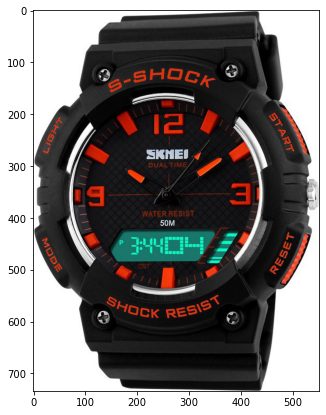

In [14]:
from PIL import Image
im = Image.open(path+data_pic.image[20])


plt.figure(figsize=(7, 7))
plt.imshow(im)

Regardons 5 produits de chaque categories de notre dataset pour voir la diversité des observations 

HomeFurnishing


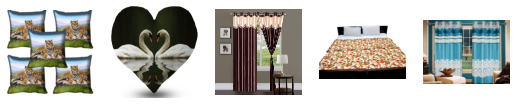

BabyCare


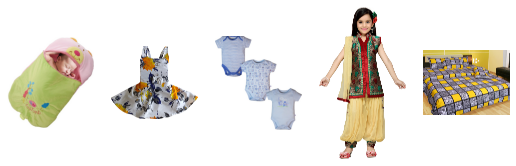

Watches


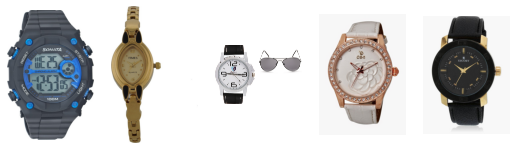

HomeDecorFestiveNeeds


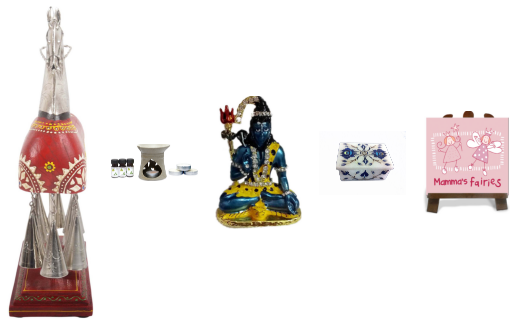

KitchenDining


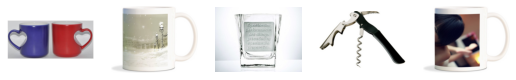

BeautyandPersonalCare


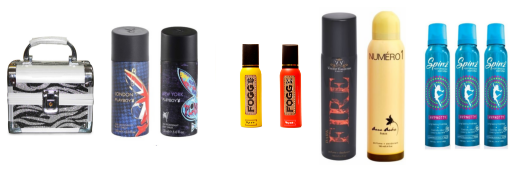

Computers


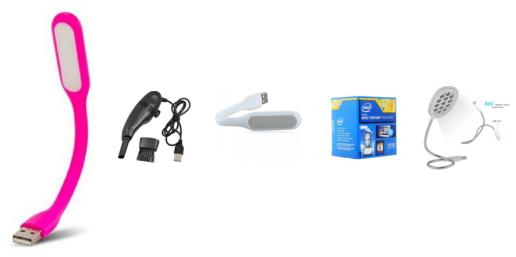

In [17]:
list_categories = df["categories"].unique()
for name in list_categories:
    plt.figure(figsize=(9, 9))

    print(name)

    for i in range(5):
        plt.subplot(150 + 1 + i)
        for i in df[df["categories"] == name].image.sample(3):
            photos = path + i
            image = Image.open(photos)
            plt.axis('off')
            plt.imshow(image)
    plt.show()

Nous pouvons voir que certaine catégories vont etre plus simple a catégorisé dans la mesure ou il y a une similarité dans les produits tels que les montres où les produits de beautés 

#### Regardons la dimension des images 

In [18]:
largeur = []
hauteur = []
for x in range(len(listes_photos)):
    image = cv.imread(path+listes_photos[x])
    hauteur.append(image.shape[0])
    largeur.append(image.shape[1])
print(f"Hauteur maximum:{max(hauteur)} / Largeur maximum: {max(largeur)}")
print(f"Hauteur minimum:{min(hauteur)} / Largeur minimum: {min(largeur)}")

Hauteur maximum:11042 / Largeur maximum: 8484
Hauteur minimum:160 / Largeur minimum: 145


Nous pouvons voir que les images n'ont pas les meme dimensions dans cette mesure, il y aura un travail de restructuration de l'image 

# Appliquez tous les traitements que nous allons réaliser sur une image

image brut


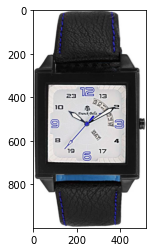

In [20]:
image = cv.imread(path+listes_photos[22])
print('image brut')
plt.imshow(image)

### Image en gris

Image en gris


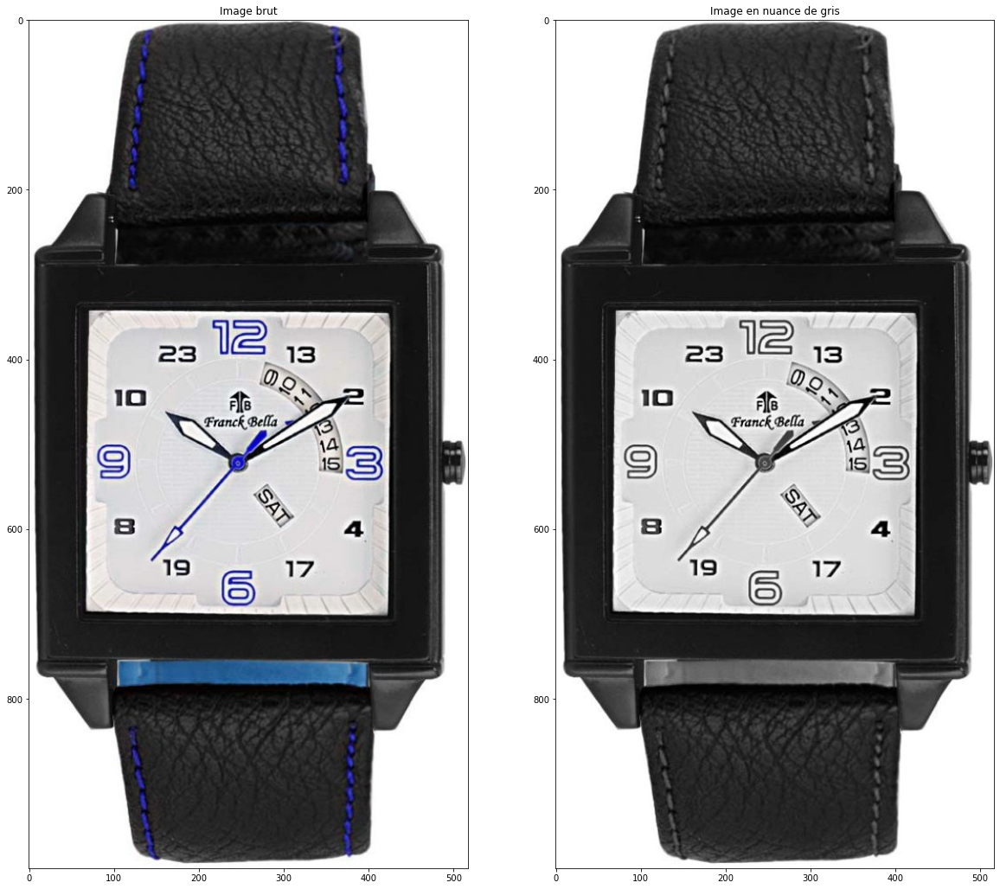

In [21]:
image_gris = cv.imread(path+listes_photos[22], 0)
print('Image en gris')


fx, plots = plt.subplots(1, 2, figsize=(20, 20))

plots[0].set_title("Image brut")
plots[0].imshow(image)

plots[1].set_title("Image en nuance de gris")
plots[1].imshow(image_gris, cmap='gray')

plt.show()

Image en gris en utilisant open CV

Image en gris


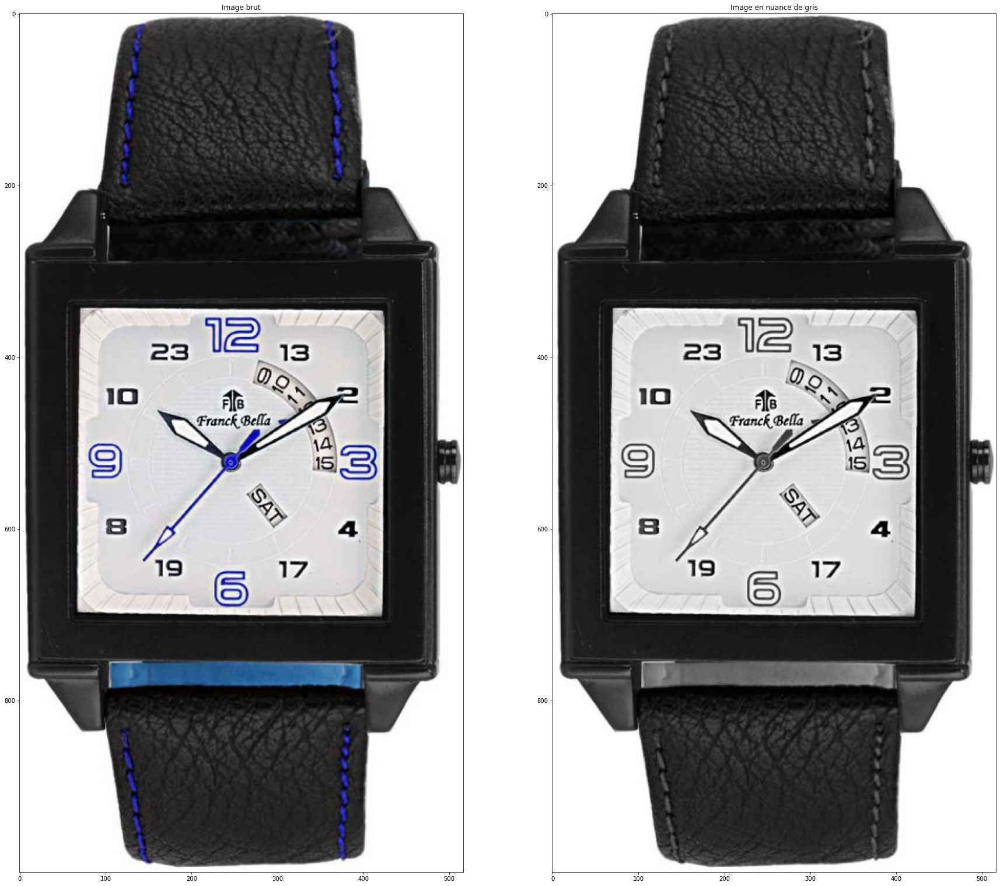

In [22]:
img = cv.imread(path+listes_photos[22], 1)
image_gris = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
print('Image en gris')


fx, plots = plt.subplots(1, 2, figsize=(30, 30))

plots[0].set_title("Image brut")
plots[0].imshow(image)

plots[1].set_title("Image en nuance de gris")
plots[1].imshow(image_gris, cmap='gray')

plt.show()

### Image estomper

image en blur


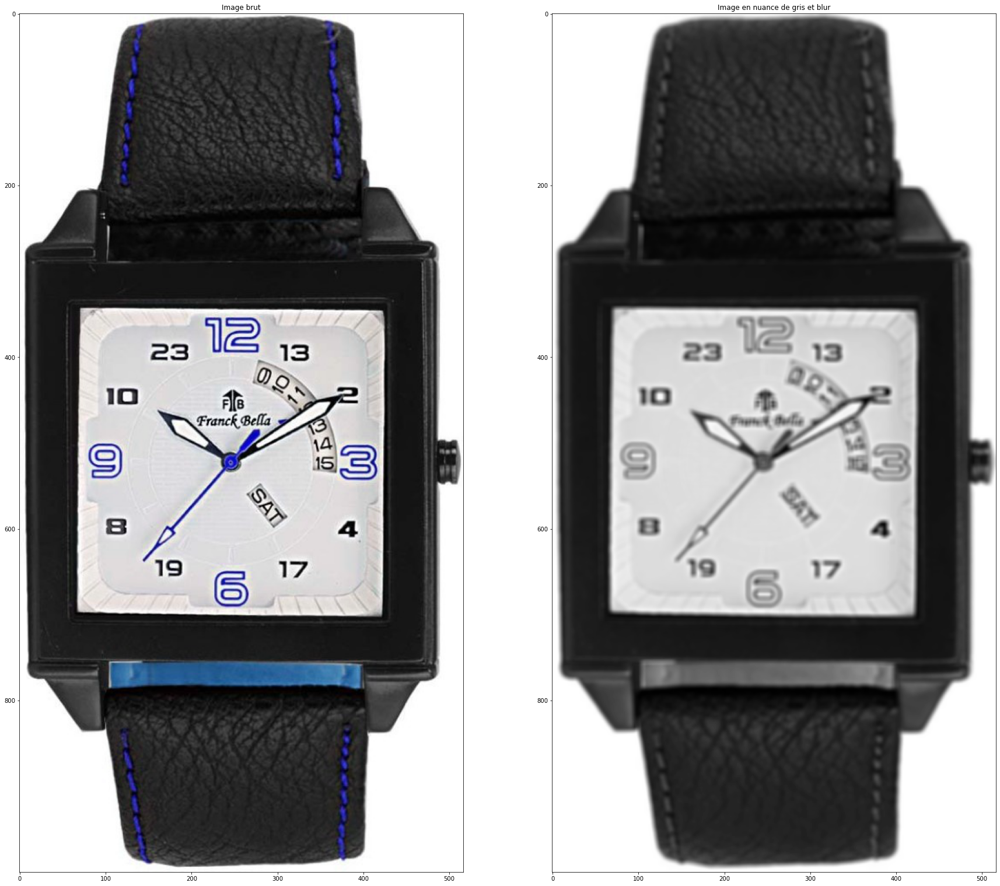

In [23]:
# blur
blur = cv.GaussianBlur(image_gris, (7, 7), cv.BORDER_DEFAULT)

print('image en blur')

fx, plots = plt.subplots(1, 2, figsize=(30, 30))

plots[0].set_title("Image brut")
plots[0].imshow(image)

plots[1].set_title("Image en nuance de gris et blur")
plots[1].imshow(blur, cmap='gray')


plt.show()

image redimensionné 1024


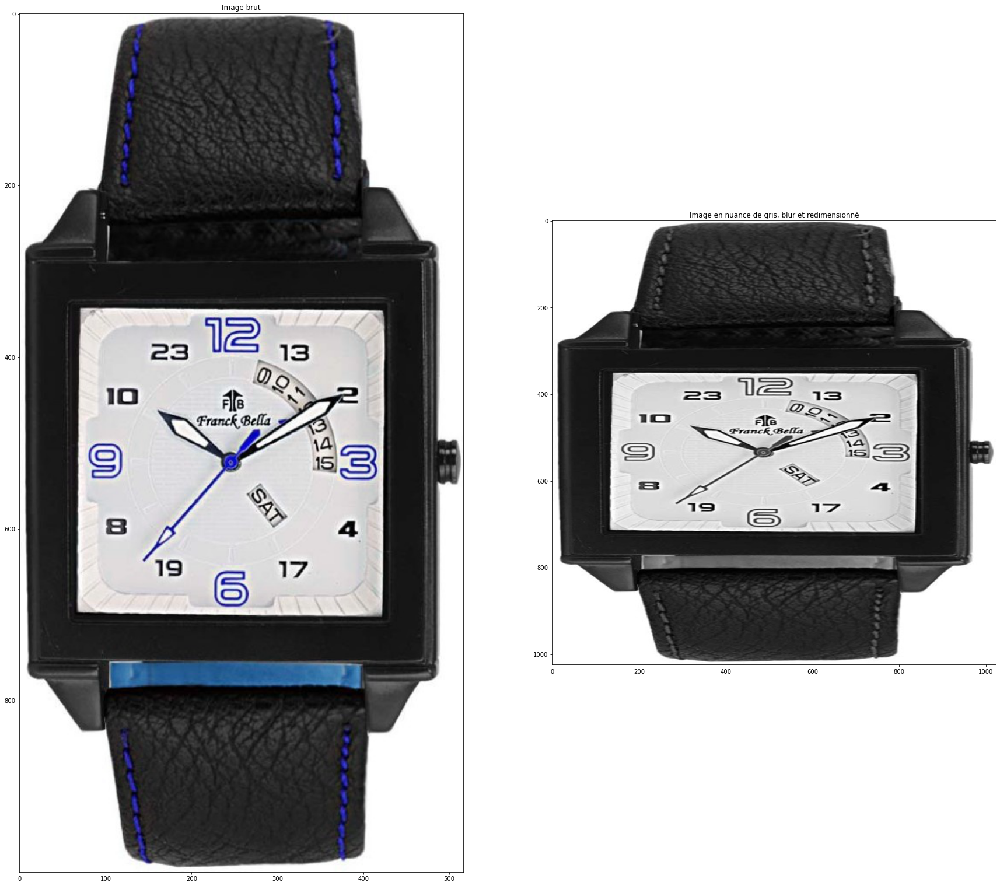

In [24]:
# Image redimensionné
resized = cv.resize(image_gris, (1024, 1024), interpolation=cv.INTER_CUBIC)

print('image redimensionné 1024')

fx, plots = plt.subplots(1, 2, figsize=(30, 30))

plots[0].set_title("Image brut")
plots[0].imshow(image)

plots[1].set_title("Image en nuance de gris, blur et redimensionné")
plots[1].imshow(resized, cmap='gray')


plt.show()

### Egalisation des histogrammes

image egalisé des histogrammes


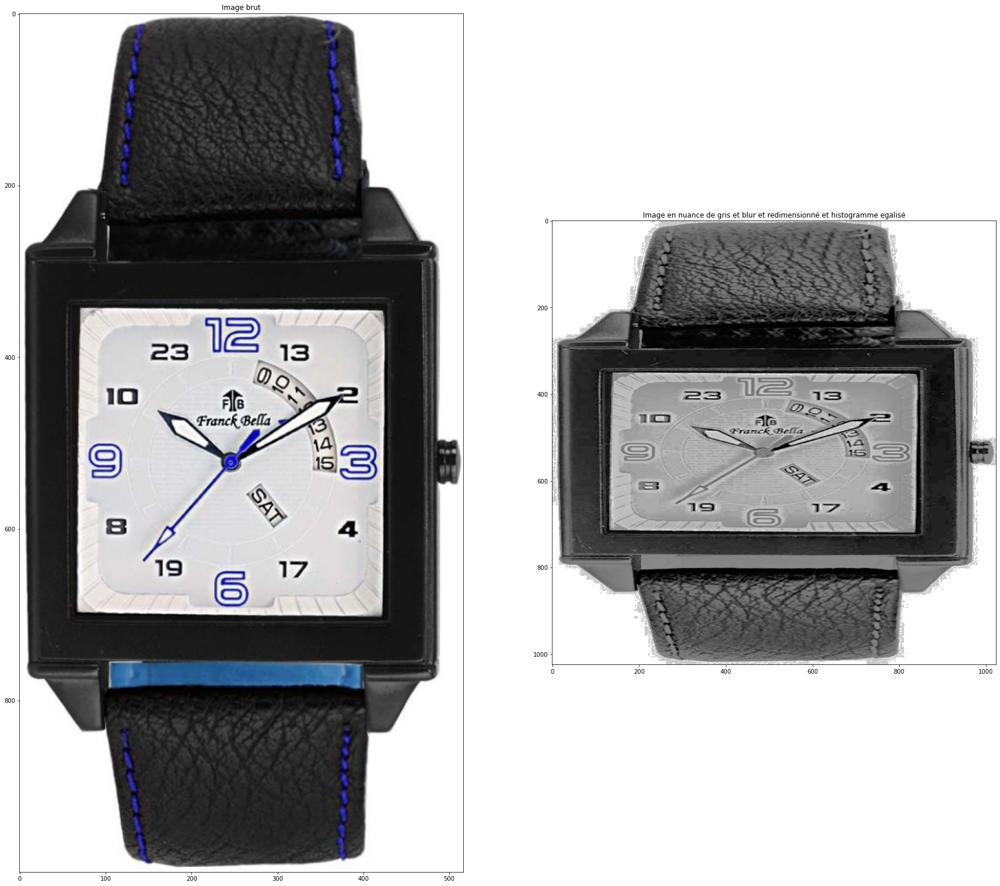

In [26]:
# Histogram equalization
hist = cv.equalizeHist(resized)

print('image egalisé des histogrammes')

fx, plots = plt.subplots(1, 2, figsize=(30, 30))

plots[0].set_title("Image brut")
plots[0].imshow(image)

plots[1].set_title(
    "Image en nuance de gris et blur et redimensionné et histogramme egalisé")
plots[1].imshow(hist, cmap='gray')

plt.show()

### Egalisation des histogrammes adapté

image egalisé des histogrammes


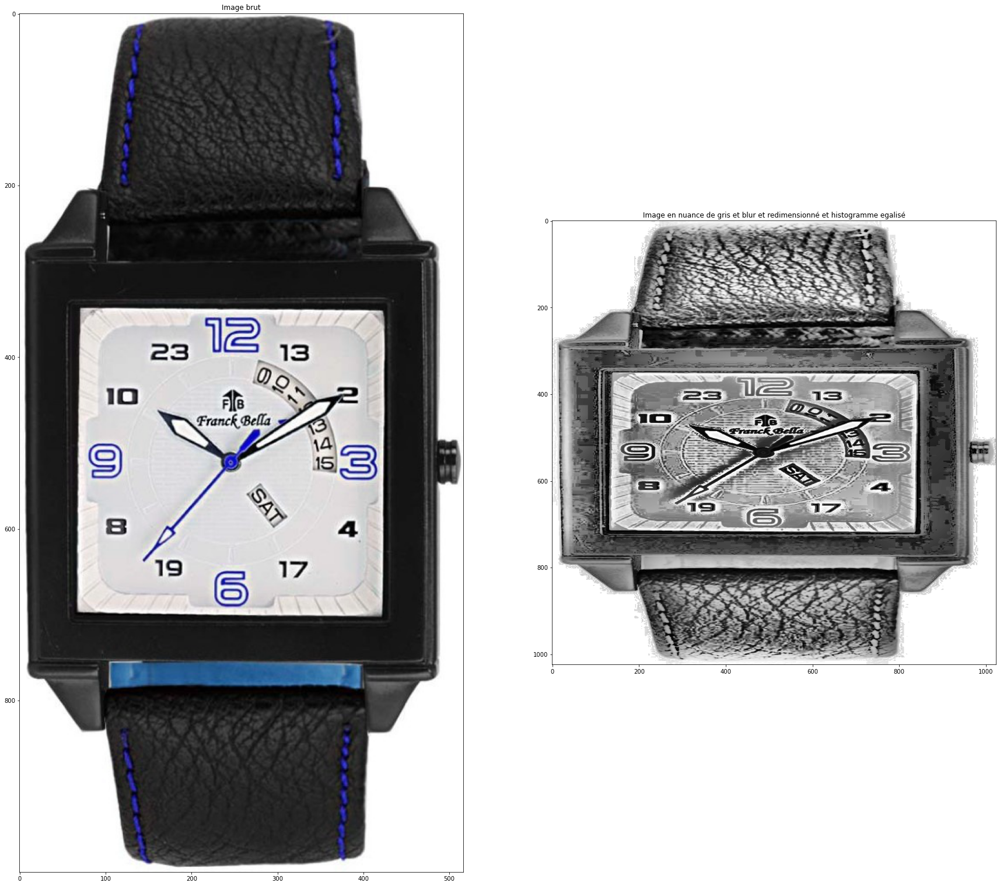

In [27]:
# adaptive histogram equalization
clahe = cv.createCLAHE()
image_hist = clahe.apply(resized)

print('image egalisé des histogrammes')

fx, plots = plt.subplots(1, 2, figsize=(30, 30))

plots[0].set_title("Image brut")
plots[0].imshow(image)

plots[1].set_title(
    "Image en nuance de gris et blur et redimensionné et histogramme egalisé")
plots[1].imshow(image_hist, cmap='gray')

plt.show()

### Descripteur SIFT
Le Scale-Invariant Feature Transform (SIFT) est un algorithme de détection de features pour détecter et décrire les caractéristiques locales dans des images.

Image prétraitée et descripteurs SIFT


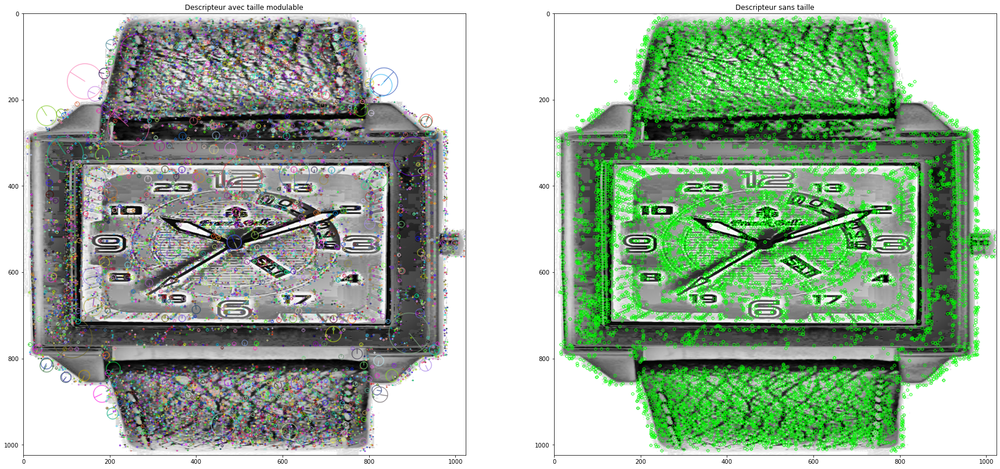

SIFT - Nombre de features=11805 pour 128 descripteurs
[[  8.  30.  61. ...   0.   0.   0.]
 [173.  41.   0. ...   4.   7.   4.]
 [175.   2.   0. ...   1.   0.   1.]
 ...
 [  0.   0.  17. ... 119.   6.   8.]
 [ 30.  37.  42. ...   0.   0.   1.]
 [  1.   1.   1. ...  14.  16.  36.]]


In [28]:
# SIFT
sift = cv.xfeatures2d.SIFT_create()
keypoint, descriptor = sift.detectAndCompute(image_hist, None)
img = cv.drawKeypoints(image_hist, keypoint, image_hist,
                       flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img_1 = cv.drawKeypoints(image_hist, keypoint, image_hist, color=(0, 255, 0))

print('Image prétraitée et descripteurs SIFT')

fx, plots = plt.subplots(1, 2, figsize=(30, 30))

plots[0].set_title("Descripteur avec taille modulable")
plots[0].imshow(img)

plots[1].set_title("Descripteur sans taille")
plots[1].imshow(img_1)


plt.show()

# Nombre de descripteur detecté dans l'image
nb_feat = descriptor.shape[0]
nb_desc = descriptor.shape[1]
print(f'SIFT - Nombre de features={nb_feat} pour {nb_desc} descripteurs')
print(descriptor)

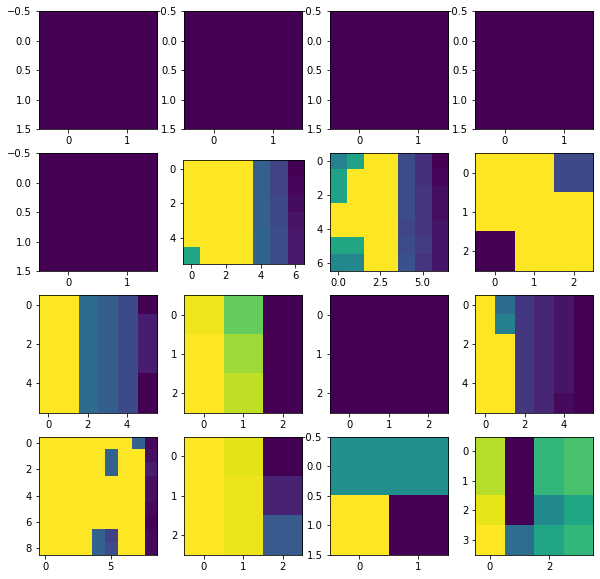

In [29]:
afficher_visual_words(image_hist, keypoint)

### Méthode ORB
ORB s'appuie sur le célèbre détecteur de point-clé FAST et le descripteur BRIEF

Image prétraitée et descripteurs ORB


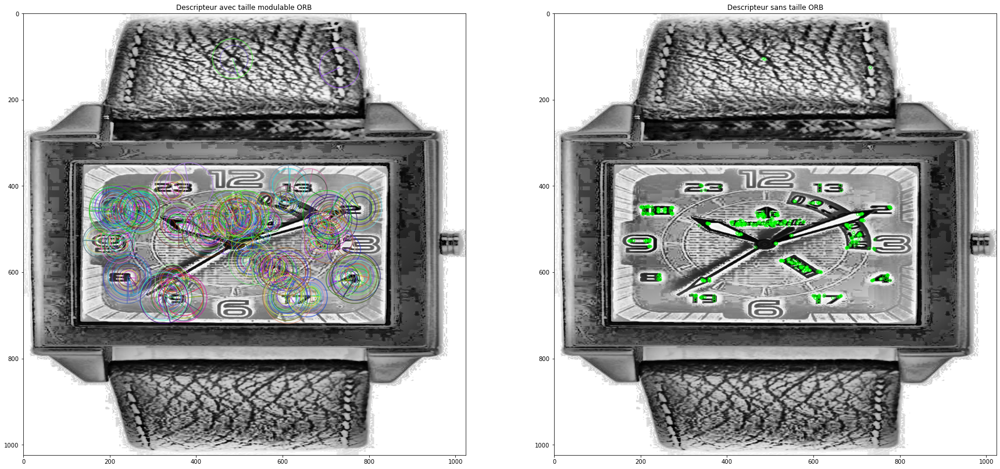

ORB - Nombre de features=500 pour 32 descripteurs
[[  9  94 213 ... 244 139 217]
 [131 114  74 ... 151  43 157]
 [184 218  30 ...   8  89 139]
 ...
 [131  97 235 ...  20 255 222]
 [125 213 234 ... 191 120  84]
 [  2 217 164 ...  31 133 184]]


In [30]:
orb = cv.ORB_create()

keypoints, descriptors = orb.detectAndCompute(image_hist, None)
image_orb = cv.drawKeypoints(image_hist, keypoints, image_hist,
                             flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img_orb1 = cv.drawKeypoints(
    image_hist, keypoints, image_hist, color=(0, 255, 0))

print('Image prétraitée et descripteurs ORB')

fx, plots = plt.subplots(1, 2, figsize=(30, 30))

plots[0].set_title("Descripteur avec taille modulable ORB")
plots[0].imshow(image_orb)

plots[1].set_title("Descripteur sans taille ORB")
plots[1].imshow(img_orb1)


plt.show()

# Nombre de descripteur detecté dans l'image
nb_feat = descriptors.shape[0]
nb_desc = descriptors.shape[1]
print(f'ORB - Nombre de features={nb_feat} pour {nb_desc} descripteurs')
print(descriptors)

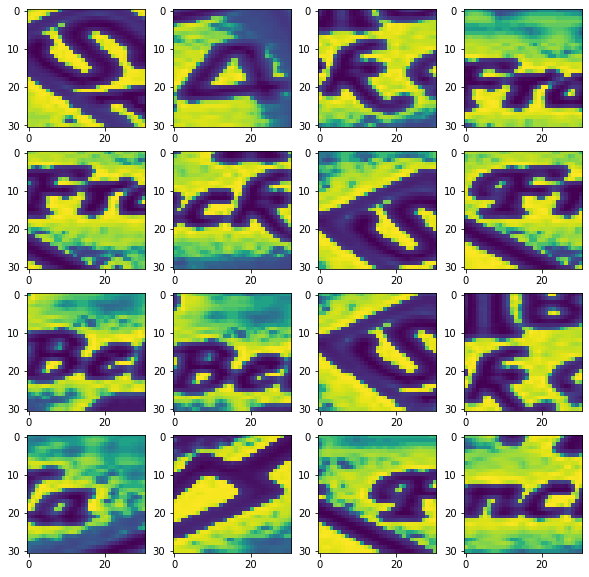

In [31]:
afficher_visual_words(image_hist, keypoints)

#### Méthode Surf

Image prétraitée et descripteurs surf


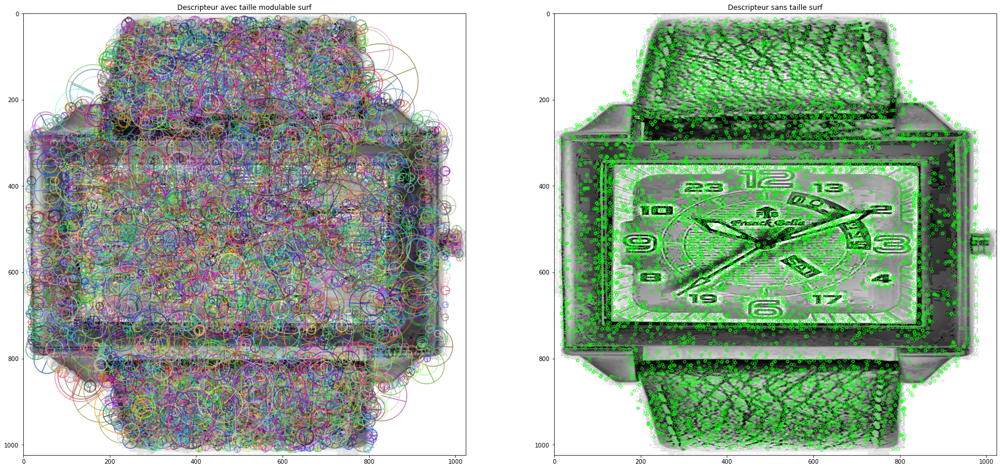

SURF - Nombre de features=8739 pour 64 descripteurs
[[ 0.00284901 -0.00044059  0.00399442 ... -0.00052548  0.00462987
   0.00080781]
 [ 0.00184141  0.00049571  0.00236485 ... -0.00065887  0.00295017
   0.00112895]
 [ 0.00029974  0.00016467  0.00034343 ... -0.00101178  0.00164892
   0.00341553]
 ...
 [-0.00380813  0.00433261  0.01262377 ...  0.00957139  0.00337393
   0.01158789]
 [ 0.00065506 -0.0006759   0.00135733 ...  0.00162707  0.0101017
   0.00162707]
 [-0.00213785  0.00570674  0.01201447 ...  0.00118238  0.00289624
   0.00121887]]


In [32]:
# Methode surf
surf = cv.xfeatures2d.SURF_create()
surf.setHessianThreshold(500)

keypoints, descriptors = surf.detectAndCompute(image_hist, None)
image_surf = cv.drawKeypoints(image_hist, keypoints, image_hist,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img_surf1 = cv.drawKeypoints(
    image_hist, keypoints, image_hist, color=(0, 255, 0))

print('Image prétraitée et descripteurs surf')

fx, plots = plt.subplots(1, 2, figsize=(30, 30))

plots[0].set_title("Descripteur avec taille modulable surf")
plots[0].imshow(image_surf)

plots[1].set_title("Descripteur sans taille surf")
plots[1].imshow(img_surf1)


plt.show()

# Nombre de descripteur detecté dans l'image
nb_feat = descriptors.shape[0]
nb_desc = descriptors.shape[1]
print(f'SURF - Nombre de features={nb_feat} pour {nb_desc} descripteurs')
print(descriptors)

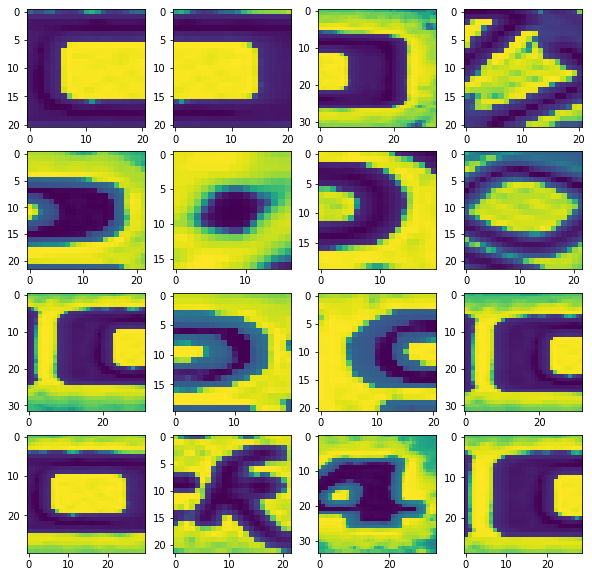

In [33]:
afficher_visual_words(image_hist, keypoints)

# Pré-traitement des images

 + Nous allons pour chaque photos de notre corpus transformer en gris les photos, réaliser un blur, egalisation des images et pour finir egaliser les histogrammes 

In [34]:
path = ('/Users/vincentMalfroy/Desktop/OpenClassrooms/projet 6/Flipkart/')

In [35]:
images_transformer = path + "Images_transformed"

In [36]:
preprocess_image = True
Images = []

for name_img in data_pic['image']:

    if preprocess_image:
        img = cv.imread(os.path.join(path + "Images/", name_img))
        img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
        img = cv.GaussianBlur(img, (7, 7), cv.BORDER_DEFAULT)
        img = clahe.apply(img)
        img = cv.resize(img, (1024, 1024), interpolation=cv.INTER_CUBIC)
        Images.append(img)
        img = Image.fromarray(img)
        img.save(os.path.join(images_transformer, name_img))

In [37]:
print(f'{len(Images)} images chargées')

1050 images chargées


### Test de notre nouvelle base de donnée 

In [38]:
path = ('/Users/vincentMalfroy/Desktop/OpenClassrooms/projet 6/Flipkart/Images_transformed/')

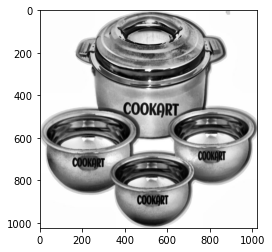

In [39]:
image = cv.imread(path+listes_photos[52])
plt.imshow(image)

Nous pouvons voir que notre image a été recadrer en 1024 par 1024, les histogrammes egalisés et en nuance de gris

# Plan de notre modélisation par SIFT

    1) Implémentation de Sift à toutes nos photos
    2) Création des clusters par MiniBatchKmeans
    3) Création des histogrammes pour le bag of visual Words
    4) Réduction de dimension par PCA
    5) Réduction de dimension pour la visualisation par Tsne
    6) Analyse de la modélisation :
   + ARI Score
   + Confusion Matrix (nombre d'érreur dans le modèle 

# Implémentation de Sift à toutes nos photos

In [40]:
images = df.image.sort_values().unique()

descriptor_list = []


for index, leaf in df['image'].iteritems():
    img = cv.imread(os.path.join(path, leaf))
    sift = cv.xfeatures2d.SIFT_create()
    kp, des = sift.detectAndCompute(img, None)

    for d in des:
        descriptor_list.append(d)

# Bag Word of Visual Bag

In [57]:
n_centers = 1000


batch_size = np.size(os.listdir(path)) * 3
model = MiniBatchKMeans(n_clusters=n_centers, batch_size=batch_size,
                        verbose=1)
model_kmeans = model.fit(descriptor_list)
visual_words = model_kmeans.cluster_centers_

labels = model.fit_predict(descriptor_list)
model_kmeans.labels_.shape

Init 1/3 with method: k-means++
Inertia for init 1/3: 614806476.552961
Init 2/3 with method: k-means++
Inertia for init 2/3: 615334142.817000
Init 3/3 with method: k-means++
Inertia for init 3/3: 615582545.231257
Minibatch iteration 1/120800: mean batch inertia: 76139.717081, ewa inertia: 76139.717081 
Minibatch iteration 2/120800: mean batch inertia: 75270.440891, ewa inertia: 76138.277061 
Minibatch iteration 3/120800: mean batch inertia: 74332.409068, ewa inertia: 76135.285508 
Minibatch iteration 4/120800: mean batch inertia: 74380.301661, ewa inertia: 76132.378249 
Minibatch iteration 5/120800: mean batch inertia: 73984.612367, ewa inertia: 76128.820317 
Minibatch iteration 6/120800: mean batch inertia: 73514.843515, ewa inertia: 76124.490073 
Minibatch iteration 7/120800: mean batch inertia: 72474.343008, ewa inertia: 76118.443336 
Minibatch iteration 8/120800: mean batch inertia: 73006.648127, ewa inertia: 76113.288419 
Minibatch iteration 9/120800: mean batch inertia: 72365.211

Minibatch iteration 86/120800: mean batch inertia: 70315.212877, ewa inertia: 75467.705118 
Minibatch iteration 87/120800: mean batch inertia: 69992.620881, ewa inertia: 75458.635239 
Minibatch iteration 88/120800: mean batch inertia: 69962.516705, ewa inertia: 75449.530516 
Minibatch iteration 89/120800: mean batch inertia: 70221.649448, ewa inertia: 75440.870147 
Minibatch iteration 90/120800: mean batch inertia: 70280.171524, ewa inertia: 75432.321071 
Minibatch iteration 91/120800: mean batch inertia: 70410.758727, ewa inertia: 75424.002485 
[MiniBatchKMeans] Reassigning 5 cluster centers.
Minibatch iteration 92/120800: mean batch inertia: 70235.019647, ewa inertia: 75415.406554 
Minibatch iteration 93/120800: mean batch inertia: 70889.334268, ewa inertia: 75407.908783 
Minibatch iteration 94/120800: mean batch inertia: 70433.559685, ewa inertia: 75399.668409 
Minibatch iteration 95/120800: mean batch inertia: 69933.937902, ewa inertia: 75390.614025 
Minibatch iteration 96/120800: 

Minibatch iteration 176/120800: mean batch inertia: 69420.551202, ewa inertia: 74699.112212 
Minibatch iteration 177/120800: mean batch inertia: 69890.302763, ewa inertia: 74691.146067 
Minibatch iteration 178/120800: mean batch inertia: 69892.677177, ewa inertia: 74683.197051 
Minibatch iteration 179/120800: mean batch inertia: 69861.768383, ewa inertia: 74675.210001 
Minibatch iteration 180/120800: mean batch inertia: 69852.463617, ewa inertia: 74667.220767 
Minibatch iteration 181/120800: mean batch inertia: 69685.640379, ewa inertia: 74658.968414 
Minibatch iteration 182/120800: mean batch inertia: 69640.819730, ewa inertia: 74650.655482 
Minibatch iteration 183/120800: mean batch inertia: 69647.390853, ewa inertia: 74642.367207 
Minibatch iteration 184/120800: mean batch inertia: 70361.739558, ewa inertia: 74635.276034 
Minibatch iteration 185/120800: mean batch inertia: 69750.830426, ewa inertia: 74627.184591 
Minibatch iteration 186/120800: mean batch inertia: 70127.225002, ewa 

Minibatch iteration 266/120800: mean batch inertia: 69830.533778, ewa inertia: 74013.846776 
Minibatch iteration 267/120800: mean batch inertia: 70077.002128, ewa inertia: 74007.325104 
Minibatch iteration 268/120800: mean batch inertia: 69198.515195, ewa inertia: 73999.358957 
Minibatch iteration 269/120800: mean batch inertia: 69212.279395, ewa inertia: 73991.428809 
Minibatch iteration 270/120800: mean batch inertia: 69756.238098, ewa inertia: 73984.412905 
Minibatch iteration 271/120800: mean batch inertia: 70097.773817, ewa inertia: 73977.974402 
Minibatch iteration 272/120800: mean batch inertia: 69308.789011, ewa inertia: 73970.239554 
Minibatch iteration 273/120800: mean batch inertia: 69141.743519, ewa inertia: 73962.240796 
Minibatch iteration 274/120800: mean batch inertia: 69237.468109, ewa inertia: 73954.413863 
Minibatch iteration 275/120800: mean batch inertia: 69734.080479, ewa inertia: 73947.422571 
Minibatch iteration 276/120800: mean batch inertia: 69148.798937, ewa 

Minibatch iteration 356/120800: mean batch inertia: 69321.472841, ewa inertia: 73400.615128 
Minibatch iteration 357/120800: mean batch inertia: 69471.497426, ewa inertia: 73394.106257 
Minibatch iteration 358/120800: mean batch inertia: 70618.974636, ewa inertia: 73389.509047 
Minibatch iteration 359/120800: mean batch inertia: 69948.995176, ewa inertia: 73383.809584 
Minibatch iteration 360/120800: mean batch inertia: 69769.990059, ewa inertia: 73377.823027 
Minibatch iteration 361/120800: mean batch inertia: 69119.684059, ewa inertia: 73370.769107 
Minibatch iteration 362/120800: mean batch inertia: 70019.587348, ewa inertia: 73365.217628 
Minibatch iteration 363/120800: mean batch inertia: 69576.618378, ewa inertia: 73358.941536 
Minibatch iteration 364/120800: mean batch inertia: 69133.144740, ewa inertia: 73351.941193 
Minibatch iteration 365/120800: mean batch inertia: 68990.823500, ewa inertia: 73344.716682 
Minibatch iteration 366/120800: mean batch inertia: 68975.935006, ewa 

Minibatch iteration 446/120800: mean batch inertia: 69457.968993, ewa inertia: 72872.552232 
Minibatch iteration 447/120800: mean batch inertia: 68982.799168, ewa inertia: 72866.108570 
Minibatch iteration 448/120800: mean batch inertia: 69658.700250, ewa inertia: 72860.795263 
Minibatch iteration 449/120800: mean batch inertia: 68563.890706, ewa inertia: 72853.677126 
Minibatch iteration 450/120800: mean batch inertia: 69608.055755, ewa inertia: 72848.300516 
Minibatch iteration 451/120800: mean batch inertia: 69217.072394, ewa inertia: 72842.285120 
Minibatch iteration 452/120800: mean batch inertia: 69019.031115, ewa inertia: 72835.951619 
Minibatch iteration 453/120800: mean batch inertia: 69826.157446, ewa inertia: 72830.965674 
Minibatch iteration 454/120800: mean batch inertia: 69819.816729, ewa inertia: 72825.977485 
Minibatch iteration 455/120800: mean batch inertia: 70050.599390, ewa inertia: 72821.379868 
Minibatch iteration 456/120800: mean batch inertia: 69970.980671, ewa 

Minibatch iteration 536/120800: mean batch inertia: 69993.071462, ewa inertia: 72407.766436 
Minibatch iteration 537/120800: mean batch inertia: 69095.614276, ewa inertia: 72402.279613 
Minibatch iteration 538/120800: mean batch inertia: 69576.937397, ewa inertia: 72397.599227 
Minibatch iteration 539/120800: mean batch inertia: 69798.736650, ewa inertia: 72393.294020 
Minibatch iteration 540/120800: mean batch inertia: 69630.631086, ewa inertia: 72388.717466 
Minibatch iteration 541/120800: mean batch inertia: 69363.631262, ewa inertia: 72383.706189 
Minibatch iteration 542/120800: mean batch inertia: 68621.687140, ewa inertia: 72377.474128 
Minibatch iteration 543/120800: mean batch inertia: 69047.302704, ewa inertia: 72371.957455 
Minibatch iteration 544/120800: mean batch inertia: 69429.020234, ewa inertia: 72367.082264 
Minibatch iteration 545/120800: mean batch inertia: 69761.551132, ewa inertia: 72362.766010 
Minibatch iteration 546/120800: mean batch inertia: 68990.302925, ewa 

Minibatch iteration 626/120800: mean batch inertia: 69614.725908, ewa inertia: 71989.322483 
Minibatch iteration 627/120800: mean batch inertia: 69310.308931, ewa inertia: 71984.884501 
Minibatch iteration 628/120800: mean batch inertia: 70077.449665, ewa inertia: 71981.724695 
Minibatch iteration 629/120800: mean batch inertia: 69361.414786, ewa inertia: 71977.383959 
Minibatch iteration 630/120800: mean batch inertia: 69452.160337, ewa inertia: 71973.200741 
Minibatch iteration 631/120800: mean batch inertia: 69174.887082, ewa inertia: 71968.565129 
Minibatch iteration 632/120800: mean batch inertia: 69387.306083, ewa inertia: 71964.289084 
Minibatch iteration 633/120800: mean batch inertia: 69303.682902, ewa inertia: 71959.881595 
Minibatch iteration 634/120800: mean batch inertia: 69600.932320, ewa inertia: 71955.973822 
Minibatch iteration 635/120800: mean batch inertia: 69334.231353, ewa inertia: 71951.630714 
Minibatch iteration 636/120800: mean batch inertia: 70225.682505, ewa 

Minibatch iteration 716/120800: mean batch inertia: 69442.409878, ewa inertia: 71622.039572 
Minibatch iteration 717/120800: mean batch inertia: 70160.186528, ewa inertia: 71619.617906 
Minibatch iteration 718/120800: mean batch inertia: 69062.152452, ewa inertia: 71615.381276 
Minibatch iteration 719/120800: mean batch inertia: 68983.629417, ewa inertia: 71611.021586 
Minibatch iteration 720/120800: mean batch inertia: 69204.893505, ewa inertia: 71607.035659 
Minibatch iteration 721/120800: mean batch inertia: 69108.124536, ewa inertia: 71602.896029 
Minibatch iteration 722/120800: mean batch inertia: 69385.919363, ewa inertia: 71599.223445 
Minibatch iteration 723/120800: mean batch inertia: 69574.804985, ewa inertia: 71595.869847 
Minibatch iteration 724/120800: mean batch inertia: 68506.871363, ewa inertia: 71590.752694 
Minibatch iteration 725/120800: mean batch inertia: 69685.825470, ewa inertia: 71587.597042 
Minibatch iteration 726/120800: mean batch inertia: 68872.106002, ewa 

Minibatch iteration 806/120800: mean batch inertia: 69853.382919, ewa inertia: 71316.250139 
Minibatch iteration 807/120800: mean batch inertia: 69383.800370, ewa inertia: 71313.048894 
Minibatch iteration 808/120800: mean batch inertia: 68683.069154, ewa inertia: 71308.692140 
Minibatch iteration 809/120800: mean batch inertia: 69471.502129, ewa inertia: 71305.648700 
Minibatch iteration 810/120800: mean batch inertia: 68974.322072, ewa inertia: 71301.786686 
Minibatch iteration 811/120800: mean batch inertia: 69533.793099, ewa inertia: 71298.857875 
Minibatch iteration 812/120800: mean batch inertia: 69526.305633, ewa inertia: 71295.921512 
Minibatch iteration 813/120800: mean batch inertia: 69329.909610, ewa inertia: 71292.664669 
Minibatch iteration 814/120800: mean batch inertia: 70168.617934, ewa inertia: 71290.802603 
Minibatch iteration 815/120800: mean batch inertia: 69916.552260, ewa inertia: 71288.526057 
Minibatch iteration 816/120800: mean batch inertia: 68873.297444, ewa 

Minibatch iteration 895/120800: mean batch inertia: 68840.029980, ewa inertia: 71045.967453 
Minibatch iteration 896/120800: mean batch inertia: 69267.684001, ewa inertia: 71043.021596 
Minibatch iteration 897/120800: mean batch inertia: 69250.785447, ewa inertia: 71040.052625 
Minibatch iteration 898/120800: mean batch inertia: 68851.611683, ewa inertia: 71036.427312 
Minibatch iteration 899/120800: mean batch inertia: 68940.223581, ewa inertia: 71032.954797 
Minibatch iteration 900/120800: mean batch inertia: 69398.274233, ewa inertia: 71030.246829 
Minibatch iteration 901/120800: mean batch inertia: 69525.516098, ewa inertia: 71027.754132 
Minibatch iteration 902/120800: mean batch inertia: 69751.805144, ewa inertia: 71025.640429 
Minibatch iteration 903/120800: mean batch inertia: 68670.407349, ewa inertia: 71021.738812 
Minibatch iteration 904/120800: mean batch inertia: 69366.071804, ewa inertia: 71018.996078 
Minibatch iteration 905/120800: mean batch inertia: 69451.090872, ewa 

Minibatch iteration 984/120800: mean batch inertia: 69640.312531, ewa inertia: 70808.857554 
Minibatch iteration 985/120800: mean batch inertia: 68555.848968, ewa inertia: 70805.125280 
Minibatch iteration 986/120800: mean batch inertia: 69203.571352, ewa inertia: 70802.472189 
Minibatch iteration 987/120800: mean batch inertia: 69030.284157, ewa inertia: 70799.536429 
Minibatch iteration 988/120800: mean batch inertia: 69533.725202, ewa inertia: 70797.439520 
Minibatch iteration 989/120800: mean batch inertia: 68742.845237, ewa inertia: 70794.035934 
Minibatch iteration 990/120800: mean batch inertia: 68782.819304, ewa inertia: 70790.704206 
Minibatch iteration 991/120800: mean batch inertia: 68748.018896, ewa inertia: 70787.320348 
Minibatch iteration 992/120800: mean batch inertia: 69341.649138, ewa inertia: 70784.925487 
Minibatch iteration 993/120800: mean batch inertia: 69106.142985, ewa inertia: 70782.144461 
Minibatch iteration 994/120800: mean batch inertia: 68943.120893, ewa 

Minibatch iteration 1074/120800: mean batch inertia: 68965.507918, ewa inertia: 70601.302635 
Minibatch iteration 1075/120800: mean batch inertia: 69727.325557, ewa inertia: 70599.854828 
Minibatch iteration 1076/120800: mean batch inertia: 69373.675382, ewa inertia: 70597.823572 
Minibatch iteration 1077/120800: mean batch inertia: 69414.587906, ewa inertia: 70595.863455 
Minibatch iteration 1078/120800: mean batch inertia: 69548.809718, ewa inertia: 70594.128934 
Minibatch iteration 1079/120800: mean batch inertia: 69499.157185, ewa inertia: 70592.315033 
Minibatch iteration 1080/120800: mean batch inertia: 69563.523262, ewa inertia: 70590.610764 
Minibatch iteration 1081/120800: mean batch inertia: 70027.395265, ewa inertia: 70589.677756 
Minibatch iteration 1082/120800: mean batch inertia: 69020.143241, ewa inertia: 70587.077707 
Minibatch iteration 1083/120800: mean batch inertia: 69665.238490, ewa inertia: 70585.550613 
Minibatch iteration 1084/120800: mean batch inertia: 69414.0

Minibatch iteration 1163/120800: mean batch inertia: 69819.724275, ewa inertia: 70418.435497 
Minibatch iteration 1164/120800: mean batch inertia: 69543.656614, ewa inertia: 70416.986362 
Minibatch iteration 1165/120800: mean batch inertia: 69659.548320, ewa inertia: 70415.731610 
Minibatch iteration 1166/120800: mean batch inertia: 69695.125942, ewa inertia: 70414.537874 
Minibatch iteration 1167/120800: mean batch inertia: 69016.683668, ewa inertia: 70412.222226 
Minibatch iteration 1168/120800: mean batch inertia: 68738.146211, ewa inertia: 70409.448996 
Minibatch iteration 1169/120800: mean batch inertia: 68885.029353, ewa inertia: 70406.923683 
Minibatch iteration 1170/120800: mean batch inertia: 69536.918429, ewa inertia: 70405.482455 
Minibatch iteration 1171/120800: mean batch inertia: 69039.264628, ewa inertia: 70403.219215 
Minibatch iteration 1172/120800: mean batch inertia: 69703.053163, ewa inertia: 70402.059339 
Minibatch iteration 1173/120800: mean batch inertia: 69281.7

Minibatch iteration 1252/120800: mean batch inertia: 68934.973719, ewa inertia: 70255.011425 
Minibatch iteration 1253/120800: mean batch inertia: 68173.897120, ewa inertia: 70251.563906 
Minibatch iteration 1254/120800: mean batch inertia: 69132.912700, ewa inertia: 70249.710778 
Minibatch iteration 1255/120800: mean batch inertia: 69509.485855, ewa inertia: 70248.484541 
Minibatch iteration 1256/120800: mean batch inertia: 68902.975098, ewa inertia: 70246.255606 
Minibatch iteration 1257/120800: mean batch inertia: 69996.130498, ewa inertia: 70245.841256 
Minibatch iteration 1258/120800: mean batch inertia: 69422.179067, ewa inertia: 70244.476799 
Minibatch iteration 1259/120800: mean batch inertia: 69469.955826, ewa inertia: 70243.193748 
Minibatch iteration 1260/120800: mean batch inertia: 69418.512312, ewa inertia: 70241.827603 
Minibatch iteration 1261/120800: mean batch inertia: 69413.879790, ewa inertia: 70240.456046 
Minibatch iteration 1262/120800: mean batch inertia: 69292.5

Minibatch iteration 1342/120800: mean batch inertia: 69434.562598, ewa inertia: 70123.259150 
Minibatch iteration 1343/120800: mean batch inertia: 69930.091280, ewa inertia: 70122.939153 
Minibatch iteration 1344/120800: mean batch inertia: 68849.515594, ewa inertia: 70120.829633 
Minibatch iteration 1345/120800: mean batch inertia: 68809.356426, ewa inertia: 70118.657082 
Minibatch iteration 1346/120800: mean batch inertia: 69084.051838, ewa inertia: 70116.943182 
Minibatch iteration 1347/120800: mean batch inertia: 69507.622385, ewa inertia: 70115.933798 
Minibatch iteration 1348/120800: mean batch inertia: 69222.321609, ewa inertia: 70114.453463 
Minibatch iteration 1349/120800: mean batch inertia: 68738.153933, ewa inertia: 70112.173522 
Minibatch iteration 1350/120800: mean batch inertia: 69017.673473, ewa inertia: 70110.360403 
Minibatch iteration 1351/120800: mean batch inertia: 69177.439574, ewa inertia: 70108.814951 
Minibatch iteration 1352/120800: mean batch inertia: 69625.6

Minibatch iteration 1430/120800: mean batch inertia: 69320.421786, ewa inertia: 70008.780575 
Minibatch iteration 1431/120800: mean batch inertia: 69109.220705, ewa inertia: 70007.290388 
Minibatch iteration 1432/120800: mean batch inertia: 69424.959159, ewa inertia: 70006.325713 
Minibatch iteration 1433/120800: mean batch inertia: 69762.864536, ewa inertia: 70005.922402 
Minibatch iteration 1434/120800: mean batch inertia: 69090.738436, ewa inertia: 70004.406333 
Minibatch iteration 1435/120800: mean batch inertia: 68845.761025, ewa inertia: 70002.486952 
Minibatch iteration 1436/120800: mean batch inertia: 69450.065321, ewa inertia: 70001.571825 
Minibatch iteration 1437/120800: mean batch inertia: 69275.428154, ewa inertia: 70000.368914 
Minibatch iteration 1438/120800: mean batch inertia: 68895.302689, ewa inertia: 69998.538291 
Minibatch iteration 1439/120800: mean batch inertia: 69305.346926, ewa inertia: 69997.389969 
Minibatch iteration 1440/120800: mean batch inertia: 68867.8

Minibatch iteration 1520/120800: mean batch inertia: 69329.719529, ewa inertia: 69901.471835 
Minibatch iteration 1521/120800: mean batch inertia: 69347.172442, ewa inertia: 69900.553597 
Minibatch iteration 1522/120800: mean batch inertia: 68754.386266, ewa inertia: 69898.654887 
Minibatch iteration 1523/120800: mean batch inertia: 69682.465253, ewa inertia: 69898.296753 
Minibatch iteration 1524/120800: mean batch inertia: 68947.750659, ewa inertia: 69896.722104 
Minibatch iteration 1525/120800: mean batch inertia: 69638.084813, ewa inertia: 69896.293652 
Minibatch iteration 1526/120800: mean batch inertia: 69081.951463, ewa inertia: 69894.944635 
Minibatch iteration 1527/120800: mean batch inertia: 68767.104620, ewa inertia: 69893.076285 
Minibatch iteration 1528/120800: mean batch inertia: 69727.362830, ewa inertia: 69892.801768 
Minibatch iteration 1529/120800: mean batch inertia: 68740.899601, ewa inertia: 69890.893558 
Minibatch iteration 1530/120800: mean batch inertia: 69439.1

Minibatch iteration 1610/120800: mean batch inertia: 69032.029872, ewa inertia: 69811.236052 
Minibatch iteration 1611/120800: mean batch inertia: 69811.169589, ewa inertia: 69811.235942 
Minibatch iteration 1612/120800: mean batch inertia: 68872.864944, ewa inertia: 69809.681462 
Minibatch iteration 1613/120800: mean batch inertia: 69142.270145, ewa inertia: 69808.575846 
Minibatch iteration 1614/120800: mean batch inertia: 69341.462536, ewa inertia: 69807.802039 
Minibatch iteration 1615/120800: mean batch inertia: 68450.957351, ewa inertia: 69805.554326 
Minibatch iteration 1616/120800: mean batch inertia: 69119.397813, ewa inertia: 69804.417657 
Minibatch iteration 1617/120800: mean batch inertia: 69011.735357, ewa inertia: 69803.104521 
Minibatch iteration 1618/120800: mean batch inertia: 69617.733861, ewa inertia: 69802.797441 
Minibatch iteration 1619/120800: mean batch inertia: 69583.153805, ewa inertia: 69802.433585 
Minibatch iteration 1620/120800: mean batch inertia: 68746.1

Minibatch iteration 1700/120800: mean batch inertia: 69077.642962, ewa inertia: 69722.413187 
Minibatch iteration 1701/120800: mean batch inertia: 69131.304623, ewa inertia: 69721.433972 
Minibatch iteration 1702/120800: mean batch inertia: 69406.730048, ewa inertia: 69720.912642 
Minibatch iteration 1703/120800: mean batch inertia: 69076.242116, ewa inertia: 69719.844698 
Minibatch iteration 1704/120800: mean batch inertia: 69235.557621, ewa inertia: 69719.042441 
Minibatch iteration 1705/120800: mean batch inertia: 69011.622055, ewa inertia: 69717.870547 
Minibatch iteration 1706/120800: mean batch inertia: 69323.361744, ewa inertia: 69717.217014 
Minibatch iteration 1707/120800: mean batch inertia: 69035.550974, ewa inertia: 69716.087784 
Minibatch iteration 1708/120800: mean batch inertia: 68892.901985, ewa inertia: 69714.724117 
Minibatch iteration 1709/120800: mean batch inertia: 68693.479476, ewa inertia: 69713.032350 
Minibatch iteration 1710/120800: mean batch inertia: 69380.3

Minibatch iteration 1790/120800: mean batch inertia: 68952.430486, ewa inertia: 69640.944593 
Minibatch iteration 1791/120800: mean batch inertia: 69534.041087, ewa inertia: 69640.767500 
Minibatch iteration 1792/120800: mean batch inertia: 69437.263248, ewa inertia: 69640.430380 
Minibatch iteration 1793/120800: mean batch inertia: 68628.976008, ewa inertia: 69638.754832 
Minibatch iteration 1794/120800: mean batch inertia: 69215.231132, ewa inertia: 69638.053233 
Minibatch iteration 1795/120800: mean batch inertia: 69842.774175, ewa inertia: 69638.392369 
Minibatch iteration 1796/120800: mean batch inertia: 68756.225964, ewa inertia: 69636.930995 
Minibatch iteration 1797/120800: mean batch inertia: 68776.096241, ewa inertia: 69635.504959 
Minibatch iteration 1798/120800: mean batch inertia: 68844.965205, ewa inertia: 69634.195372 
Minibatch iteration 1799/120800: mean batch inertia: 69159.293388, ewa inertia: 69633.408662 
Minibatch iteration 1800/120800: mean batch inertia: 69204.8

Minibatch iteration 1880/120800: mean batch inertia: 69059.920141, ewa inertia: 69590.625931 
Minibatch iteration 1881/120800: mean batch inertia: 69172.953654, ewa inertia: 69589.934026 
Minibatch iteration 1882/120800: mean batch inertia: 69027.179043, ewa inertia: 69589.001782 
Minibatch iteration 1883/120800: mean batch inertia: 69807.430945, ewa inertia: 69589.363626 
Minibatch iteration 1884/120800: mean batch inertia: 69330.217118, ewa inertia: 69588.934330 
Minibatch iteration 1885/120800: mean batch inertia: 68642.969600, ewa inertia: 69587.367270 
Minibatch iteration 1886/120800: mean batch inertia: 68966.481859, ewa inertia: 69586.338728 
Minibatch iteration 1887/120800: mean batch inertia: 68784.359760, ewa inertia: 69585.010191 
Minibatch iteration 1888/120800: mean batch inertia: 69056.466499, ewa inertia: 69584.134620 
Minibatch iteration 1889/120800: mean batch inertia: 69317.668564, ewa inertia: 69583.693199 
Minibatch iteration 1890/120800: mean batch inertia: 69441.6

Minibatch iteration 1970/120800: mean batch inertia: 69237.646662, ewa inertia: 69544.342665 
Minibatch iteration 1971/120800: mean batch inertia: 68980.895564, ewa inertia: 69543.409273 
Minibatch iteration 1972/120800: mean batch inertia: 68900.827427, ewa inertia: 69542.344789 
Minibatch iteration 1973/120800: mean batch inertia: 68741.874445, ewa inertia: 69541.018752 
Minibatch iteration 1974/120800: mean batch inertia: 69131.449150, ewa inertia: 69540.340269 
Minibatch iteration 1975/120800: mean batch inertia: 68685.115189, ewa inertia: 69538.923526 
Minibatch iteration 1976/120800: mean batch inertia: 68439.507428, ewa inertia: 69537.102263 
Minibatch iteration 1977/120800: mean batch inertia: 69491.401107, ewa inertia: 69537.026556 
Minibatch iteration 1978/120800: mean batch inertia: 69358.470261, ewa inertia: 69536.730764 
Minibatch iteration 1979/120800: mean batch inertia: 68616.252063, ewa inertia: 69535.205923 
Minibatch iteration 1980/120800: mean batch inertia: 69567.4

Minibatch iteration 2060/120800: mean batch inertia: 69059.410427, ewa inertia: 69490.153125 
Minibatch iteration 2061/120800: mean batch inertia: 68623.693584, ewa inertia: 69488.717771 
Minibatch iteration 2062/120800: mean batch inertia: 69174.537863, ewa inertia: 69488.197309 
Minibatch iteration 2063/120800: mean batch inertia: 68975.738643, ewa inertia: 69487.348384 
Minibatch iteration 2064/120800: mean batch inertia: 69076.487294, ewa inertia: 69486.667762 
Minibatch iteration 2065/120800: mean batch inertia: 69711.761514, ewa inertia: 69487.040647 
Minibatch iteration 2066/120800: mean batch inertia: 69165.940810, ewa inertia: 69486.508721 
Minibatch iteration 2067/120800: mean batch inertia: 69717.664302, ewa inertia: 69486.891647 
Minibatch iteration 2068/120800: mean batch inertia: 69019.131933, ewa inertia: 69486.116769 
Minibatch iteration 2069/120800: mean batch inertia: 69340.396217, ewa inertia: 69485.875372 
Minibatch iteration 2070/120800: mean batch inertia: 69386.3

Minibatch iteration 2150/120800: mean batch inertia: 68895.271806, ewa inertia: 69443.734283 
Minibatch iteration 2151/120800: mean batch inertia: 69420.666274, ewa inertia: 69443.696069 
Minibatch iteration 2152/120800: mean batch inertia: 69061.567118, ewa inertia: 69443.063044 
Minibatch iteration 2153/120800: mean batch inertia: 69155.710802, ewa inertia: 69442.587024 
Minibatch iteration 2154/120800: mean batch inertia: 69070.660082, ewa inertia: 69441.970900 
Minibatch iteration 2155/120800: mean batch inertia: 68746.487977, ewa inertia: 69440.818782 
Minibatch iteration 2156/120800: mean batch inertia: 68241.490619, ewa inertia: 69438.832006 
Minibatch iteration 2157/120800: mean batch inertia: 68957.440188, ewa inertia: 69438.034546 
Minibatch iteration 2158/120800: mean batch inertia: 69046.558197, ewa inertia: 69437.386036 
Minibatch iteration 2159/120800: mean batch inertia: 69094.174310, ewa inertia: 69436.817481 
Minibatch iteration 2160/120800: mean batch inertia: 68830.1

Minibatch iteration 2238/120800: mean batch inertia: 69575.852935, ewa inertia: 69405.941630 
Minibatch iteration 2239/120800: mean batch inertia: 68246.872420, ewa inertia: 69404.021547 
Minibatch iteration 2240/120800: mean batch inertia: 68990.493920, ewa inertia: 69403.336508 
Minibatch iteration 2241/120800: mean batch inertia: 68642.079687, ewa inertia: 69402.075431 
Minibatch iteration 2242/120800: mean batch inertia: 69335.926552, ewa inertia: 69401.965850 
Minibatch iteration 2243/120800: mean batch inertia: 68522.135107, ewa inertia: 69400.508346 
Minibatch iteration 2244/120800: mean batch inertia: 69225.950346, ewa inertia: 69400.219178 
Minibatch iteration 2245/120800: mean batch inertia: 68846.416697, ewa inertia: 69399.301763 
Minibatch iteration 2246/120800: mean batch inertia: 69542.278094, ewa inertia: 69399.538614 
Minibatch iteration 2247/120800: mean batch inertia: 69187.163954, ewa inertia: 69399.186800 
Minibatch iteration 2248/120800: mean batch inertia: 69189.0

Minibatch iteration 2328/120800: mean batch inertia: 68776.373086, ewa inertia: 69361.476296 
Minibatch iteration 2329/120800: mean batch inertia: 69186.699114, ewa inertia: 69361.186765 
Minibatch iteration 2330/120800: mean batch inertia: 68838.320522, ewa inertia: 69360.320598 
Minibatch iteration 2331/120800: mean batch inertia: 68879.385908, ewa inertia: 69359.523895 
Minibatch iteration 2332/120800: mean batch inertia: 68972.778811, ewa inertia: 69358.883223 
Minibatch iteration 2333/120800: mean batch inertia: 68657.425684, ewa inertia: 69357.721207 
Minibatch iteration 2334/120800: mean batch inertia: 69220.938305, ewa inertia: 69357.494616 
Minibatch iteration 2335/120800: mean batch inertia: 69517.141834, ewa inertia: 69357.759084 
Minibatch iteration 2336/120800: mean batch inertia: 69404.081020, ewa inertia: 69357.835819 
Minibatch iteration 2337/120800: mean batch inertia: 68463.181390, ewa inertia: 69356.353759 
Minibatch iteration 2338/120800: mean batch inertia: 69328.6

Minibatch iteration 17/120800: mean batch inertia: 71943.407648, ewa inertia: 75220.592352 
Minibatch iteration 18/120800: mean batch inertia: 71047.967016, ewa inertia: 75213.680092 
Minibatch iteration 19/120800: mean batch inertia: 70784.231851, ewa inertia: 75206.342386 
Minibatch iteration 20/120800: mean batch inertia: 71088.871241, ewa inertia: 75199.521493 
Minibatch iteration 21/120800: mean batch inertia: 71626.218998, ewa inertia: 75193.602055 
Minibatch iteration 22/120800: mean batch inertia: 70828.647332, ewa inertia: 75186.371187 
Minibatch iteration 23/120800: mean batch inertia: 70912.526436, ewa inertia: 75179.291250 
Minibatch iteration 24/120800: mean batch inertia: 70809.815268, ewa inertia: 75172.052892 
Minibatch iteration 25/120800: mean batch inertia: 71650.981608, ewa inertia: 75166.219980 
[MiniBatchKMeans] Reassigning 10 cluster centers.
Minibatch iteration 26/120800: mean batch inertia: 70893.611402, ewa inertia: 75159.142090 
Minibatch iteration 27/120800:

Minibatch iteration 105/120800: mean batch inertia: 69983.135669, ewa inertia: 74574.532625 
Minibatch iteration 106/120800: mean batch inertia: 69910.787726, ewa inertia: 74566.806789 
Minibatch iteration 107/120800: mean batch inertia: 70183.819904, ewa inertia: 74559.546050 
Minibatch iteration 108/120800: mean batch inertia: 69439.642635, ewa inertia: 74551.064554 
Minibatch iteration 109/120800: mean batch inertia: 70034.535498, ewa inertia: 74543.582593 
Minibatch iteration 110/120800: mean batch inertia: 69889.197010, ewa inertia: 74535.872261 
Minibatch iteration 111/120800: mean batch inertia: 70101.674826, ewa inertia: 74528.526688 
Minibatch iteration 112/120800: mean batch inertia: 69813.417067, ewa inertia: 74520.715763 
Minibatch iteration 113/120800: mean batch inertia: 70357.616509, ewa inertia: 74513.819284 
Minibatch iteration 114/120800: mean batch inertia: 69858.419196, ewa inertia: 74506.107272 
Minibatch iteration 115/120800: mean batch inertia: 69976.566643, ewa 

Minibatch iteration 194/120800: mean batch inertia: 69498.747651, ewa inertia: 73915.063135 
Minibatch iteration 195/120800: mean batch inertia: 69628.865657, ewa inertia: 73907.962734 
Minibatch iteration 196/120800: mean batch inertia: 69905.618531, ewa inertia: 73901.332557 
Minibatch iteration 197/120800: mean batch inertia: 69615.358448, ewa inertia: 73894.232527 
Minibatch iteration 198/120800: mean batch inertia: 69599.111376, ewa inertia: 73887.117343 
Minibatch iteration 199/120800: mean batch inertia: 69171.102825, ewa inertia: 73879.304919 
Minibatch iteration 200/120800: mean batch inertia: 69771.328288, ewa inertia: 73872.499754 
Minibatch iteration 201/120800: mean batch inertia: 70200.439919, ewa inertia: 73866.416718 
Minibatch iteration 202/120800: mean batch inertia: 69600.692517, ewa inertia: 73859.350233 
Minibatch iteration 203/120800: mean batch inertia: 69638.935146, ewa inertia: 73852.358806 
Minibatch iteration 204/120800: mean batch inertia: 70407.025774, ewa 

Minibatch iteration 284/120800: mean batch inertia: 69149.545354, ewa inertia: 73312.576651 
Minibatch iteration 285/120800: mean batch inertia: 69948.191738, ewa inertia: 73307.003300 
Minibatch iteration 286/120800: mean batch inertia: 69767.453638, ewa inertia: 73301.139776 
Minibatch iteration 287/120800: mean batch inertia: 69918.327213, ewa inertia: 73295.535899 
Minibatch iteration 288/120800: mean batch inertia: 69545.637964, ewa inertia: 73289.323918 
Minibatch iteration 289/120800: mean batch inertia: 69444.857185, ewa inertia: 73282.955277 
Minibatch iteration 290/120800: mean batch inertia: 69657.125081, ewa inertia: 73276.948823 
Minibatch iteration 291/120800: mean batch inertia: 69852.231792, ewa inertia: 73271.275528 
Minibatch iteration 292/120800: mean batch inertia: 70218.843972, ewa inertia: 73266.218951 
Minibatch iteration 293/120800: mean batch inertia: 69350.690323, ewa inertia: 73259.732591 
Minibatch iteration 294/120800: mean batch inertia: 69272.710520, ewa 

Minibatch iteration 373/120800: mean batch inertia: 69418.183262, ewa inertia: 72790.328280 
Minibatch iteration 374/120800: mean batch inertia: 69314.638868, ewa inertia: 72784.570546 
Minibatch iteration 375/120800: mean batch inertia: 69441.916411, ewa inertia: 72779.033194 
Minibatch iteration 376/120800: mean batch inertia: 69514.283872, ewa inertia: 72773.624897 
Minibatch iteration 377/120800: mean batch inertia: 69822.300646, ewa inertia: 72768.735812 
Minibatch iteration 378/120800: mean batch inertia: 69984.230999, ewa inertia: 72764.123075 
Minibatch iteration 379/120800: mean batch inertia: 69026.110629, ewa inertia: 72757.930783 
Minibatch iteration 380/120800: mean batch inertia: 70439.669816, ewa inertia: 72754.090414 
Minibatch iteration 381/120800: mean batch inertia: 69571.783570, ewa inertia: 72748.818689 
Minibatch iteration 382/120800: mean batch inertia: 69713.135392, ewa inertia: 72743.789857 
Minibatch iteration 383/120800: mean batch inertia: 69535.700743, ewa 

Minibatch iteration 462/120800: mean batch inertia: 68811.978957, ewa inertia: 72329.956413 
Minibatch iteration 463/120800: mean batch inertia: 69830.554957, ewa inertia: 72325.815971 
Minibatch iteration 464/120800: mean batch inertia: 69944.461784, ewa inertia: 72321.871083 
Minibatch iteration 465/120800: mean batch inertia: 69713.864563, ewa inertia: 72317.550729 
Minibatch iteration 466/120800: mean batch inertia: 69907.340647, ewa inertia: 72313.558039 
Minibatch iteration 467/120800: mean batch inertia: 69536.144011, ewa inertia: 72308.957049 
Minibatch iteration 468/120800: mean batch inertia: 70070.911154, ewa inertia: 72305.249562 
Minibatch iteration 469/120800: mean batch inertia: 69226.522760, ewa inertia: 72300.149425 
Minibatch iteration 470/120800: mean batch inertia: 69320.206540, ewa inertia: 72295.212931 
Minibatch iteration 471/120800: mean batch inertia: 69486.700080, ewa inertia: 72290.560423 
Minibatch iteration 472/120800: mean batch inertia: 69028.225441, ewa 

Minibatch iteration 552/120800: mean batch inertia: 69698.813911, ewa inertia: 71927.280198 
Minibatch iteration 553/120800: mean batch inertia: 69036.334853, ewa inertia: 71922.491135 
Minibatch iteration 554/120800: mean batch inertia: 69138.699232, ewa inertia: 71917.879580 
Minibatch iteration 555/120800: mean batch inertia: 69310.761341, ewa inertia: 71913.560697 
Minibatch iteration 556/120800: mean batch inertia: 68632.581317, ewa inertia: 71908.125514 
Minibatch iteration 557/120800: mean batch inertia: 68956.180148, ewa inertia: 71903.235400 
Minibatch iteration 558/120800: mean batch inertia: 69513.267068, ewa inertia: 71899.276242 
Minibatch iteration 559/120800: mean batch inertia: 69169.918072, ewa inertia: 71894.754860 
Minibatch iteration 560/120800: mean batch inertia: 69091.911912, ewa inertia: 71890.111745 
Minibatch iteration 561/120800: mean batch inertia: 69330.590059, ewa inertia: 71885.871709 
Minibatch iteration 562/120800: mean batch inertia: 69705.609994, ewa 

Minibatch iteration 642/120800: mean batch inertia: 69544.991103, ewa inertia: 71566.246849 
Minibatch iteration 643/120800: mean batch inertia: 69558.632289, ewa inertia: 71562.921088 
Minibatch iteration 644/120800: mean batch inertia: 69997.475868, ewa inertia: 71560.327814 
Minibatch iteration 645/120800: mean batch inertia: 70347.501076, ewa inertia: 71558.318677 
Minibatch iteration 646/120800: mean batch inertia: 69697.754614, ewa inertia: 71555.236516 
Minibatch iteration 647/120800: mean batch inertia: 69785.939926, ewa inertia: 71552.305547 
Minibatch iteration 648/120800: mean batch inertia: 69157.319541, ewa inertia: 71548.338076 
Minibatch iteration 649/120800: mean batch inertia: 69308.417495, ewa inertia: 71544.627484 
Minibatch iteration 650/120800: mean batch inertia: 69232.616641, ewa inertia: 71540.797468 
Minibatch iteration 651/120800: mean batch inertia: 68883.391683, ewa inertia: 71536.395280 
Minibatch iteration 652/120800: mean batch inertia: 68656.317969, ewa 

Minibatch iteration 733/120800: mean batch inertia: 69298.022959, ewa inertia: 71249.464363 
Minibatch iteration 734/120800: mean batch inertia: 69545.319109, ewa inertia: 71246.641322 
Minibatch iteration 735/120800: mean batch inertia: 69456.575954, ewa inertia: 71243.675947 
Minibatch iteration 736/120800: mean batch inertia: 69508.965561, ewa inertia: 71240.802272 
Minibatch iteration 737/120800: mean batch inertia: 69492.817237, ewa inertia: 71237.906606 
Minibatch iteration 738/120800: mean batch inertia: 69441.662219, ewa inertia: 71234.930996 
Minibatch iteration 739/120800: mean batch inertia: 69172.570447, ewa inertia: 71231.514544 
Minibatch iteration 740/120800: mean batch inertia: 69306.443233, ewa inertia: 71228.325522 
Minibatch iteration 741/120800: mean batch inertia: 69015.155453, ewa inertia: 71224.659244 
Minibatch iteration 742/120800: mean batch inertia: 69806.893143, ewa inertia: 71222.310610 
Minibatch iteration 743/120800: mean batch inertia: 69489.438828, ewa 

Minibatch iteration 823/120800: mean batch inertia: 68976.245329, ewa inertia: 70979.822025 
Minibatch iteration 824/120800: mean batch inertia: 69715.353971, ewa inertia: 70977.727341 
Minibatch iteration 825/120800: mean batch inertia: 68980.756119, ewa inertia: 70974.419212 
Minibatch iteration 826/120800: mean batch inertia: 69655.747889, ewa inertia: 70972.234736 
Minibatch iteration 827/120800: mean batch inertia: 69170.337681, ewa inertia: 70969.249761 
Minibatch iteration 828/120800: mean batch inertia: 68974.569242, ewa inertia: 70965.945427 
Minibatch iteration 829/120800: mean batch inertia: 68758.472306, ewa inertia: 70962.288586 
Minibatch iteration 830/120800: mean batch inertia: 69208.743810, ewa inertia: 70959.383710 
Minibatch iteration 831/120800: mean batch inertia: 69334.232640, ewa inertia: 70956.691528 
Minibatch iteration 832/120800: mean batch inertia: 69556.839378, ewa inertia: 70954.372570 
Minibatch iteration 833/120800: mean batch inertia: 69501.420761, ewa 

Minibatch iteration 914/120800: mean batch inertia: 69560.338823, ewa inertia: 70731.836477 
Minibatch iteration 915/120800: mean batch inertia: 69362.447589, ewa inertia: 70729.567984 
Minibatch iteration 916/120800: mean batch inertia: 69725.409845, ewa inertia: 70727.904522 
Minibatch iteration 917/120800: mean batch inertia: 69006.136193, ewa inertia: 70725.052287 
Minibatch iteration 918/120800: mean batch inertia: 68469.100554, ewa inertia: 70721.315137 
Minibatch iteration 919/120800: mean batch inertia: 69917.775392, ewa inertia: 70719.984014 
Minibatch iteration 920/120800: mean batch inertia: 69168.566755, ewa inertia: 70717.413978 
Minibatch iteration 921/120800: mean batch inertia: 69303.142226, ewa inertia: 70715.071133 
Minibatch iteration 922/120800: mean batch inertia: 68919.314972, ewa inertia: 70712.096331 
Minibatch iteration 923/120800: mean batch inertia: 68727.112727, ewa inertia: 70708.808060 
Minibatch iteration 924/120800: mean batch inertia: 69607.026441, ewa 

Minibatch iteration 1003/120800: mean batch inertia: 68897.560147, ewa inertia: 70530.081107 
Minibatch iteration 1004/120800: mean batch inertia: 69493.827328, ewa inertia: 70528.364477 
Minibatch iteration 1005/120800: mean batch inertia: 69075.801472, ewa inertia: 70525.958199 
Minibatch iteration 1006/120800: mean batch inertia: 68951.057038, ewa inertia: 70523.349260 
Minibatch iteration 1007/120800: mean batch inertia: 69707.968818, ewa inertia: 70521.998523 
Minibatch iteration 1008/120800: mean batch inertia: 68521.110579, ewa inertia: 70518.683905 
Minibatch iteration 1009/120800: mean batch inertia: 68851.613312, ewa inertia: 70515.922280 
Minibatch iteration 1010/120800: mean batch inertia: 68949.156914, ewa inertia: 70513.326818 
Minibatch iteration 1011/120800: mean batch inertia: 69326.160114, ewa inertia: 70511.360190 
Minibatch iteration 1012/120800: mean batch inertia: 69396.546927, ewa inertia: 70509.513420 
Minibatch iteration 1013/120800: mean batch inertia: 69395.1

Minibatch iteration 1093/120800: mean batch inertia: 69772.249487, ewa inertia: 70351.355155 
Minibatch iteration 1094/120800: mean batch inertia: 68694.015663, ewa inertia: 70348.609651 
Minibatch iteration 1095/120800: mean batch inertia: 69248.102309, ewa inertia: 70346.786580 
Minibatch iteration 1096/120800: mean batch inertia: 69064.926785, ewa inertia: 70344.663085 
Minibatch iteration 1097/120800: mean batch inertia: 69851.145390, ewa inertia: 70343.845537 
Minibatch iteration 1098/120800: mean batch inertia: 69379.429477, ewa inertia: 70342.247911 
Minibatch iteration 1099/120800: mean batch inertia: 69497.231570, ewa inertia: 70340.848079 
Minibatch iteration 1100/120800: mean batch inertia: 68871.776133, ewa inertia: 70338.414454 
Minibatch iteration 1101/120800: mean batch inertia: 69478.717963, ewa inertia: 70336.990303 
Minibatch iteration 1102/120800: mean batch inertia: 68558.650608, ewa inertia: 70334.044353 
Minibatch iteration 1103/120800: mean batch inertia: 68780.7

Minibatch iteration 1182/120800: mean batch inertia: 69267.761230, ewa inertia: 70194.762572 
Minibatch iteration 1183/120800: mean batch inertia: 69462.688080, ewa inertia: 70193.549837 
Minibatch iteration 1184/120800: mean batch inertia: 69134.594945, ewa inertia: 70191.795600 
Minibatch iteration 1185/120800: mean batch inertia: 69199.229365, ewa inertia: 70190.151341 
Minibatch iteration 1186/120800: mean batch inertia: 69326.928502, ewa inertia: 70188.721349 
Minibatch iteration 1187/120800: mean batch inertia: 69283.565157, ewa inertia: 70187.221892 
Minibatch iteration 1188/120800: mean batch inertia: 69653.602823, ewa inertia: 70186.337913 
Minibatch iteration 1189/120800: mean batch inertia: 68959.287985, ewa inertia: 70184.305214 
Minibatch iteration 1190/120800: mean batch inertia: 68962.026501, ewa inertia: 70182.280420 
Minibatch iteration 1191/120800: mean batch inertia: 69109.705618, ewa inertia: 70180.503621 
Minibatch iteration 1192/120800: mean batch inertia: 69166.3

Minibatch iteration 1272/120800: mean batch inertia: 68778.917112, ewa inertia: 70052.208620 
Minibatch iteration 1273/120800: mean batch inertia: 69557.583520, ewa inertia: 70051.389237 
Minibatch iteration 1274/120800: mean batch inertia: 69564.842147, ewa inertia: 70050.583236 
Minibatch iteration 1275/120800: mean batch inertia: 68945.313835, ewa inertia: 70048.752276 
Minibatch iteration 1276/120800: mean batch inertia: 69240.730477, ewa inertia: 70047.413729 
Minibatch iteration 1277/120800: mean batch inertia: 69573.618477, ewa inertia: 70046.628852 
Minibatch iteration 1278/120800: mean batch inertia: 69803.099642, ewa inertia: 70046.225428 
Minibatch iteration 1279/120800: mean batch inertia: 69561.000171, ewa inertia: 70045.421617 
Minibatch iteration 1280/120800: mean batch inertia: 68246.835629, ewa inertia: 70042.442127 
Minibatch iteration 1281/120800: mean batch inertia: 68645.233010, ewa inertia: 70040.127548 
Minibatch iteration 1282/120800: mean batch inertia: 68347.2

Minibatch iteration 1362/120800: mean batch inertia: 68634.717614, ewa inertia: 69930.990212 
Minibatch iteration 1363/120800: mean batch inertia: 69084.408699, ewa inertia: 69929.587788 
Minibatch iteration 1364/120800: mean batch inertia: 69197.513407, ewa inertia: 69928.375053 
Minibatch iteration 1365/120800: mean batch inertia: 69514.759716, ewa inertia: 69927.689869 
Minibatch iteration 1366/120800: mean batch inertia: 68762.579628, ewa inertia: 69925.759778 
Minibatch iteration 1367/120800: mean batch inertia: 69827.892663, ewa inertia: 69925.597654 
Minibatch iteration 1368/120800: mean batch inertia: 69787.089934, ewa inertia: 69925.368206 
Minibatch iteration 1369/120800: mean batch inertia: 68285.604453, ewa inertia: 69922.651817 
Minibatch iteration 1370/120800: mean batch inertia: 68994.096983, ewa inertia: 69921.113598 
Minibatch iteration 1371/120800: mean batch inertia: 68623.944217, ewa inertia: 69918.964742 
Minibatch iteration 1372/120800: mean batch inertia: 69029.7

Minibatch iteration 1452/120800: mean batch inertia: 68601.780821, ewa inertia: 69828.169594 
Minibatch iteration 1453/120800: mean batch inertia: 70366.733298, ewa inertia: 69829.061764 
Minibatch iteration 1454/120800: mean batch inertia: 69224.091707, ewa inertia: 69828.059587 
Minibatch iteration 1455/120800: mean batch inertia: 69804.326634, ewa inertia: 69828.020271 
Minibatch iteration 1456/120800: mean batch inertia: 68792.558621, ewa inertia: 69826.304953 
Minibatch iteration 1457/120800: mean batch inertia: 68660.923181, ewa inertia: 69824.374413 
Minibatch iteration 1458/120800: mean batch inertia: 69666.093505, ewa inertia: 69824.112209 
Minibatch iteration 1459/120800: mean batch inertia: 69512.871342, ewa inertia: 69823.596615 
Minibatch iteration 1460/120800: mean batch inertia: 68858.550830, ewa inertia: 69821.997946 
Minibatch iteration 1461/120800: mean batch inertia: 69022.407035, ewa inertia: 69820.673365 
Minibatch iteration 1462/120800: mean batch inertia: 69499.1

Minibatch iteration 1542/120800: mean batch inertia: 69482.764058, ewa inertia: 69733.845517 
Minibatch iteration 1543/120800: mean batch inertia: 69208.207435, ewa inertia: 69732.974759 
Minibatch iteration 1544/120800: mean batch inertia: 69780.580120, ewa inertia: 69733.053621 
Minibatch iteration 1545/120800: mean batch inertia: 69652.083332, ewa inertia: 69732.919488 
Minibatch iteration 1546/120800: mean batch inertia: 68813.350823, ewa inertia: 69731.396155 
Minibatch iteration 1547/120800: mean batch inertia: 69154.068808, ewa inertia: 69730.439770 
Minibatch iteration 1548/120800: mean batch inertia: 68792.821430, ewa inertia: 69728.886536 
Minibatch iteration 1549/120800: mean batch inertia: 68759.647453, ewa inertia: 69727.280920 
Minibatch iteration 1550/120800: mean batch inertia: 68874.012676, ewa inertia: 69725.867419 
Minibatch iteration 1551/120800: mean batch inertia: 68769.567015, ewa inertia: 69724.283237 
Minibatch iteration 1552/120800: mean batch inertia: 69847.1

Minibatch iteration 1632/120800: mean batch inertia: 69504.078058, ewa inertia: 69652.765198 
Minibatch iteration 1633/120800: mean batch inertia: 69098.737631, ewa inertia: 69651.847411 
Minibatch iteration 1634/120800: mean batch inertia: 68660.288384, ewa inertia: 69650.204821 
Minibatch iteration 1635/120800: mean batch inertia: 69308.860330, ewa inertia: 69649.639358 
Minibatch iteration 1636/120800: mean batch inertia: 69097.019648, ewa inertia: 69648.723903 
Minibatch iteration 1637/120800: mean batch inertia: 69827.391697, ewa inertia: 69649.019880 
Minibatch iteration 1638/120800: mean batch inertia: 69480.215991, ewa inertia: 69648.740244 
Minibatch iteration 1639/120800: mean batch inertia: 69003.005479, ewa inertia: 69647.670537 
Minibatch iteration 1640/120800: mean batch inertia: 68965.329238, ewa inertia: 69646.540188 
Minibatch iteration 1641/120800: mean batch inertia: 68755.351842, ewa inertia: 69645.063869 
Minibatch iteration 1642/120800: mean batch inertia: 69005.2

Minibatch iteration 1722/120800: mean batch inertia: 69017.859945, ewa inertia: 69577.070155 
Minibatch iteration 1723/120800: mean batch inertia: 69417.985290, ewa inertia: 69576.806619 
Minibatch iteration 1724/120800: mean batch inertia: 69370.880669, ewa inertia: 69576.465488 
Minibatch iteration 1725/120800: mean batch inertia: 69558.471847, ewa inertia: 69576.435680 
Minibatch iteration 1726/120800: mean batch inertia: 68587.662028, ewa inertia: 69574.797704 
Minibatch iteration 1727/120800: mean batch inertia: 68671.221070, ewa inertia: 69573.300863 
Minibatch iteration 1728/120800: mean batch inertia: 68729.340110, ewa inertia: 69571.902780 
Minibatch iteration 1729/120800: mean batch inertia: 69582.845393, ewa inertia: 69571.920907 
Minibatch iteration 1730/120800: mean batch inertia: 68916.173788, ewa inertia: 69570.834614 
Minibatch iteration 1731/120800: mean batch inertia: 69694.175306, ewa inertia: 69571.038937 
Minibatch iteration 1732/120800: mean batch inertia: 69497.8

Minibatch iteration 1812/120800: mean batch inertia: 69372.781785, ewa inertia: 69512.965037 
Minibatch iteration 1813/120800: mean batch inertia: 68867.641701, ewa inertia: 69511.896011 
Minibatch iteration 1814/120800: mean batch inertia: 69489.230479, ewa inertia: 69511.858464 
Minibatch iteration 1815/120800: mean batch inertia: 68699.493683, ewa inertia: 69510.512722 
Minibatch iteration 1816/120800: mean batch inertia: 68794.402849, ewa inertia: 69509.326434 
Minibatch iteration 1817/120800: mean batch inertia: 69395.105905, ewa inertia: 69509.137219 
Minibatch iteration 1818/120800: mean batch inertia: 68747.680514, ewa inertia: 69507.875810 
Minibatch iteration 1819/120800: mean batch inertia: 69777.547178, ewa inertia: 69508.322541 
Minibatch iteration 1820/120800: mean batch inertia: 69214.714214, ewa inertia: 69507.836157 
Minibatch iteration 1821/120800: mean batch inertia: 68904.648126, ewa inertia: 69506.836932 
Minibatch iteration 1822/120800: mean batch inertia: 68712.1

Minibatch iteration 1902/120800: mean batch inertia: 69463.913835, ewa inertia: 69468.781371 
Minibatch iteration 1903/120800: mean batch inertia: 68271.061472, ewa inertia: 69466.797260 
Minibatch iteration 1904/120800: mean batch inertia: 69228.367560, ewa inertia: 69466.402284 
Minibatch iteration 1905/120800: mean batch inertia: 68960.505252, ewa inertia: 69465.564229 
Minibatch iteration 1906/120800: mean batch inertia: 69269.747888, ewa inertia: 69465.239844 
Minibatch iteration 1907/120800: mean batch inertia: 68960.372630, ewa inertia: 69464.403495 
Minibatch iteration 1908/120800: mean batch inertia: 68729.241262, ewa inertia: 69463.185645 
Minibatch iteration 1909/120800: mean batch inertia: 68924.771502, ewa inertia: 69462.293722 
Minibatch iteration 1910/120800: mean batch inertia: 68803.633393, ewa inertia: 69461.202603 
Minibatch iteration 1911/120800: mean batch inertia: 68716.853240, ewa inertia: 69459.969534 
Minibatch iteration 1912/120800: mean batch inertia: 69069.2

Minibatch iteration 1991/120800: mean batch inertia: 69602.153631, ewa inertia: 69410.235618 
Minibatch iteration 1992/120800: mean batch inertia: 69297.797462, ewa inertia: 69410.049356 
Minibatch iteration 1993/120800: mean batch inertia: 68580.909448, ewa inertia: 69408.675825 
Minibatch iteration 1994/120800: mean batch inertia: 68814.821645, ewa inertia: 69407.692062 
Minibatch iteration 1995/120800: mean batch inertia: 68606.912793, ewa inertia: 69406.365513 
Minibatch iteration 1996/120800: mean batch inertia: 69135.499405, ewa inertia: 69405.916803 
Minibatch iteration 1997/120800: mean batch inertia: 69207.313957, ewa inertia: 69405.587803 
Minibatch iteration 1998/120800: mean batch inertia: 69303.271685, ewa inertia: 69405.418309 
Minibatch iteration 1999/120800: mean batch inertia: 68827.778656, ewa inertia: 69404.461406 
Minibatch iteration 2000/120800: mean batch inertia: 68931.808364, ewa inertia: 69403.678422 
Minibatch iteration 2001/120800: mean batch inertia: 69767.3

Minibatch iteration 2080/120800: mean batch inertia: 68539.645805, ewa inertia: 69367.546424 
Minibatch iteration 2081/120800: mean batch inertia: 68795.593784, ewa inertia: 69366.598943 
Minibatch iteration 2082/120800: mean batch inertia: 69465.100188, ewa inertia: 69366.762117 
Minibatch iteration 2083/120800: mean batch inertia: 69711.008389, ewa inertia: 69367.332386 
Minibatch iteration 2084/120800: mean batch inertia: 69352.107191, ewa inertia: 69367.307165 
Minibatch iteration 2085/120800: mean batch inertia: 69787.298733, ewa inertia: 69368.002912 
Minibatch iteration 2086/120800: mean batch inertia: 68763.526252, ewa inertia: 69367.001552 
Minibatch iteration 2087/120800: mean batch inertia: 68795.191981, ewa inertia: 69366.054307 
Minibatch iteration 2088/120800: mean batch inertia: 68709.291580, ewa inertia: 69364.966332 
Minibatch iteration 2089/120800: mean batch inertia: 69216.551425, ewa inertia: 69364.720471 
Minibatch iteration 2090/120800: mean batch inertia: 68690.5

Minibatch iteration 2170/120800: mean batch inertia: 69260.077077, ewa inertia: 69334.967238 
Minibatch iteration 2171/120800: mean batch inertia: 69038.010261, ewa inertia: 69334.475306 
Minibatch iteration 2172/120800: mean batch inertia: 69471.024243, ewa inertia: 69334.701510 
Minibatch iteration 2173/120800: mean batch inertia: 69071.802840, ewa inertia: 69334.265999 
Minibatch iteration 2174/120800: mean batch inertia: 68725.986711, ewa inertia: 69333.258340 
Minibatch iteration 2175/120800: mean batch inertia: 68920.899756, ewa inertia: 69332.575237 
Minibatch iteration 2176/120800: mean batch inertia: 68400.091797, ewa inertia: 69331.030510 
Minibatch iteration 2177/120800: mean batch inertia: 68658.852621, ewa inertia: 69329.916998 
Minibatch iteration 2178/120800: mean batch inertia: 69419.237372, ewa inertia: 69330.064964 
Minibatch iteration 2179/120800: mean batch inertia: 69217.864385, ewa inertia: 69329.879095 
Minibatch iteration 2180/120800: mean batch inertia: 69450.9

Minibatch iteration 2260/120800: mean batch inertia: 69065.985410, ewa inertia: 69311.962140 
Minibatch iteration 2261/120800: mean batch inertia: 68835.975709, ewa inertia: 69311.173633 
Minibatch iteration 2262/120800: mean batch inertia: 68937.108131, ewa inertia: 69310.553966 
Minibatch iteration 2263/120800: mean batch inertia: 68972.253636, ewa inertia: 69309.993547 
Minibatch iteration 2264/120800: mean batch inertia: 69354.613162, ewa inertia: 69310.067463 
Minibatch iteration 2265/120800: mean batch inertia: 69819.850875, ewa inertia: 69310.911956 
Minibatch iteration 2266/120800: mean batch inertia: 68889.075524, ewa inertia: 69310.213153 
Minibatch iteration 2267/120800: mean batch inertia: 68846.330634, ewa inertia: 69309.444698 
Minibatch iteration 2268/120800: mean batch inertia: 69135.397421, ewa inertia: 69309.156376 
Minibatch iteration 2269/120800: mean batch inertia: 68975.231174, ewa inertia: 69308.603204 
Minibatch iteration 2270/120800: mean batch inertia: 69136.3

(3806652,)

In [58]:
list_kmean = model_kmeans.labels_
list_kmean = list(set(list_kmean))

# Création de l'histogramme 

In [59]:
temps = time.time()
model.verbose = False

histo_list = []

for count, leaf in enumerate(df['image']):
    print(f'image processing number {count+1}/{df["image"].shape[0]}')
    img = cv.imread(os.path.join(path, leaf))
    kp, des = sift.detectAndCompute(img, None)

    histo = np.zeros(n_centers)
    nkp = np.size(kp)

    for d in des:  # par batch
        idx = model.predict([d])
        # Because we need normalized histograms, I prefere to add 1/nkp directly
        histo[idx] += 1/nkp

    histo_list.append(histo)

duration = time.time()-temps
print("temps de création histogrammes : ", "%15.2f" % duration, "secondes")

image processing number 1/1050
image processing number 2/1050
image processing number 3/1050
image processing number 4/1050
image processing number 5/1050
image processing number 6/1050
image processing number 7/1050
image processing number 8/1050
image processing number 9/1050
image processing number 10/1050
image processing number 11/1050
image processing number 12/1050
image processing number 13/1050
image processing number 14/1050
image processing number 15/1050
image processing number 16/1050
image processing number 17/1050
image processing number 18/1050
image processing number 19/1050
image processing number 20/1050
image processing number 21/1050
image processing number 22/1050
image processing number 23/1050
image processing number 24/1050
image processing number 25/1050
image processing number 26/1050
image processing number 27/1050
image processing number 28/1050
image processing number 29/1050
image processing number 30/1050
image processing number 31/1050
image processing 

image processing number 253/1050
image processing number 254/1050
image processing number 255/1050
image processing number 256/1050
image processing number 257/1050
image processing number 258/1050
image processing number 259/1050
image processing number 260/1050
image processing number 261/1050
image processing number 262/1050
image processing number 263/1050
image processing number 264/1050
image processing number 265/1050
image processing number 266/1050
image processing number 267/1050
image processing number 268/1050
image processing number 269/1050
image processing number 270/1050
image processing number 271/1050
image processing number 272/1050
image processing number 273/1050
image processing number 274/1050
image processing number 275/1050
image processing number 276/1050
image processing number 277/1050
image processing number 278/1050
image processing number 279/1050
image processing number 280/1050
image processing number 281/1050
image processing number 282/1050
image proc

image processing number 502/1050
image processing number 503/1050
image processing number 504/1050
image processing number 505/1050
image processing number 506/1050
image processing number 507/1050
image processing number 508/1050
image processing number 509/1050
image processing number 510/1050
image processing number 511/1050
image processing number 512/1050
image processing number 513/1050
image processing number 514/1050
image processing number 515/1050
image processing number 516/1050
image processing number 517/1050
image processing number 518/1050
image processing number 519/1050
image processing number 520/1050
image processing number 521/1050
image processing number 522/1050
image processing number 523/1050
image processing number 524/1050
image processing number 525/1050
image processing number 526/1050
image processing number 527/1050
image processing number 528/1050
image processing number 529/1050
image processing number 530/1050
image processing number 531/1050
image proc

image processing number 751/1050
image processing number 752/1050
image processing number 753/1050
image processing number 754/1050
image processing number 755/1050
image processing number 756/1050
image processing number 757/1050
image processing number 758/1050
image processing number 759/1050
image processing number 760/1050
image processing number 761/1050
image processing number 762/1050
image processing number 763/1050
image processing number 764/1050
image processing number 765/1050
image processing number 766/1050
image processing number 767/1050
image processing number 768/1050
image processing number 769/1050
image processing number 770/1050
image processing number 771/1050
image processing number 772/1050
image processing number 773/1050
image processing number 774/1050
image processing number 775/1050
image processing number 776/1050
image processing number 777/1050
image processing number 778/1050
image processing number 779/1050
image processing number 780/1050
image proc

image processing number 1000/1050
image processing number 1001/1050
image processing number 1002/1050
image processing number 1003/1050
image processing number 1004/1050
image processing number 1005/1050
image processing number 1006/1050
image processing number 1007/1050
image processing number 1008/1050
image processing number 1009/1050
image processing number 1010/1050
image processing number 1011/1050
image processing number 1012/1050
image processing number 1013/1050
image processing number 1014/1050
image processing number 1015/1050
image processing number 1016/1050
image processing number 1017/1050
image processing number 1018/1050
image processing number 1019/1050
image processing number 1020/1050
image processing number 1021/1050
image processing number 1022/1050
image processing number 1023/1050
image processing number 1024/1050
image processing number 1025/1050
image processing number 1026/1050
image processing number 1027/1050
image processing number 1028/1050
image processi

In [60]:
temps1 = time.time()
im_features_sift = np.array(histo_list)
print(f'Dimensions of the histogram matrix: {im_features_sift.shape}')

duration1 = time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")

Dimensions of the histogram matrix: (1050, 1000)
temps de création histogrammes :             0.01 secondes


# Réductions de dimension
## Réduction de dimension PCA

+ Afin nous permettre de visualiser graphiquement les regroupements de nos produits en fonction de leur description mais également d'améliorer les performances de notre moteur de classification, nous allons appliquer une réduction de dimension à notre matrice de vecteurs.
+ La réduction PCA permet de créer des features décorrélées entre elles, et de diminuer leur dimension, tout en gardant un niveau de variance expliquée élevé (90%) afin de ne pas sacrifier la qualité de nos données tout en réduisant drastiquement le temps nécessaire à l'application de T-SNE pour la réduction en 2 dimensions de nos histogrammes.
+ L'impact est une meilleure séparation des données via le T-SNE et une réduction du temps de traitement du T-SNE


(1050, 183)



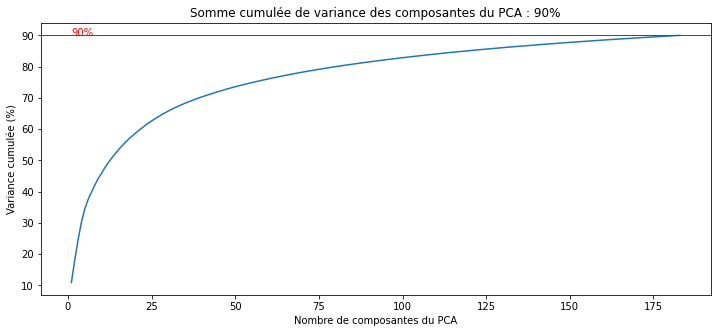

In [61]:
pca_sift, feat_pca_sift = pca_function(im_features_sift)
pca_graph(pca_sift)

In [62]:
from sklearn import manifold, decomposition

print("Dimensions dataset avant réduction PCA : ", im_features_sift.shape)
pca = decomposition.PCA(n_components=0.90)
feat_pca_sift = pca.fit_transform(im_features_sift)
print("Dimensions dataset après réduction PCA : ", feat_pca_sift.shape)

Dimensions dataset avant réduction PCA :  (1050, 1000)
Dimensions dataset après réduction PCA :  (1050, 183)


## Réduction de dimension TSNE

In [154]:
tsne = manifold.TSNE(n_components=2, perplexity=30,
                     random_state=6)
X_tsne_sift = tsne.fit_transform(feat_pca_sift)

df_tsne = pd.DataFrame(X_tsne_sift[:, 0:2], columns=['tsne1', 'tsne2'])
df_tsne["class"] = data_pic["categories"]

## Analyse visuelle : affichage T-SNE selon catégories d'images

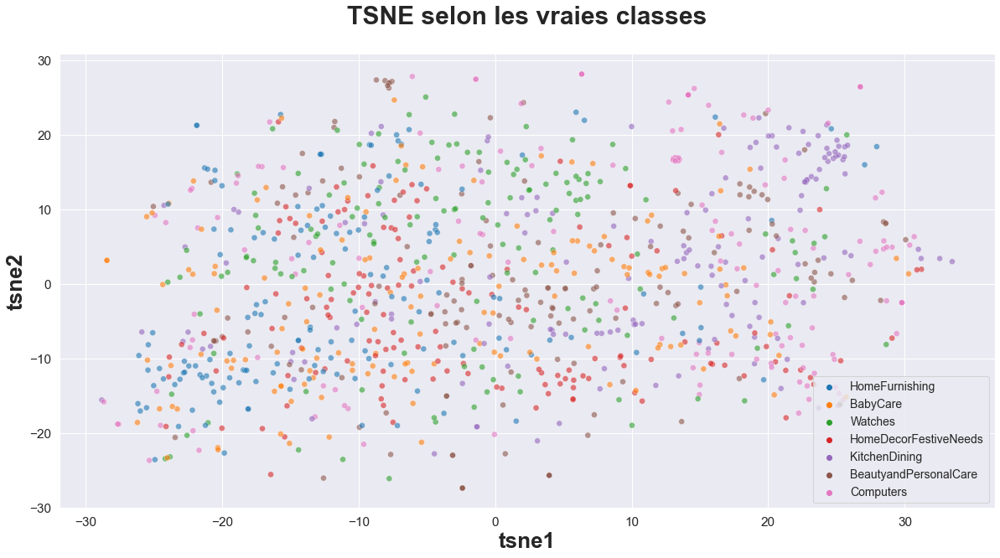

In [155]:
plt.figure(figsize=(20, 10))
sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6)

plt.title('TSNE selon les vraies classes',
          fontsize=30, pad=35, fontweight='bold')
plt.xlabel('tsne1', fontsize=26, fontweight='bold')
plt.ylabel('tsne2', fontsize=26, fontweight='bold')
plt.legend(prop={'size': 14})

plt.show()

### Visualisation tsne avec les images

In [67]:
def plot_embedding(X, title=None):
    x_min, x_max = np.min(X, 0), np.max(X, 0)
    X = (X - x_min) / (x_max - x_min)

    fig, ax = plt.subplots(figsize=(20, 20))
    plt.ylim([0.5, 1])
    ax.set_axis_off()

    if hasattr(offsetbox, 'AnnotationBbox'):
        shown_images = np.array([[1., 1.]])
        for i in range(feat_pca_sift.shape[0]):
            dist = np.sum((X[i] - shown_images) ** 2, 1)
            if np.min(dist) < 2e-3:
                continue
            shown_images = np.r_[shown_images, [X[i]]]
            props = {'boxstyle': 'round', 'edgecolor': 'white'}
            imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(
                Images[i], cmap=plt.cm.gray, zoom=0.05), X[i], bboxprops=props)
            ax.add_artist(imagebox)
    if title is not None:
        plt.title(title)
    fig.savefig("tsne image.pdf")

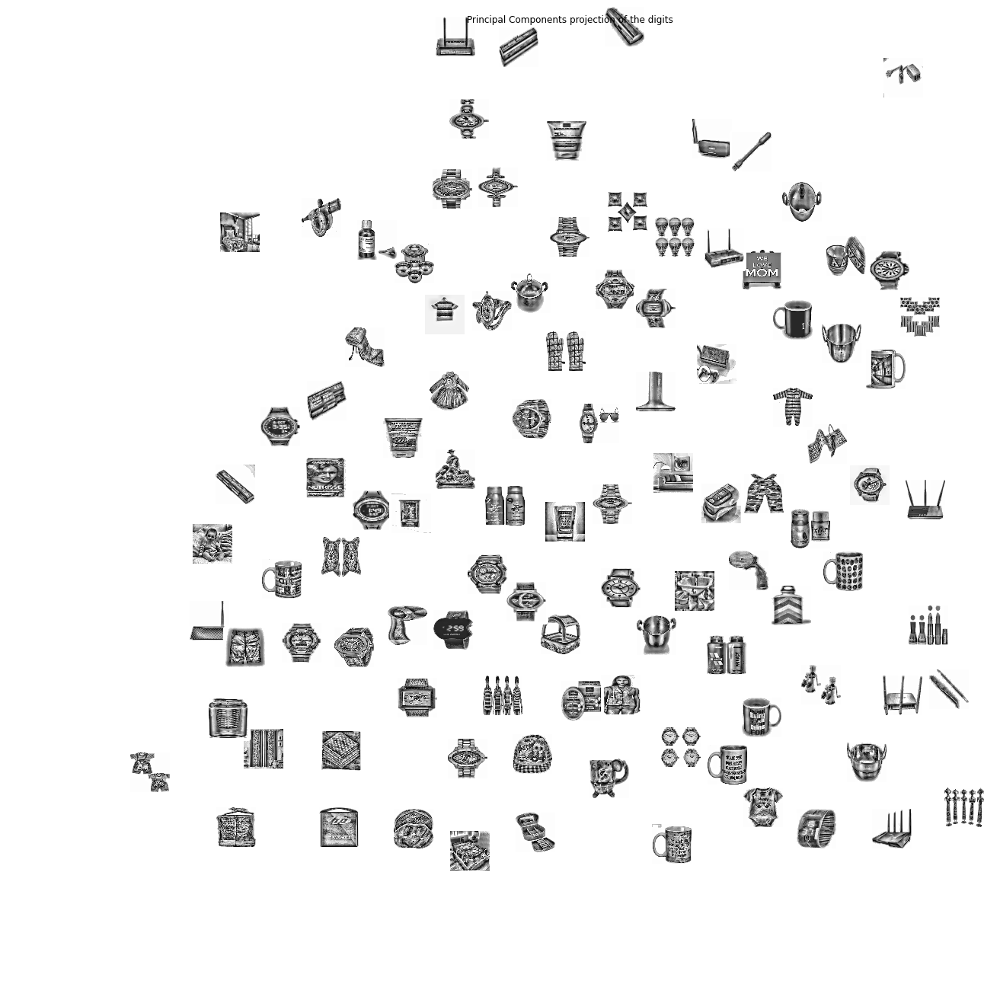

In [68]:
plot_embedding(X_tsne_sift, "Principal Components projection of the digits")
plt.show()

# Analyse mesures : similarité entre catégories et clusters
 ## Création de clusters à partir du T-SNE

In [69]:
df_sift = data_pic.copy()

In [70]:
from sklearn import cluster, metrics

cls = cluster.KMeans(n_clusters=7, random_state=6)
cls.fit(feat_pca_sift)

df_sift["cluster"] = cls.labels_
print(df_sift.shape)

(1050, 4)


In [71]:
from sklearn.metrics import davies_bouldin_score
from sklearn import metrics
from sklearn.metrics import adjusted_rand_score

labels = data_pic["categories"]
ARI = adjusted_rand_score(labels, cls.labels_)
silhouette = metrics.silhouette_score(feat_pca_sift, cls.labels_)
db_score = davies_bouldin_score(feat_pca_sift, cls.labels_)
print(f"DB score = {db_score} --- silhouette = {silhouette} ---- ARI = {ARI}")

DB score = 1.8060265838124994 --- silhouette = 0.1215076027645321 ---- ARI = 0.04760150453157664


 silhouette Ce score est compris entre -1 et 1, où plus le score est élevé, plus vos clusters sont bien définis et distincts

db score Contrairement aux deux métriques précédentes, ce score mesure la similarité de vos clusters, ce qui signifie que plus le score est bas, meilleure est la séparation entre vos clusters.

In [72]:
from sklearn import cluster, metrics

cls = cluster.KMeans(n_clusters=7, random_state=6)
cls.fit(X_tsne_sift)

df_sift["cluster"] = cls.labels_
print(df_sift.shape)

(1050, 4)


In [73]:
from sklearn.metrics import davies_bouldin_score
from sklearn import metrics
from sklearn.metrics import adjusted_rand_score

labels = data_pic["categories"]
ARI = adjusted_rand_score(labels, cls.labels_)
silhouette = metrics.silhouette_score(X_tsne_sift, cls.labels_)
db_score = davies_bouldin_score(X_tsne_sift, cls.labels_)
print(f"DB score = {db_score} --- silhouette = {silhouette} ---- ARI = {ARI}")

DB score = 0.8444197814437392 --- silhouette = 0.36999842524528503 ---- ARI = 0.0609546723670516


## Affichage des erreures du modèle : confusion matrix

In [74]:
label_sift = pd.concat(
    [df_sift["cluster"], data_pic['label_categories'], data_pic["categories"]], axis=1)

In [75]:
from sklearn.metrics import confusion_matrix
conf_mat = confusion_matrix(
    label_sift["cluster"], label_sift['label_categories'])

In [76]:
table_label_sift = pd.pivot_table(label_sift, values='label_categories', index=['categories'],
                                  columns=['cluster'], aggfunc=lambda x: len(x), fill_value=0)

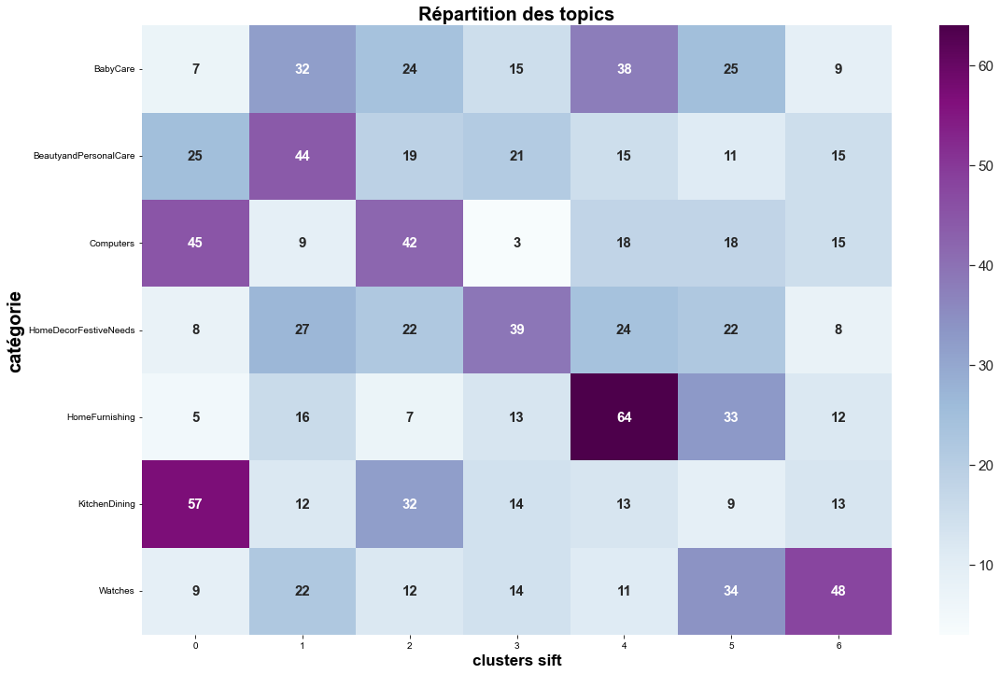

In [77]:
plt.figure(figsize=(18, 12))
plt.title('Répartition des topics', size=20, weight='bold')
sns.set(font_scale=1.4)
sns.heatmap(table_label_sift, annot=True,
            cmap='BuPu',
            annot_kws={"size": 15, 'weight': 'bold'},
            fmt='g')

plt.ylabel("catégorie", weight='bold', size=20)
plt.xlabel('clusters sift', weight='bold', size=17)
plt.show()

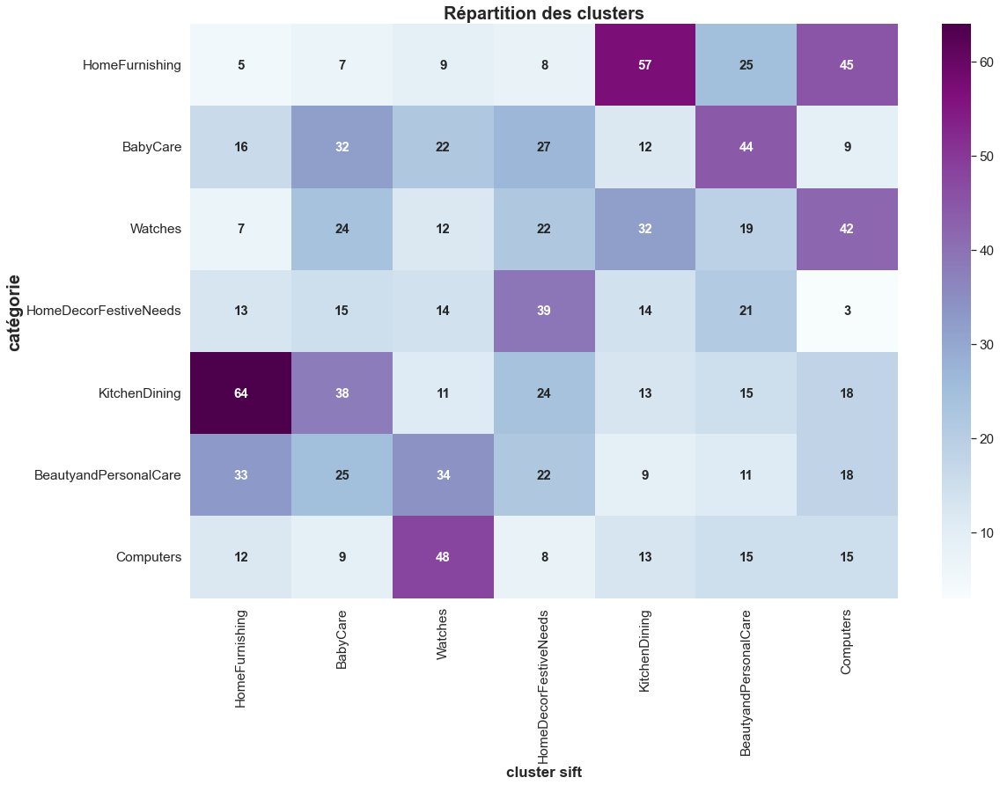

In [79]:
list_labels = ['HomeFurnishing', 'BabyCare', 'Watches', 'HomeDecorFestiveNeeds',
               'KitchenDining', 'BeautyandPersonalCare', 'Computers']
df_cm = pd.DataFrame(conf_mat, index=[label for label in list_labels],
                     columns=[label for label in list_labels])
plt.figure(figsize=(18, 12))
plt.title('Répartition des clusters', size=20, weight='bold')
sns.set(font_scale=1.4)
sns.heatmap(df_cm, annot=True, cmap='BuPu',
            annot_kws={"size": 15, 'weight': 'bold'},
            fmt='g')

plt.ylabel("catégorie", weight='bold', size=20)
plt.xlabel('cluster sift', weight='bold', size=17)
plt.show()

###  Nombre d'erreurs réel

In [80]:
# Nombre d'erreur
mask = label_sift['label_categories'] == label_sift['cluster']
df_erreur_sift = label_sift[~mask]
display(f'Nombre d\'erreurs : {df_erreur_sift.shape[0]} sur 1050')

"Nombre d'erreurs : 923 sur 1050"

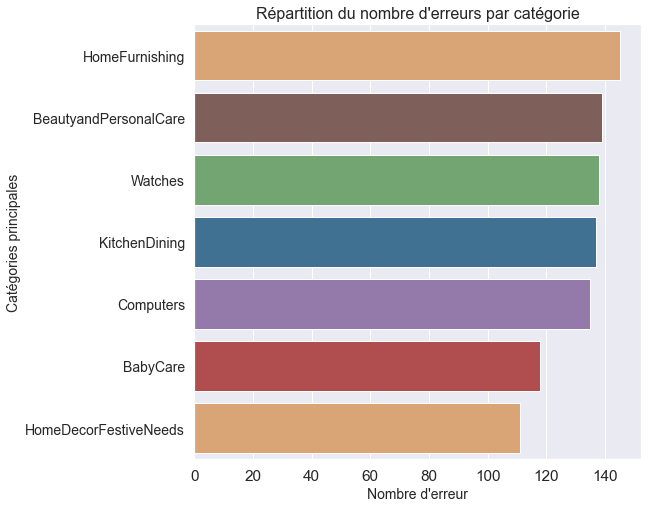

In [81]:
# Répartition des erreurs par catégori
plt.figure(figsize=(8, 8))
sns.countplot(y='categories', data=df_erreur_sift, orient='h',
              order=df_erreur_sift['categories'].value_counts().index,
              palette=['#e9a467', '#845b53', '#6bad6b', '#3274a1',
                       '#9372b2', '#c03d3e'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=16)
plt.xlabel('Nombre d\'erreur', fontsize=14)
plt.ylabel('Catégories principales', fontsize=14)
plt.yticks(fontsize=14)
plt.show()

# Plan de notre modélisation par ORB

    1) Implémentation de ORB à toutes nos photos
    2) Création des clusters par MiniBatchKmeans
    3) Création des histogrammes pour le bag of visual Words
    4) Réduction de dimension par PCA
    5) Réduction de dimension pour la visualisation par Tsne
    6) Analyse de la modélisation :
   + ARI Score
   + Confusion Matrix (nombre d'érreur dans le modèle) 

## 1) Implémentation de ORB à toutes nos photos

In [82]:
images = df.image.sort_values().unique()


descriptor_list_orb = []


for index, leaf in df['image'].iteritems():
    img = cv.imread(os.path.join(path, leaf))
    orb = cv.ORB_create()
    kp, des = orb.detectAndCompute(img, None)

    for d in des:
        descriptor_list_orb.append(d)

## 2) Création des clusters par MiniBatchKmeans

In [83]:
n_centers = 1000


batch_size = np.size(os.listdir(path)) * 3
model_orb = MiniBatchKMeans(
    n_clusters=n_centers, batch_size=batch_size, verbose=1)
model_kmeans_orb = model_orb.fit(descriptor_list_orb)
visual_words_orb = model_kmeans_orb.cluster_centers_

labels_orb = model_orb.fit_predict(descriptor_list_orb)
model_kmeans_orb.labels_.shape

Init 1/3 with method: k-means++
Inertia for init 1/3: 715644656.072347
Init 2/3 with method: k-means++
Inertia for init 2/3: 712997341.733044
Init 3/3 with method: k-means++
Inertia for init 3/3: 716333118.184906
Minibatch iteration 1/16600: mean batch inertia: 87867.722989, ewa inertia: 87867.722989 
Minibatch iteration 2/16600: mean batch inertia: 86207.902129, ewa inertia: 87847.689091 
Minibatch iteration 3/16600: mean batch inertia: 87243.226515, ewa inertia: 87840.393279 
Minibatch iteration 4/16600: mean batch inertia: 85496.779428, ewa inertia: 87812.106056 
Minibatch iteration 5/16600: mean batch inertia: 84121.274702, ewa inertia: 87767.558032 
Minibatch iteration 6/16600: mean batch inertia: 84972.541683, ewa inertia: 87733.822420 
Minibatch iteration 7/16600: mean batch inertia: 83983.572612, ewa inertia: 87688.557220 
Minibatch iteration 8/16600: mean batch inertia: 84213.397890, ewa inertia: 87646.612339 
Minibatch iteration 9/16600: mean batch inertia: 84252.474746, ewa 

Minibatch iteration 89/16600: mean batch inertia: 81031.808836, ewa inertia: 83992.374984 
Minibatch iteration 90/16600: mean batch inertia: 80795.199404, ewa inertia: 83953.785343 
Minibatch iteration 91/16600: mean batch inertia: 80717.616620, ewa inertia: 83914.725059 
Minibatch iteration 92/16600: mean batch inertia: 81657.110873, ewa inertia: 83887.475845 
Minibatch iteration 93/16600: mean batch inertia: 80710.396276, ewa inertia: 83849.128762 
Minibatch iteration 94/16600: mean batch inertia: 80964.637637, ewa inertia: 83814.313197 
Minibatch iteration 95/16600: mean batch inertia: 80606.793897, ewa inertia: 83775.598708 
Minibatch iteration 96/16600: mean batch inertia: 80659.566799, ewa inertia: 83737.988465 
Minibatch iteration 97/16600: mean batch inertia: 80827.068075, ewa inertia: 83702.853901 
Minibatch iteration 98/16600: mean batch inertia: 81060.521885, ewa inertia: 83670.961176 
Minibatch iteration 99/16600: mean batch inertia: 81715.650222, ewa inertia: 83647.360737 

Minibatch iteration 181/16600: mean batch inertia: 81245.557298, ewa inertia: 81850.642938 
Minibatch iteration 182/16600: mean batch inertia: 81110.819433, ewa inertia: 81841.713331 
Minibatch iteration 183/16600: mean batch inertia: 81179.634385, ewa inertia: 81833.722094 
Minibatch iteration 184/16600: mean batch inertia: 80566.662961, ewa inertia: 81818.428796 
Minibatch iteration 185/16600: mean batch inertia: 80545.794655, ewa inertia: 81803.068209 
Minibatch iteration 186/16600: mean batch inertia: 80836.086279, ewa inertia: 81791.396819 
Minibatch iteration 187/16600: mean batch inertia: 81729.465610, ewa inertia: 81790.649314 
Minibatch iteration 188/16600: mean batch inertia: 80643.914028, ewa inertia: 81776.808316 
Minibatch iteration 189/16600: mean batch inertia: 81377.722876, ewa inertia: 81771.991388 
Minibatch iteration 190/16600: mean batch inertia: 80778.185297, ewa inertia: 81759.996232 
Minibatch iteration 191/16600: mean batch inertia: 80493.186169, ewa inertia: 81

Minibatch iteration 271/16600: mean batch inertia: 80617.147408, ewa inertia: 81089.712859 
Minibatch iteration 272/16600: mean batch inertia: 80716.150350, ewa inertia: 81085.203991 
Minibatch iteration 273/16600: mean batch inertia: 80996.253503, ewa inertia: 81084.130366 
Minibatch iteration 274/16600: mean batch inertia: 79675.025702, ewa inertia: 81067.122592 
Minibatch iteration 275/16600: mean batch inertia: 79709.755747, ewa inertia: 81050.739288 
Minibatch iteration 276/16600: mean batch inertia: 80491.126342, ewa inertia: 81043.984807 
Minibatch iteration 277/16600: mean batch inertia: 81025.419597, ewa inertia: 81043.760726 
Minibatch iteration 278/16600: mean batch inertia: 80515.779329, ewa inertia: 81037.388035 
Minibatch iteration 279/16600: mean batch inertia: 79885.832761, ewa inertia: 81023.488860 
Minibatch iteration 280/16600: mean batch inertia: 80857.974555, ewa inertia: 81021.491116 
Minibatch iteration 281/16600: mean batch inertia: 80762.819922, ewa inertia: 81

Minibatch iteration 361/16600: mean batch inertia: 80796.448506, ewa inertia: 80640.794065 
Minibatch iteration 362/16600: mean batch inertia: 81010.177346, ewa inertia: 80645.252490 
Minibatch iteration 363/16600: mean batch inertia: 80442.205216, ewa inertia: 80642.801726 
Minibatch iteration 364/16600: mean batch inertia: 80211.547617, ewa inertia: 80637.596525 
Minibatch iteration 365/16600: mean batch inertia: 79846.901217, ewa inertia: 80628.052899 
Minibatch iteration 366/16600: mean batch inertia: 80783.452580, ewa inertia: 80629.928561 
Minibatch iteration 367/16600: mean batch inertia: 81152.558220, ewa inertia: 80636.236657 
Minibatch iteration 368/16600: mean batch inertia: 80703.221370, ewa inertia: 80637.045156 
Minibatch iteration 369/16600: mean batch inertia: 80299.518028, ewa inertia: 80632.971232 
Minibatch iteration 370/16600: mean batch inertia: 80532.734864, ewa inertia: 80631.761388 
Minibatch iteration 371/16600: mean batch inertia: 80716.773337, ewa inertia: 80

Minibatch iteration 39/16600: mean batch inertia: 81469.689442, ewa inertia: 85764.919599 
Minibatch iteration 40/16600: mean batch inertia: 81714.109860, ewa inertia: 85716.026666 
Minibatch iteration 41/16600: mean batch inertia: 81403.704200, ewa inertia: 85663.977297 
[MiniBatchKMeans] Reassigning 2 cluster centers.
Minibatch iteration 42/16600: mean batch inertia: 81862.141847, ewa inertia: 85618.089462 
Minibatch iteration 43/16600: mean batch inertia: 82127.176104, ewa inertia: 85575.954432 
Minibatch iteration 44/16600: mean batch inertia: 81255.229488, ewa inertia: 85523.803645 
Minibatch iteration 45/16600: mean batch inertia: 82129.402580, ewa inertia: 85482.833509 
Minibatch iteration 46/16600: mean batch inertia: 81916.391056, ewa inertia: 85439.786849 
Minibatch iteration 47/16600: mean batch inertia: 82134.000067, ewa inertia: 85399.886280 
Minibatch iteration 48/16600: mean batch inertia: 81747.890066, ewa inertia: 85355.806993 
Minibatch iteration 49/16600: mean batch 

Minibatch iteration 129/16600: mean batch inertia: 80456.687663, ewa inertia: 82745.927259 
Minibatch iteration 130/16600: mean batch inertia: 81328.621711, ewa inertia: 82728.820500 
Minibatch iteration 131/16600: mean batch inertia: 81276.196231, ewa inertia: 82711.287447 
Minibatch iteration 132/16600: mean batch inertia: 81117.153968, ewa inertia: 82692.046390 
Minibatch iteration 133/16600: mean batch inertia: 80926.154189, ewa inertia: 82670.732220 
Minibatch iteration 134/16600: mean batch inertia: 81361.609150, ewa inertia: 82654.931214 
Minibatch iteration 135/16600: mean batch inertia: 80187.633398, ewa inertia: 82625.151137 
Minibatch iteration 136/16600: mean batch inertia: 81061.264509, ewa inertia: 82606.275157 
Minibatch iteration 137/16600: mean batch inertia: 81252.530490, ewa inertia: 82589.935573 
Minibatch iteration 138/16600: mean batch inertia: 80783.530700, ewa inertia: 82568.132418 
Minibatch iteration 139/16600: mean batch inertia: 80403.577841, ewa inertia: 82

Minibatch iteration 219/16600: mean batch inertia: 81682.827898, ewa inertia: 81391.729032 
Minibatch iteration 220/16600: mean batch inertia: 80554.852309, ewa inertia: 81381.628000 
Minibatch iteration 221/16600: mean batch inertia: 80190.766682, ewa inertia: 81367.254404 
Minibatch iteration 222/16600: mean batch inertia: 81449.314832, ewa inertia: 81368.244866 
Minibatch iteration 223/16600: mean batch inertia: 80691.372720, ewa inertia: 81360.075077 
Minibatch iteration 224/16600: mean batch inertia: 80632.259434, ewa inertia: 81351.290403 
Minibatch iteration 225/16600: mean batch inertia: 80621.905363, ewa inertia: 81342.486787 
Minibatch iteration 226/16600: mean batch inertia: 80600.171177, ewa inertia: 81333.527100 
Minibatch iteration 227/16600: mean batch inertia: 80437.303123, ewa inertia: 81322.709752 
Minibatch iteration 228/16600: mean batch inertia: 80708.077495, ewa inertia: 81315.291192 
Minibatch iteration 229/16600: mean batch inertia: 80165.579647, ewa inertia: 81

Minibatch iteration 309/16600: mean batch inertia: 80026.380990, ewa inertia: 80871.332404 
Minibatch iteration 310/16600: mean batch inertia: 80239.762254, ewa inertia: 80863.709405 
Minibatch iteration 311/16600: mean batch inertia: 80511.622321, ewa inertia: 80859.459743 
Minibatch iteration 312/16600: mean batch inertia: 80387.785909, ewa inertia: 80853.766680 
Minibatch iteration 313/16600: mean batch inertia: 80832.895679, ewa inertia: 80853.514769 
Minibatch iteration 314/16600: mean batch inertia: 80617.475792, ewa inertia: 80850.665798 
Minibatch iteration 315/16600: mean batch inertia: 79797.640799, ewa inertia: 80837.955875 
Minibatch iteration 316/16600: mean batch inertia: 80894.545410, ewa inertia: 80838.638906 
Minibatch iteration 317/16600: mean batch inertia: 80242.285697, ewa inertia: 80831.440973 
Minibatch iteration 318/16600: mean batch inertia: 80097.670028, ewa inertia: 80822.584419 
Minibatch iteration 319/16600: mean batch inertia: 80594.185587, ewa inertia: 80

(522455,)

## 3) Création des histogrammes pour le bag of visual Words

In [84]:
temps = time.time()
model_orb.verbose = False

histo_list_orb = []

for count, leaf in enumerate(df['image']):
    print(f'image processing number {count+1}/{df["image"].shape[0]}')
    img = cv.imread(os.path.join(path, leaf))
    kp, des = orb.detectAndCompute(img, None)
    histo_orb = np.zeros(n_centers)
    nkp = np.size(kp)

    for d in des:
        idx = model_orb.predict([d])
        # Because we need normalized histograms, I prefere to add 1/nkp directly
        histo_orb[idx] += 1/nkp

    histo_list_orb.append(histo_orb)

duration = time.time()-temps
print("temps de création histogrammes : ", "%15.2f" % duration, "secondes")

image processing number 1/1050
image processing number 2/1050
image processing number 3/1050
image processing number 4/1050
image processing number 5/1050
image processing number 6/1050
image processing number 7/1050
image processing number 8/1050
image processing number 9/1050
image processing number 10/1050
image processing number 11/1050
image processing number 12/1050
image processing number 13/1050
image processing number 14/1050
image processing number 15/1050
image processing number 16/1050
image processing number 17/1050
image processing number 18/1050
image processing number 19/1050
image processing number 20/1050
image processing number 21/1050
image processing number 22/1050
image processing number 23/1050
image processing number 24/1050
image processing number 25/1050
image processing number 26/1050
image processing number 27/1050
image processing number 28/1050
image processing number 29/1050
image processing number 30/1050
image processing number 31/1050
image processing 

image processing number 253/1050
image processing number 254/1050
image processing number 255/1050
image processing number 256/1050
image processing number 257/1050
image processing number 258/1050
image processing number 259/1050
image processing number 260/1050
image processing number 261/1050
image processing number 262/1050
image processing number 263/1050
image processing number 264/1050
image processing number 265/1050
image processing number 266/1050
image processing number 267/1050
image processing number 268/1050
image processing number 269/1050
image processing number 270/1050
image processing number 271/1050
image processing number 272/1050
image processing number 273/1050
image processing number 274/1050
image processing number 275/1050
image processing number 276/1050
image processing number 277/1050
image processing number 278/1050
image processing number 279/1050
image processing number 280/1050
image processing number 281/1050
image processing number 282/1050
image proc

image processing number 502/1050
image processing number 503/1050
image processing number 504/1050
image processing number 505/1050
image processing number 506/1050
image processing number 507/1050
image processing number 508/1050
image processing number 509/1050
image processing number 510/1050
image processing number 511/1050
image processing number 512/1050
image processing number 513/1050
image processing number 514/1050
image processing number 515/1050
image processing number 516/1050
image processing number 517/1050
image processing number 518/1050
image processing number 519/1050
image processing number 520/1050
image processing number 521/1050
image processing number 522/1050
image processing number 523/1050
image processing number 524/1050
image processing number 525/1050
image processing number 526/1050
image processing number 527/1050
image processing number 528/1050
image processing number 529/1050
image processing number 530/1050
image processing number 531/1050
image proc

image processing number 751/1050
image processing number 752/1050
image processing number 753/1050
image processing number 754/1050
image processing number 755/1050
image processing number 756/1050
image processing number 757/1050
image processing number 758/1050
image processing number 759/1050
image processing number 760/1050
image processing number 761/1050
image processing number 762/1050
image processing number 763/1050
image processing number 764/1050
image processing number 765/1050
image processing number 766/1050
image processing number 767/1050
image processing number 768/1050
image processing number 769/1050
image processing number 770/1050
image processing number 771/1050
image processing number 772/1050
image processing number 773/1050
image processing number 774/1050
image processing number 775/1050
image processing number 776/1050
image processing number 777/1050
image processing number 778/1050
image processing number 779/1050
image processing number 780/1050
image proc

image processing number 1000/1050
image processing number 1001/1050
image processing number 1002/1050
image processing number 1003/1050
image processing number 1004/1050
image processing number 1005/1050
image processing number 1006/1050
image processing number 1007/1050
image processing number 1008/1050
image processing number 1009/1050
image processing number 1010/1050
image processing number 1011/1050
image processing number 1012/1050
image processing number 1013/1050
image processing number 1014/1050
image processing number 1015/1050
image processing number 1016/1050
image processing number 1017/1050
image processing number 1018/1050
image processing number 1019/1050
image processing number 1020/1050
image processing number 1021/1050
image processing number 1022/1050
image processing number 1023/1050
image processing number 1024/1050
image processing number 1025/1050
image processing number 1026/1050
image processing number 1027/1050
image processing number 1028/1050
image processi

In [85]:
temps1 = time.time()
im_features_orb = np.asarray(histo_list_orb)
print(f'Dimensions of the histogram matrix: {im_features_orb.shape}')

duration1 = time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")

Dimensions of the histogram matrix: (1050, 1000)
temps de création histogrammes :             0.01 secondes


## 4) Réduction de dimension par PCA

(1050, 426)



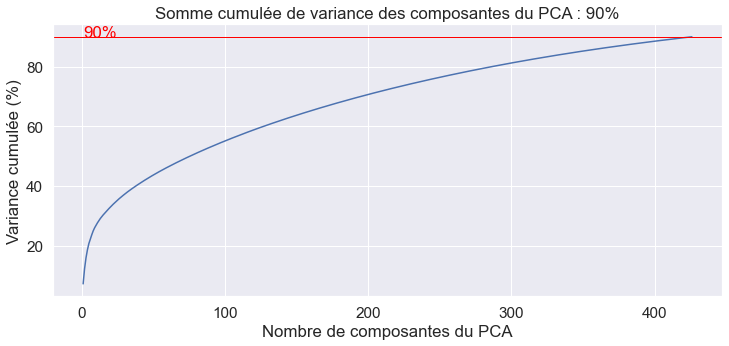

In [86]:
pca_orb, feat_pca_orb = pca_function(im_features_orb)
pca_graph(pca_orb)

In [87]:
print("Dimensions dataset avant réduction PCA : ", im_features_orb.shape)
pca = decomposition.PCA(n_components=0.90)
feat_pca_orb = pca.fit_transform(im_features_orb)
print("Dimensions dataset après réduction PCA : ", feat_pca_orb.shape)

Dimensions dataset avant réduction PCA :  (1050, 1000)
Dimensions dataset après réduction PCA :  (1050, 426)


## 5) Réduction de dimension pour la visualisation par Tsne

In [88]:
tsne = manifold.TSNE(n_components=2, perplexity=30,
                     random_state=6)
X_tsne_orb = tsne.fit_transform(feat_pca_orb)

df_tsne_orb = pd.DataFrame(X_tsne_orb[:, 0:2], columns=['tsne1', 'tsne2'])
df_tsne_orb["class"] = data_pic["categories"]
print(df_tsne_orb.shape)

(1050, 3)


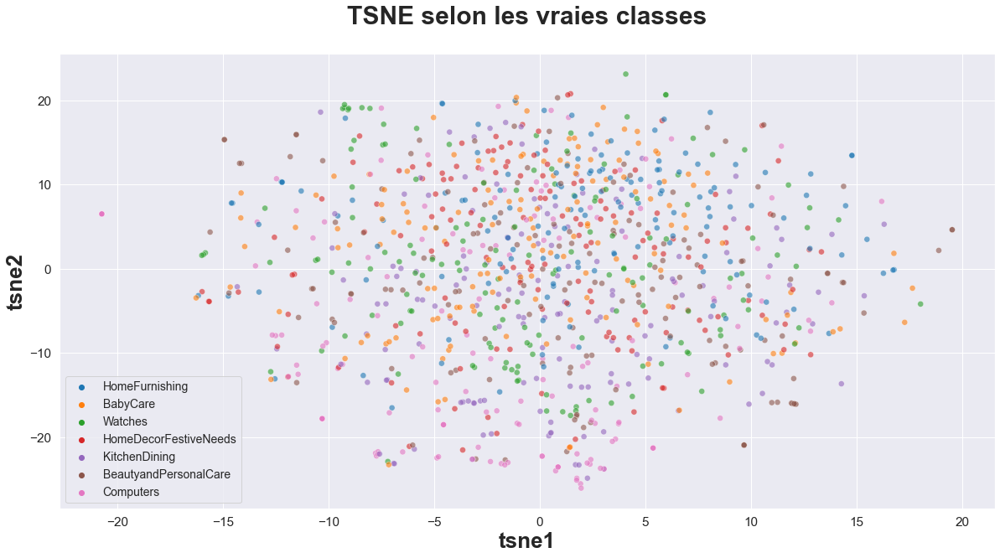

In [89]:
plt.figure(figsize=(20, 10))
sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne_orb, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6)

plt.title('TSNE selon les vraies classes',
          fontsize=30, pad=35, fontweight='bold')
plt.xlabel('tsne1', fontsize=26, fontweight='bold')
plt.ylabel('tsne2', fontsize=26, fontweight='bold')
plt.legend(prop={'size': 14})

plt.show()

## 6) Analyse de la modélisation 

In [90]:
df_orb = data_pic.copy()

In [91]:
from sklearn import cluster, metrics
cls.fit(feat_pca_orb)

df_orb["cluster"] = cls.labels_
print(df_orb.shape)

(1050, 4)


### ARI score

In [92]:
labels_orb = data_pic["categories"]

ARI_orb = adjusted_rand_score(labels_orb, df_orb["cluster"])
silhouette_orb = metrics.silhouette_score(feat_pca_orb, df_orb["cluster"])
db_score_orb = davies_bouldin_score(feat_pca_orb, df_orb["cluster"])
print(
    f"DB score = {db_score_orb} --- silhouette = {silhouette_orb} ---- ARI = {ARI_orb}")

DB score = 3.3326597484604314 --- silhouette = 0.004516670298030402 ---- ARI = 0.01616822264239859


#### Score pour réduction de dimension tsne 

In [156]:
cls.fit(X_tsne_orb)

df_orb["cluster"] = cls.labels_
print(df_orb.shape)

(1050, 4)


In [157]:
labels = data_pic["categories"]
ARI = adjusted_rand_score(labels, cls.labels_)
silhouette = metrics.silhouette_score(X_tsne_orb, cls.labels_)
db_score = davies_bouldin_score(X_tsne_orb, cls.labels_)
print(f"DB score = {db_score} --- silhouette = {silhouette} ---- ARI = {ARI}")

DB score = 0.827304273940273 --- silhouette = 0.35300710797309875 ---- ARI = 0.028436721226796826


### Confusion Matrix (nombre d'érreur dans le modèle)

In [93]:
label_orb = pd.concat(
    [df_orb["cluster"], data_pic['label_categories'], data_pic["categories"]], axis=1)

In [94]:
conf_mat_orb = confusion_matrix(
    label_orb["cluster"], label_orb['label_categories'])

In [95]:
table_label_orb = pd.pivot_table(label_orb, values='label_categories', index=['categories'],
                                 columns=['cluster'], aggfunc=lambda x: len(x), fill_value=0)

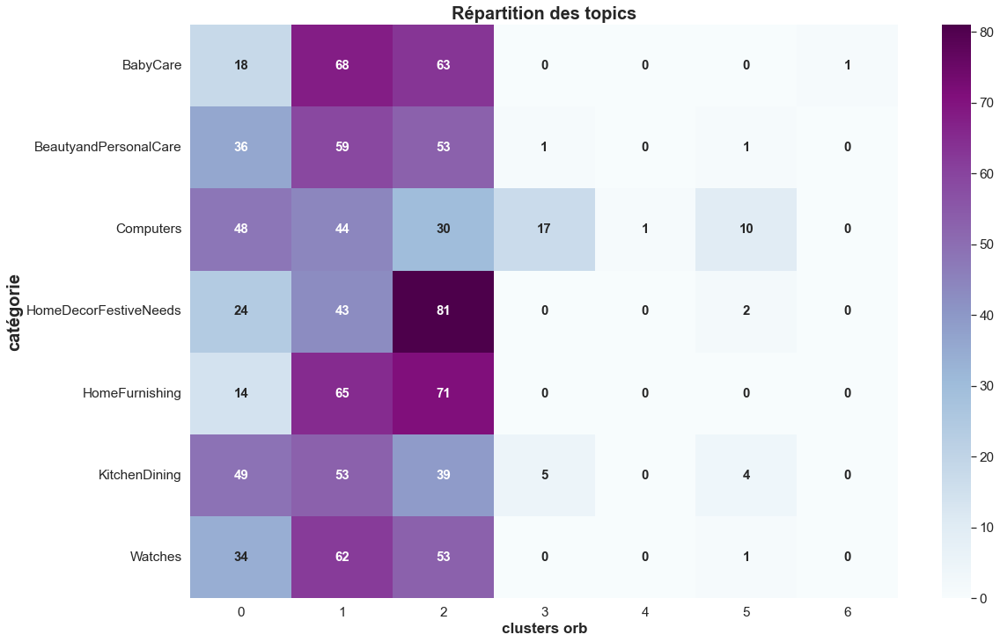

In [96]:
plt.figure(figsize=(18, 12))
plt.title('Répartition des topics', size=20, weight='bold')
sns.set(font_scale=1.4)
sns.heatmap(table_label_orb, annot=True,
            cmap='BuPu',
            annot_kws={"size": 15, 'weight': 'bold'},
            fmt='g')

plt.ylabel("catégorie", weight='bold', size=20)
plt.xlabel('clusters orb', weight='bold', size=17)
plt.show()

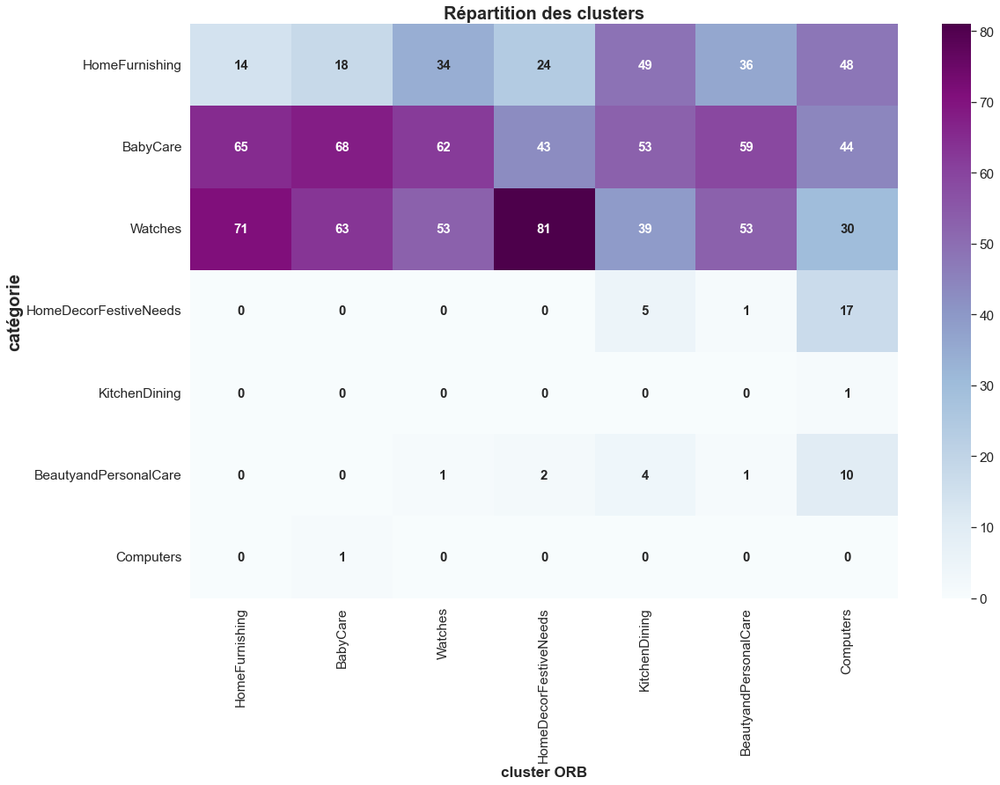

In [97]:
list_labels = ['HomeFurnishing', 'BabyCare', 'Watches', 'HomeDecorFestiveNeeds',
               'KitchenDining', 'BeautyandPersonalCare', 'Computers']
df_cm_orb = pd.DataFrame(conf_mat_orb, index=[label for label in list_labels],
                         columns=[label for label in list_labels])
plt.figure(figsize=(18, 12))
plt.title('Répartition des clusters', size=20, weight='bold')
sns.set(font_scale=1.4)
sns.heatmap(df_cm_orb, annot=True, cmap='BuPu',
            annot_kws={"size": 15, 'weight': 'bold'},
            fmt='g')

plt.ylabel("catégorie", weight='bold', size=20)
plt.xlabel('cluster ORB', weight='bold', size=17)
plt.show()

Notion de correspondance de labels  clustering pas classification paq montrer pp 

In [98]:
# Nombre d'erreur
mask_orb = label_orb['label_categories'] == label_orb['cluster']
df_erreur_orb = label_orb[~mask_orb]
display(f'Nombre d\'erreurs : {df_erreur_orb.shape[0]}')

"Nombre d'erreurs : 914"

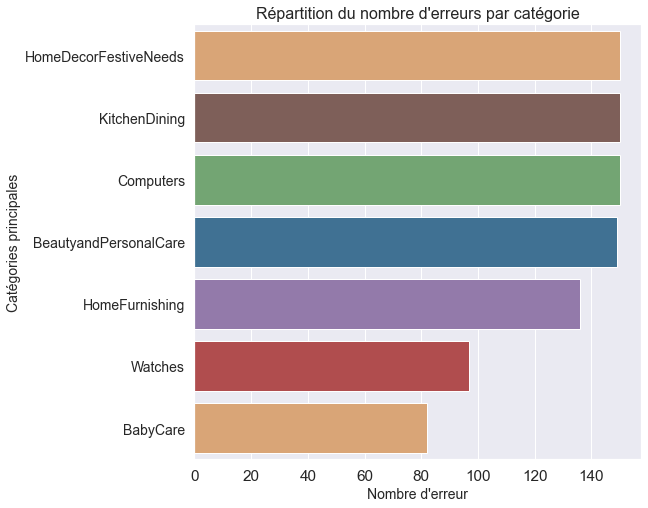

In [99]:
# Répartition des erreurs par catégori
plt.figure(figsize=(8, 8))
sns.countplot(y='categories', data=df_erreur_orb, orient='h',
              order=df_erreur_orb['categories'].value_counts().index,
              palette=['#e9a467', '#845b53', '#6bad6b', '#3274a1',
                       '#9372b2', '#c03d3e'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=16)
plt.xlabel('Nombre d\'erreur', fontsize=14)
plt.ylabel('Catégories principales', fontsize=14)
plt.yticks(fontsize=14)
plt.show()

# Plan de notre modélisation par Surf

    1) Implémentation de surf à toutes nos photos
    2) Création des clusters par MiniBatchKmeans
    3) Création des histogrammes pour le bag of visual Words
    4) Réduction de dimension par PCA
    5) Réduction de dimension pour la visualisation par Tsne
    6) Analyse de la modélisation :
   + ARI Score
   + Confusion Matrix (nombre d'érreur dans le modèle) 

## 1) Implémentation de surf à toutes nos photos

In [100]:
images = df.image.sort_values().unique()

descriptor_list_surf = []


for index, leaf in df['image'].iteritems():
    img = cv.imread(os.path.join(path, leaf))
    surf = cv.xfeatures2d.SURF_create()
    kp, des = surf.detectAndCompute(img, None)

    for d in des:
        descriptor_list_surf.append(d)

## 2) Création des clusters par MiniBatchKmeans

In [101]:
n_centers = 1000

batch_size = np.size(os.listdir(path)) * 3
model_surf = MiniBatchKMeans(
    n_clusters=n_centers, batch_size=batch_size, verbose=1)
model_kmeans = model_surf.fit(descriptor_list_surf)
visual_words = model_kmeans.cluster_centers_

labels = model_surf.fit_predict(descriptor_list_surf)
model_kmeans.labels_.shape

Init 1/3 with method: k-means++
Inertia for init 1/3: 593.320444
Init 2/3 with method: k-means++
Inertia for init 2/3: 591.308425
Init 3/3 with method: k-means++
Inertia for init 3/3: 590.113341
Minibatch iteration 1/181100: mean batch inertia: 0.075673, ewa inertia: 0.075673 
Minibatch iteration 2/181100: mean batch inertia: 0.073963, ewa inertia: 0.075671 
Minibatch iteration 3/181100: mean batch inertia: 0.071954, ewa inertia: 0.075667 
Minibatch iteration 4/181100: mean batch inertia: 0.072669, ewa inertia: 0.075664 
Minibatch iteration 5/181100: mean batch inertia: 0.073981, ewa inertia: 0.075662 
Minibatch iteration 6/181100: mean batch inertia: 0.071813, ewa inertia: 0.075658 
Minibatch iteration 7/181100: mean batch inertia: 0.071554, ewa inertia: 0.075653 
Minibatch iteration 8/181100: mean batch inertia: 0.070471, ewa inertia: 0.075647 
Minibatch iteration 9/181100: mean batch inertia: 0.071484, ewa inertia: 0.075643 
[MiniBatchKMeans] Reassigning 87 cluster centers.
Minibatc

Minibatch iteration 95/181100: mean batch inertia: 0.067554, ewa inertia: 0.074987 
Minibatch iteration 96/181100: mean batch inertia: 0.066649, ewa inertia: 0.074978 
Minibatch iteration 97/181100: mean batch inertia: 0.068518, ewa inertia: 0.074971 
Minibatch iteration 98/181100: mean batch inertia: 0.067044, ewa inertia: 0.074962 
Minibatch iteration 99/181100: mean batch inertia: 0.067828, ewa inertia: 0.074954 
Minibatch iteration 100/181100: mean batch inertia: 0.068800, ewa inertia: 0.074947 
Minibatch iteration 101/181100: mean batch inertia: 0.066427, ewa inertia: 0.074938 
Minibatch iteration 102/181100: mean batch inertia: 0.067272, ewa inertia: 0.074930 
Minibatch iteration 103/181100: mean batch inertia: 0.066878, ewa inertia: 0.074921 
Minibatch iteration 104/181100: mean batch inertia: 0.067998, ewa inertia: 0.074913 
Minibatch iteration 105/181100: mean batch inertia: 0.067444, ewa inertia: 0.074905 
Minibatch iteration 106/181100: mean batch inertia: 0.067540, ewa iner

Minibatch iteration 193/181100: mean batch inertia: 0.066719, ewa inertia: 0.074218 
Minibatch iteration 194/181100: mean batch inertia: 0.066778, ewa inertia: 0.074210 
Minibatch iteration 195/181100: mean batch inertia: 0.067853, ewa inertia: 0.074203 
Minibatch iteration 196/181100: mean batch inertia: 0.066949, ewa inertia: 0.074195 
Minibatch iteration 197/181100: mean batch inertia: 0.067146, ewa inertia: 0.074187 
Minibatch iteration 198/181100: mean batch inertia: 0.067299, ewa inertia: 0.074180 
Minibatch iteration 199/181100: mean batch inertia: 0.067795, ewa inertia: 0.074173 
Minibatch iteration 200/181100: mean batch inertia: 0.066879, ewa inertia: 0.074165 
Minibatch iteration 201/181100: mean batch inertia: 0.067276, ewa inertia: 0.074157 
Minibatch iteration 202/181100: mean batch inertia: 0.065477, ewa inertia: 0.074147 
Minibatch iteration 203/181100: mean batch inertia: 0.067348, ewa inertia: 0.074140 
Minibatch iteration 204/181100: mean batch inertia: 0.067663, ewa

Minibatch iteration 290/181100: mean batch inertia: 0.065990, ewa inertia: 0.073509 
Minibatch iteration 291/181100: mean batch inertia: 0.068064, ewa inertia: 0.073503 
Minibatch iteration 292/181100: mean batch inertia: 0.066156, ewa inertia: 0.073495 
Minibatch iteration 293/181100: mean batch inertia: 0.066380, ewa inertia: 0.073488 
Minibatch iteration 294/181100: mean batch inertia: 0.067165, ewa inertia: 0.073481 
Minibatch iteration 295/181100: mean batch inertia: 0.068043, ewa inertia: 0.073475 
Minibatch iteration 296/181100: mean batch inertia: 0.067372, ewa inertia: 0.073468 
Minibatch iteration 297/181100: mean batch inertia: 0.068464, ewa inertia: 0.073462 
Minibatch iteration 298/181100: mean batch inertia: 0.066476, ewa inertia: 0.073455 
Minibatch iteration 299/181100: mean batch inertia: 0.067560, ewa inertia: 0.073448 
Minibatch iteration 300/181100: mean batch inertia: 0.067054, ewa inertia: 0.073441 
Minibatch iteration 301/181100: mean batch inertia: 0.067201, ewa

Minibatch iteration 389/181100: mean batch inertia: 0.066857, ewa inertia: 0.072849 
Minibatch iteration 390/181100: mean batch inertia: 0.067824, ewa inertia: 0.072843 
Minibatch iteration 391/181100: mean batch inertia: 0.068333, ewa inertia: 0.072838 
Minibatch iteration 392/181100: mean batch inertia: 0.068084, ewa inertia: 0.072833 
Minibatch iteration 393/181100: mean batch inertia: 0.067352, ewa inertia: 0.072827 
Minibatch iteration 394/181100: mean batch inertia: 0.066529, ewa inertia: 0.072820 
Minibatch iteration 395/181100: mean batch inertia: 0.068193, ewa inertia: 0.072815 
Minibatch iteration 396/181100: mean batch inertia: 0.065949, ewa inertia: 0.072807 
Minibatch iteration 397/181100: mean batch inertia: 0.066664, ewa inertia: 0.072801 
Minibatch iteration 398/181100: mean batch inertia: 0.066637, ewa inertia: 0.072794 
Minibatch iteration 399/181100: mean batch inertia: 0.067376, ewa inertia: 0.072788 
Minibatch iteration 400/181100: mean batch inertia: 0.066098, ewa

Minibatch iteration 488/181100: mean batch inertia: 0.067188, ewa inertia: 0.072246 
Minibatch iteration 489/181100: mean batch inertia: 0.066518, ewa inertia: 0.072240 
Minibatch iteration 490/181100: mean batch inertia: 0.066614, ewa inertia: 0.072234 
Minibatch iteration 491/181100: mean batch inertia: 0.066811, ewa inertia: 0.072228 
Minibatch iteration 492/181100: mean batch inertia: 0.068165, ewa inertia: 0.072223 
Minibatch iteration 493/181100: mean batch inertia: 0.067158, ewa inertia: 0.072218 
Minibatch iteration 494/181100: mean batch inertia: 0.066467, ewa inertia: 0.072211 
Minibatch iteration 495/181100: mean batch inertia: 0.067837, ewa inertia: 0.072206 
Minibatch iteration 496/181100: mean batch inertia: 0.067032, ewa inertia: 0.072201 
Minibatch iteration 497/181100: mean batch inertia: 0.067054, ewa inertia: 0.072195 
Minibatch iteration 498/181100: mean batch inertia: 0.067593, ewa inertia: 0.072190 
Minibatch iteration 499/181100: mean batch inertia: 0.066843, ewa

Minibatch iteration 585/181100: mean batch inertia: 0.068456, ewa inertia: 0.071718 
Minibatch iteration 586/181100: mean batch inertia: 0.066512, ewa inertia: 0.071712 
Minibatch iteration 587/181100: mean batch inertia: 0.066989, ewa inertia: 0.071707 
Minibatch iteration 588/181100: mean batch inertia: 0.066291, ewa inertia: 0.071701 
Minibatch iteration 589/181100: mean batch inertia: 0.066421, ewa inertia: 0.071695 
Minibatch iteration 590/181100: mean batch inertia: 0.066538, ewa inertia: 0.071690 
Minibatch iteration 591/181100: mean batch inertia: 0.067411, ewa inertia: 0.071685 
Minibatch iteration 592/181100: mean batch inertia: 0.065398, ewa inertia: 0.071678 
Minibatch iteration 593/181100: mean batch inertia: 0.067769, ewa inertia: 0.071674 
Minibatch iteration 594/181100: mean batch inertia: 0.067321, ewa inertia: 0.071669 
Minibatch iteration 595/181100: mean batch inertia: 0.067811, ewa inertia: 0.071664 
Minibatch iteration 596/181100: mean batch inertia: 0.065971, ewa

Minibatch iteration 684/181100: mean batch inertia: 0.065799, ewa inertia: 0.071204 
Minibatch iteration 685/181100: mean batch inertia: 0.066864, ewa inertia: 0.071199 
Minibatch iteration 686/181100: mean batch inertia: 0.067711, ewa inertia: 0.071195 
Minibatch iteration 687/181100: mean batch inertia: 0.067230, ewa inertia: 0.071191 
Minibatch iteration 688/181100: mean batch inertia: 0.065676, ewa inertia: 0.071185 
Minibatch iteration 689/181100: mean batch inertia: 0.065646, ewa inertia: 0.071179 
Minibatch iteration 690/181100: mean batch inertia: 0.065670, ewa inertia: 0.071173 
Minibatch iteration 691/181100: mean batch inertia: 0.067284, ewa inertia: 0.071169 
Minibatch iteration 692/181100: mean batch inertia: 0.068125, ewa inertia: 0.071165 
Minibatch iteration 693/181100: mean batch inertia: 0.066810, ewa inertia: 0.071160 
Minibatch iteration 694/181100: mean batch inertia: 0.067123, ewa inertia: 0.071156 
Minibatch iteration 695/181100: mean batch inertia: 0.066219, ewa

Minibatch iteration 783/181100: mean batch inertia: 0.066679, ewa inertia: 0.070754 
Minibatch iteration 784/181100: mean batch inertia: 0.066521, ewa inertia: 0.070749 
Minibatch iteration 785/181100: mean batch inertia: 0.067411, ewa inertia: 0.070746 
Minibatch iteration 786/181100: mean batch inertia: 0.066410, ewa inertia: 0.070741 
Minibatch iteration 787/181100: mean batch inertia: 0.066860, ewa inertia: 0.070737 
Minibatch iteration 788/181100: mean batch inertia: 0.068116, ewa inertia: 0.070734 
Minibatch iteration 789/181100: mean batch inertia: 0.066873, ewa inertia: 0.070730 
Minibatch iteration 790/181100: mean batch inertia: 0.065713, ewa inertia: 0.070724 
Minibatch iteration 791/181100: mean batch inertia: 0.067348, ewa inertia: 0.070720 
Minibatch iteration 792/181100: mean batch inertia: 0.066459, ewa inertia: 0.070716 
Minibatch iteration 793/181100: mean batch inertia: 0.066881, ewa inertia: 0.070711 
Minibatch iteration 794/181100: mean batch inertia: 0.068417, ewa

Minibatch iteration 882/181100: mean batch inertia: 0.067557, ewa inertia: 0.070363 
Minibatch iteration 883/181100: mean batch inertia: 0.065498, ewa inertia: 0.070357 
Minibatch iteration 884/181100: mean batch inertia: 0.066820, ewa inertia: 0.070353 
Minibatch iteration 885/181100: mean batch inertia: 0.066046, ewa inertia: 0.070349 
Minibatch iteration 886/181100: mean batch inertia: 0.066700, ewa inertia: 0.070345 
Minibatch iteration 887/181100: mean batch inertia: 0.066718, ewa inertia: 0.070341 
Minibatch iteration 888/181100: mean batch inertia: 0.066803, ewa inertia: 0.070337 
Minibatch iteration 889/181100: mean batch inertia: 0.066709, ewa inertia: 0.070333 
Minibatch iteration 890/181100: mean batch inertia: 0.067049, ewa inertia: 0.070329 
Minibatch iteration 891/181100: mean batch inertia: 0.066929, ewa inertia: 0.070325 
Minibatch iteration 892/181100: mean batch inertia: 0.066926, ewa inertia: 0.070322 
Minibatch iteration 893/181100: mean batch inertia: 0.066917, ewa

Minibatch iteration 981/181100: mean batch inertia: 0.067349, ewa inertia: 0.070002 
Minibatch iteration 982/181100: mean batch inertia: 0.066924, ewa inertia: 0.069998 
Minibatch iteration 983/181100: mean batch inertia: 0.066296, ewa inertia: 0.069994 
Minibatch iteration 984/181100: mean batch inertia: 0.067098, ewa inertia: 0.069991 
Minibatch iteration 985/181100: mean batch inertia: 0.066941, ewa inertia: 0.069988 
Minibatch iteration 986/181100: mean batch inertia: 0.066905, ewa inertia: 0.069984 
Minibatch iteration 987/181100: mean batch inertia: 0.067088, ewa inertia: 0.069981 
Minibatch iteration 988/181100: mean batch inertia: 0.066818, ewa inertia: 0.069977 
Minibatch iteration 989/181100: mean batch inertia: 0.066674, ewa inertia: 0.069974 
Minibatch iteration 990/181100: mean batch inertia: 0.067041, ewa inertia: 0.069971 
Minibatch iteration 991/181100: mean batch inertia: 0.068155, ewa inertia: 0.069969 
Minibatch iteration 992/181100: mean batch inertia: 0.066865, ewa

Minibatch iteration 1079/181100: mean batch inertia: 0.066979, ewa inertia: 0.069676 
Minibatch iteration 1080/181100: mean batch inertia: 0.067214, ewa inertia: 0.069674 
Minibatch iteration 1081/181100: mean batch inertia: 0.066758, ewa inertia: 0.069670 
Minibatch iteration 1082/181100: mean batch inertia: 0.067557, ewa inertia: 0.069668 
Minibatch iteration 1083/181100: mean batch inertia: 0.066860, ewa inertia: 0.069665 
Minibatch iteration 1084/181100: mean batch inertia: 0.066145, ewa inertia: 0.069661 
Minibatch iteration 1085/181100: mean batch inertia: 0.066233, ewa inertia: 0.069657 
Minibatch iteration 1086/181100: mean batch inertia: 0.068067, ewa inertia: 0.069656 
Minibatch iteration 1087/181100: mean batch inertia: 0.067016, ewa inertia: 0.069653 
Minibatch iteration 1088/181100: mean batch inertia: 0.065695, ewa inertia: 0.069648 
Minibatch iteration 1089/181100: mean batch inertia: 0.066484, ewa inertia: 0.069645 
Minibatch iteration 1090/181100: mean batch inertia: 0

Minibatch iteration 1175/181100: mean batch inertia: 0.067637, ewa inertia: 0.069385 
Minibatch iteration 1176/181100: mean batch inertia: 0.068158, ewa inertia: 0.069384 
Minibatch iteration 1177/181100: mean batch inertia: 0.066294, ewa inertia: 0.069380 
Minibatch iteration 1178/181100: mean batch inertia: 0.065349, ewa inertia: 0.069376 
Minibatch iteration 1179/181100: mean batch inertia: 0.066128, ewa inertia: 0.069372 
Minibatch iteration 1180/181100: mean batch inertia: 0.067542, ewa inertia: 0.069370 
Minibatch iteration 1181/181100: mean batch inertia: 0.064589, ewa inertia: 0.069365 
Minibatch iteration 1182/181100: mean batch inertia: 0.065547, ewa inertia: 0.069361 
Minibatch iteration 1183/181100: mean batch inertia: 0.065803, ewa inertia: 0.069357 
Minibatch iteration 1184/181100: mean batch inertia: 0.067213, ewa inertia: 0.069354 
Minibatch iteration 1185/181100: mean batch inertia: 0.065472, ewa inertia: 0.069350 
Minibatch iteration 1186/181100: mean batch inertia: 0

Minibatch iteration 1272/181100: mean batch inertia: 0.065539, ewa inertia: 0.069122 
Minibatch iteration 1273/181100: mean batch inertia: 0.067860, ewa inertia: 0.069120 
Minibatch iteration 1274/181100: mean batch inertia: 0.067371, ewa inertia: 0.069118 
Minibatch iteration 1275/181100: mean batch inertia: 0.066856, ewa inertia: 0.069116 
Minibatch iteration 1276/181100: mean batch inertia: 0.067663, ewa inertia: 0.069114 
Minibatch iteration 1277/181100: mean batch inertia: 0.066777, ewa inertia: 0.069112 
Minibatch iteration 1278/181100: mean batch inertia: 0.066285, ewa inertia: 0.069109 
Minibatch iteration 1279/181100: mean batch inertia: 0.066621, ewa inertia: 0.069106 
Minibatch iteration 1280/181100: mean batch inertia: 0.066620, ewa inertia: 0.069103 
Minibatch iteration 1281/181100: mean batch inertia: 0.066338, ewa inertia: 0.069100 
Minibatch iteration 1282/181100: mean batch inertia: 0.067546, ewa inertia: 0.069098 
Minibatch iteration 1283/181100: mean batch inertia: 0

Minibatch iteration 1368/181100: mean batch inertia: 0.067133, ewa inertia: 0.068888 
Minibatch iteration 1369/181100: mean batch inertia: 0.067155, ewa inertia: 0.068886 
Minibatch iteration 1370/181100: mean batch inertia: 0.066658, ewa inertia: 0.068883 
Minibatch iteration 1371/181100: mean batch inertia: 0.066455, ewa inertia: 0.068881 
Minibatch iteration 1372/181100: mean batch inertia: 0.066265, ewa inertia: 0.068878 
Minibatch iteration 1373/181100: mean batch inertia: 0.067814, ewa inertia: 0.068876 
Minibatch iteration 1374/181100: mean batch inertia: 0.067018, ewa inertia: 0.068874 
Minibatch iteration 1375/181100: mean batch inertia: 0.066377, ewa inertia: 0.068872 
Minibatch iteration 1376/181100: mean batch inertia: 0.066975, ewa inertia: 0.068870 
Minibatch iteration 1377/181100: mean batch inertia: 0.066636, ewa inertia: 0.068867 
Minibatch iteration 1378/181100: mean batch inertia: 0.067030, ewa inertia: 0.068865 
Minibatch iteration 1379/181100: mean batch inertia: 0

Minibatch iteration 1464/181100: mean batch inertia: 0.067188, ewa inertia: 0.068670 
Minibatch iteration 1465/181100: mean batch inertia: 0.066498, ewa inertia: 0.068668 
Minibatch iteration 1466/181100: mean batch inertia: 0.067426, ewa inertia: 0.068666 
Minibatch iteration 1467/181100: mean batch inertia: 0.066936, ewa inertia: 0.068664 
Minibatch iteration 1468/181100: mean batch inertia: 0.066270, ewa inertia: 0.068662 
Minibatch iteration 1469/181100: mean batch inertia: 0.065469, ewa inertia: 0.068658 
Minibatch iteration 1470/181100: mean batch inertia: 0.066985, ewa inertia: 0.068656 
Minibatch iteration 1471/181100: mean batch inertia: 0.066917, ewa inertia: 0.068654 
Minibatch iteration 1472/181100: mean batch inertia: 0.066257, ewa inertia: 0.068652 
Minibatch iteration 1473/181100: mean batch inertia: 0.068078, ewa inertia: 0.068651 
Minibatch iteration 1474/181100: mean batch inertia: 0.066460, ewa inertia: 0.068649 
Minibatch iteration 1475/181100: mean batch inertia: 0

Minibatch iteration 1561/181100: mean batch inertia: 0.066306, ewa inertia: 0.068475 
Minibatch iteration 1562/181100: mean batch inertia: 0.067678, ewa inertia: 0.068474 
Minibatch iteration 1563/181100: mean batch inertia: 0.065993, ewa inertia: 0.068471 
Minibatch iteration 1564/181100: mean batch inertia: 0.066661, ewa inertia: 0.068469 
Minibatch iteration 1565/181100: mean batch inertia: 0.066674, ewa inertia: 0.068467 
Minibatch iteration 1566/181100: mean batch inertia: 0.067125, ewa inertia: 0.068466 
Minibatch iteration 1567/181100: mean batch inertia: 0.066714, ewa inertia: 0.068464 
Minibatch iteration 1568/181100: mean batch inertia: 0.065941, ewa inertia: 0.068461 
Minibatch iteration 1569/181100: mean batch inertia: 0.066767, ewa inertia: 0.068459 
Minibatch iteration 1570/181100: mean batch inertia: 0.066656, ewa inertia: 0.068457 
Minibatch iteration 1571/181100: mean batch inertia: 0.066794, ewa inertia: 0.068455 
Minibatch iteration 1572/181100: mean batch inertia: 0

Minibatch iteration 1659/181100: mean batch inertia: 0.066929, ewa inertia: 0.068298 
Minibatch iteration 1660/181100: mean batch inertia: 0.067803, ewa inertia: 0.068298 
Minibatch iteration 1661/181100: mean batch inertia: 0.066591, ewa inertia: 0.068296 
Minibatch iteration 1662/181100: mean batch inertia: 0.066175, ewa inertia: 0.068294 
Minibatch iteration 1663/181100: mean batch inertia: 0.066177, ewa inertia: 0.068291 
Minibatch iteration 1664/181100: mean batch inertia: 0.067025, ewa inertia: 0.068290 
Minibatch iteration 1665/181100: mean batch inertia: 0.066578, ewa inertia: 0.068288 
Minibatch iteration 1666/181100: mean batch inertia: 0.066013, ewa inertia: 0.068285 
Minibatch iteration 1667/181100: mean batch inertia: 0.066228, ewa inertia: 0.068283 
Minibatch iteration 1668/181100: mean batch inertia: 0.067888, ewa inertia: 0.068283 
Minibatch iteration 1669/181100: mean batch inertia: 0.066878, ewa inertia: 0.068281 
Minibatch iteration 1670/181100: mean batch inertia: 0

Minibatch iteration 1755/181100: mean batch inertia: 0.066974, ewa inertia: 0.068156 
Minibatch iteration 1756/181100: mean batch inertia: 0.066755, ewa inertia: 0.068154 
Minibatch iteration 1757/181100: mean batch inertia: 0.066550, ewa inertia: 0.068153 
Minibatch iteration 1758/181100: mean batch inertia: 0.066616, ewa inertia: 0.068151 
Minibatch iteration 1759/181100: mean batch inertia: 0.067550, ewa inertia: 0.068150 
Minibatch iteration 1760/181100: mean batch inertia: 0.066284, ewa inertia: 0.068148 
Minibatch iteration 1761/181100: mean batch inertia: 0.066092, ewa inertia: 0.068146 
Minibatch iteration 1762/181100: mean batch inertia: 0.066666, ewa inertia: 0.068144 
Minibatch iteration 1763/181100: mean batch inertia: 0.067146, ewa inertia: 0.068143 
Minibatch iteration 1764/181100: mean batch inertia: 0.067400, ewa inertia: 0.068142 
Minibatch iteration 1765/181100: mean batch inertia: 0.065265, ewa inertia: 0.068139 
Minibatch iteration 1766/181100: mean batch inertia: 0

Minibatch iteration 1852/181100: mean batch inertia: 0.066548, ewa inertia: 0.068008 
Minibatch iteration 1853/181100: mean batch inertia: 0.067170, ewa inertia: 0.068007 
Minibatch iteration 1854/181100: mean batch inertia: 0.066768, ewa inertia: 0.068006 
Minibatch iteration 1855/181100: mean batch inertia: 0.067055, ewa inertia: 0.068005 
Minibatch iteration 1856/181100: mean batch inertia: 0.067052, ewa inertia: 0.068004 
Minibatch iteration 1857/181100: mean batch inertia: 0.066183, ewa inertia: 0.068002 
Minibatch iteration 1858/181100: mean batch inertia: 0.066627, ewa inertia: 0.068000 
Minibatch iteration 1859/181100: mean batch inertia: 0.066147, ewa inertia: 0.067998 
Minibatch iteration 1860/181100: mean batch inertia: 0.066243, ewa inertia: 0.067996 
Minibatch iteration 1861/181100: mean batch inertia: 0.067759, ewa inertia: 0.067996 
Minibatch iteration 1862/181100: mean batch inertia: 0.068143, ewa inertia: 0.067996 
Minibatch iteration 1863/181100: mean batch inertia: 0

Minibatch iteration 1948/181100: mean batch inertia: 0.066848, ewa inertia: 0.067875 
Minibatch iteration 1949/181100: mean batch inertia: 0.066695, ewa inertia: 0.067874 
Minibatch iteration 1950/181100: mean batch inertia: 0.067874, ewa inertia: 0.067874 
Minibatch iteration 1951/181100: mean batch inertia: 0.065904, ewa inertia: 0.067872 
Minibatch iteration 1952/181100: mean batch inertia: 0.065854, ewa inertia: 0.067870 
Minibatch iteration 1953/181100: mean batch inertia: 0.066025, ewa inertia: 0.067868 
Minibatch iteration 1954/181100: mean batch inertia: 0.066365, ewa inertia: 0.067866 
Minibatch iteration 1955/181100: mean batch inertia: 0.066774, ewa inertia: 0.067865 
Minibatch iteration 1956/181100: mean batch inertia: 0.067001, ewa inertia: 0.067864 
Minibatch iteration 1957/181100: mean batch inertia: 0.066900, ewa inertia: 0.067863 
Minibatch iteration 1958/181100: mean batch inertia: 0.067602, ewa inertia: 0.067862 
Minibatch iteration 1959/181100: mean batch inertia: 0

Minibatch iteration 2044/181100: mean batch inertia: 0.067126, ewa inertia: 0.067755 
Minibatch iteration 2045/181100: mean batch inertia: 0.065043, ewa inertia: 0.067752 
Minibatch iteration 2046/181100: mean batch inertia: 0.066341, ewa inertia: 0.067751 
Minibatch iteration 2047/181100: mean batch inertia: 0.065755, ewa inertia: 0.067749 
Minibatch iteration 2048/181100: mean batch inertia: 0.067470, ewa inertia: 0.067748 
Minibatch iteration 2049/181100: mean batch inertia: 0.068178, ewa inertia: 0.067749 
Minibatch iteration 2050/181100: mean batch inertia: 0.066900, ewa inertia: 0.067748 
Minibatch iteration 2051/181100: mean batch inertia: 0.066573, ewa inertia: 0.067747 
Minibatch iteration 2052/181100: mean batch inertia: 0.066199, ewa inertia: 0.067745 
Minibatch iteration 2053/181100: mean batch inertia: 0.067033, ewa inertia: 0.067744 
Minibatch iteration 2054/181100: mean batch inertia: 0.067026, ewa inertia: 0.067743 
Minibatch iteration 2055/181100: mean batch inertia: 0

Minibatch iteration 2140/181100: mean batch inertia: 0.066837, ewa inertia: 0.067641 
Minibatch iteration 2141/181100: mean batch inertia: 0.067037, ewa inertia: 0.067641 
Minibatch iteration 2142/181100: mean batch inertia: 0.067950, ewa inertia: 0.067641 
Minibatch iteration 2143/181100: mean batch inertia: 0.066465, ewa inertia: 0.067640 
Minibatch iteration 2144/181100: mean batch inertia: 0.068006, ewa inertia: 0.067640 
Minibatch iteration 2145/181100: mean batch inertia: 0.066526, ewa inertia: 0.067639 
Minibatch iteration 2146/181100: mean batch inertia: 0.065273, ewa inertia: 0.067636 
Minibatch iteration 2147/181100: mean batch inertia: 0.065738, ewa inertia: 0.067634 
Minibatch iteration 2148/181100: mean batch inertia: 0.067320, ewa inertia: 0.067634 
Minibatch iteration 2149/181100: mean batch inertia: 0.066780, ewa inertia: 0.067633 
Minibatch iteration 2150/181100: mean batch inertia: 0.066387, ewa inertia: 0.067632 
Minibatch iteration 2151/181100: mean batch inertia: 0

Minibatch iteration 2236/181100: mean batch inertia: 0.066296, ewa inertia: 0.067545 
Minibatch iteration 2237/181100: mean batch inertia: 0.067529, ewa inertia: 0.067545 
Minibatch iteration 2238/181100: mean batch inertia: 0.066399, ewa inertia: 0.067543 
Minibatch iteration 2239/181100: mean batch inertia: 0.065883, ewa inertia: 0.067542 
Minibatch iteration 2240/181100: mean batch inertia: 0.066495, ewa inertia: 0.067540 
Minibatch iteration 2241/181100: mean batch inertia: 0.066636, ewa inertia: 0.067539 
Minibatch iteration 2242/181100: mean batch inertia: 0.066717, ewa inertia: 0.067539 
Minibatch iteration 2243/181100: mean batch inertia: 0.066346, ewa inertia: 0.067537 
Minibatch iteration 2244/181100: mean batch inertia: 0.068560, ewa inertia: 0.067538 
Minibatch iteration 2245/181100: mean batch inertia: 0.065814, ewa inertia: 0.067536 
Minibatch iteration 2246/181100: mean batch inertia: 0.066704, ewa inertia: 0.067536 
Minibatch iteration 2247/181100: mean batch inertia: 0

Minibatch iteration 2333/181100: mean batch inertia: 0.066852, ewa inertia: 0.067459 
Minibatch iteration 2334/181100: mean batch inertia: 0.066677, ewa inertia: 0.067459 
Minibatch iteration 2335/181100: mean batch inertia: 0.067228, ewa inertia: 0.067458 
Minibatch iteration 2336/181100: mean batch inertia: 0.066974, ewa inertia: 0.067458 
Minibatch iteration 2337/181100: mean batch inertia: 0.067264, ewa inertia: 0.067458 
Minibatch iteration 2338/181100: mean batch inertia: 0.067182, ewa inertia: 0.067457 
Minibatch iteration 2339/181100: mean batch inertia: 0.067678, ewa inertia: 0.067457 
Minibatch iteration 2340/181100: mean batch inertia: 0.066743, ewa inertia: 0.067457 
Minibatch iteration 2341/181100: mean batch inertia: 0.066304, ewa inertia: 0.067455 
Minibatch iteration 2342/181100: mean batch inertia: 0.066254, ewa inertia: 0.067454 
Minibatch iteration 2343/181100: mean batch inertia: 0.067406, ewa inertia: 0.067454 
Minibatch iteration 2344/181100: mean batch inertia: 0

Minibatch iteration 2429/181100: mean batch inertia: 0.066807, ewa inertia: 0.067380 
Minibatch iteration 2430/181100: mean batch inertia: 0.066289, ewa inertia: 0.067379 
Minibatch iteration 2431/181100: mean batch inertia: 0.066870, ewa inertia: 0.067378 
Minibatch iteration 2432/181100: mean batch inertia: 0.066673, ewa inertia: 0.067377 
Minibatch iteration 2433/181100: mean batch inertia: 0.067259, ewa inertia: 0.067377 
Minibatch iteration 2434/181100: mean batch inertia: 0.066836, ewa inertia: 0.067377 
Minibatch iteration 2435/181100: mean batch inertia: 0.066047, ewa inertia: 0.067375 
Minibatch iteration 2436/181100: mean batch inertia: 0.066993, ewa inertia: 0.067375 
Minibatch iteration 2437/181100: mean batch inertia: 0.066108, ewa inertia: 0.067373 
Minibatch iteration 2438/181100: mean batch inertia: 0.067535, ewa inertia: 0.067373 
Minibatch iteration 2439/181100: mean batch inertia: 0.066605, ewa inertia: 0.067373 
Minibatch iteration 2440/181100: mean batch inertia: 0

Minibatch iteration 2526/181100: mean batch inertia: 0.067158, ewa inertia: 0.067294 
Minibatch iteration 2527/181100: mean batch inertia: 0.067333, ewa inertia: 0.067294 
Minibatch iteration 2528/181100: mean batch inertia: 0.066825, ewa inertia: 0.067294 
Minibatch iteration 2529/181100: mean batch inertia: 0.065291, ewa inertia: 0.067292 
Minibatch iteration 2530/181100: mean batch inertia: 0.066188, ewa inertia: 0.067290 
Minibatch iteration 2531/181100: mean batch inertia: 0.066823, ewa inertia: 0.067290 
Minibatch iteration 2532/181100: mean batch inertia: 0.066587, ewa inertia: 0.067289 
Minibatch iteration 2533/181100: mean batch inertia: 0.066518, ewa inertia: 0.067288 
Minibatch iteration 2534/181100: mean batch inertia: 0.066314, ewa inertia: 0.067287 
Minibatch iteration 2535/181100: mean batch inertia: 0.065296, ewa inertia: 0.067285 
Minibatch iteration 2536/181100: mean batch inertia: 0.066813, ewa inertia: 0.067284 
Minibatch iteration 2537/181100: mean batch inertia: 0

Minibatch iteration 2622/181100: mean batch inertia: 0.066364, ewa inertia: 0.067233 
Minibatch iteration 2623/181100: mean batch inertia: 0.065172, ewa inertia: 0.067231 
Minibatch iteration 2624/181100: mean batch inertia: 0.067216, ewa inertia: 0.067231 
Minibatch iteration 2625/181100: mean batch inertia: 0.065095, ewa inertia: 0.067229 
Minibatch iteration 2626/181100: mean batch inertia: 0.065899, ewa inertia: 0.067227 
Minibatch iteration 2627/181100: mean batch inertia: 0.066064, ewa inertia: 0.067226 
Minibatch iteration 2628/181100: mean batch inertia: 0.068570, ewa inertia: 0.067228 
Minibatch iteration 2629/181100: mean batch inertia: 0.067262, ewa inertia: 0.067228 
Minibatch iteration 2630/181100: mean batch inertia: 0.065035, ewa inertia: 0.067225 
Minibatch iteration 2631/181100: mean batch inertia: 0.067524, ewa inertia: 0.067225 
Minibatch iteration 2632/181100: mean batch inertia: 0.065699, ewa inertia: 0.067224 
Minibatch iteration 2633/181100: mean batch inertia: 0

Minibatch iteration 2718/181100: mean batch inertia: 0.067316, ewa inertia: 0.067152 
Minibatch iteration 2719/181100: mean batch inertia: 0.067543, ewa inertia: 0.067152 
Minibatch iteration 2720/181100: mean batch inertia: 0.065125, ewa inertia: 0.067150 
Minibatch iteration 2721/181100: mean batch inertia: 0.067128, ewa inertia: 0.067150 
Minibatch iteration 2722/181100: mean batch inertia: 0.066297, ewa inertia: 0.067149 
Minibatch iteration 2723/181100: mean batch inertia: 0.066478, ewa inertia: 0.067148 
Minibatch iteration 2724/181100: mean batch inertia: 0.065751, ewa inertia: 0.067147 
Minibatch iteration 2725/181100: mean batch inertia: 0.068278, ewa inertia: 0.067148 
Minibatch iteration 2726/181100: mean batch inertia: 0.066368, ewa inertia: 0.067147 
Minibatch iteration 2727/181100: mean batch inertia: 0.066999, ewa inertia: 0.067147 
Minibatch iteration 2728/181100: mean batch inertia: 0.067714, ewa inertia: 0.067148 
Minibatch iteration 2729/181100: mean batch inertia: 0

Minibatch iteration 2814/181100: mean batch inertia: 0.068141, ewa inertia: 0.067107 
Minibatch iteration 2815/181100: mean batch inertia: 0.066029, ewa inertia: 0.067106 
Minibatch iteration 2816/181100: mean batch inertia: 0.067668, ewa inertia: 0.067106 
Minibatch iteration 2817/181100: mean batch inertia: 0.066885, ewa inertia: 0.067106 
Minibatch iteration 2818/181100: mean batch inertia: 0.066296, ewa inertia: 0.067105 
Minibatch iteration 2819/181100: mean batch inertia: 0.066640, ewa inertia: 0.067105 
Minibatch iteration 2820/181100: mean batch inertia: 0.066866, ewa inertia: 0.067104 
Minibatch iteration 2821/181100: mean batch inertia: 0.067613, ewa inertia: 0.067105 
Minibatch iteration 2822/181100: mean batch inertia: 0.066139, ewa inertia: 0.067104 
Minibatch iteration 2823/181100: mean batch inertia: 0.065787, ewa inertia: 0.067102 
Minibatch iteration 2824/181100: mean batch inertia: 0.066741, ewa inertia: 0.067102 
Minibatch iteration 2825/181100: mean batch inertia: 0

Minibatch iteration 2910/181100: mean batch inertia: 0.065371, ewa inertia: 0.067059 
Minibatch iteration 2911/181100: mean batch inertia: 0.066405, ewa inertia: 0.067058 
Minibatch iteration 2912/181100: mean batch inertia: 0.066327, ewa inertia: 0.067057 
Minibatch iteration 2913/181100: mean batch inertia: 0.067290, ewa inertia: 0.067057 
Minibatch iteration 2914/181100: mean batch inertia: 0.066347, ewa inertia: 0.067057 
Minibatch iteration 2915/181100: mean batch inertia: 0.065601, ewa inertia: 0.067055 
Minibatch iteration 2916/181100: mean batch inertia: 0.066044, ewa inertia: 0.067054 
Minibatch iteration 2917/181100: mean batch inertia: 0.066371, ewa inertia: 0.067053 
Minibatch iteration 2918/181100: mean batch inertia: 0.066898, ewa inertia: 0.067053 
Minibatch iteration 2919/181100: mean batch inertia: 0.066934, ewa inertia: 0.067053 
Minibatch iteration 2920/181100: mean batch inertia: 0.066887, ewa inertia: 0.067053 
Minibatch iteration 2921/181100: mean batch inertia: 0

Minibatch iteration 3007/181100: mean batch inertia: 0.067725, ewa inertia: 0.067016 
Minibatch iteration 3008/181100: mean batch inertia: 0.065800, ewa inertia: 0.067014 
Minibatch iteration 3009/181100: mean batch inertia: 0.067292, ewa inertia: 0.067014 
Minibatch iteration 3010/181100: mean batch inertia: 0.066510, ewa inertia: 0.067014 
Minibatch iteration 3011/181100: mean batch inertia: 0.066968, ewa inertia: 0.067014 
Minibatch iteration 3012/181100: mean batch inertia: 0.066452, ewa inertia: 0.067013 
Minibatch iteration 3013/181100: mean batch inertia: 0.067638, ewa inertia: 0.067014 
Minibatch iteration 3014/181100: mean batch inertia: 0.067449, ewa inertia: 0.067014 
Minibatch iteration 3015/181100: mean batch inertia: 0.065493, ewa inertia: 0.067013 
Minibatch iteration 3016/181100: mean batch inertia: 0.066973, ewa inertia: 0.067013 
Minibatch iteration 3017/181100: mean batch inertia: 0.066665, ewa inertia: 0.067012 
Minibatch iteration 3018/181100: mean batch inertia: 0

Minibatch iteration 57/181100: mean batch inertia: 0.067692, ewa inertia: 0.073740 
Minibatch iteration 58/181100: mean batch inertia: 0.068390, ewa inertia: 0.073734 
Minibatch iteration 59/181100: mean batch inertia: 0.068566, ewa inertia: 0.073728 
Minibatch iteration 60/181100: mean batch inertia: 0.068087, ewa inertia: 0.073722 
Minibatch iteration 61/181100: mean batch inertia: 0.068516, ewa inertia: 0.073716 
Minibatch iteration 62/181100: mean batch inertia: 0.069109, ewa inertia: 0.073711 
Minibatch iteration 63/181100: mean batch inertia: 0.068823, ewa inertia: 0.073706 
Minibatch iteration 64/181100: mean batch inertia: 0.068193, ewa inertia: 0.073700 
Minibatch iteration 65/181100: mean batch inertia: 0.068167, ewa inertia: 0.073694 
Minibatch iteration 66/181100: mean batch inertia: 0.068639, ewa inertia: 0.073688 
Minibatch iteration 67/181100: mean batch inertia: 0.069502, ewa inertia: 0.073684 
Minibatch iteration 68/181100: mean batch inertia: 0.067063, ewa inertia: 0.

Minibatch iteration 156/181100: mean batch inertia: 0.067674, ewa inertia: 0.073105 
Minibatch iteration 157/181100: mean batch inertia: 0.066466, ewa inertia: 0.073097 
Minibatch iteration 158/181100: mean batch inertia: 0.068013, ewa inertia: 0.073092 
Minibatch iteration 159/181100: mean batch inertia: 0.067659, ewa inertia: 0.073086 
Minibatch iteration 160/181100: mean batch inertia: 0.068605, ewa inertia: 0.073081 
Minibatch iteration 161/181100: mean batch inertia: 0.067516, ewa inertia: 0.073075 
Minibatch iteration 162/181100: mean batch inertia: 0.066222, ewa inertia: 0.073067 
Minibatch iteration 163/181100: mean batch inertia: 0.067488, ewa inertia: 0.073061 
Minibatch iteration 164/181100: mean batch inertia: 0.067811, ewa inertia: 0.073055 
Minibatch iteration 165/181100: mean batch inertia: 0.068139, ewa inertia: 0.073050 
Minibatch iteration 166/181100: mean batch inertia: 0.068051, ewa inertia: 0.073044 
Minibatch iteration 167/181100: mean batch inertia: 0.066633, ewa

Minibatch iteration 255/181100: mean batch inertia: 0.067261, ewa inertia: 0.072498 
Minibatch iteration 256/181100: mean batch inertia: 0.066731, ewa inertia: 0.072491 
Minibatch iteration 257/181100: mean batch inertia: 0.066391, ewa inertia: 0.072484 
Minibatch iteration 258/181100: mean batch inertia: 0.067202, ewa inertia: 0.072479 
Minibatch iteration 259/181100: mean batch inertia: 0.066707, ewa inertia: 0.072472 
Minibatch iteration 260/181100: mean batch inertia: 0.066329, ewa inertia: 0.072465 
Minibatch iteration 261/181100: mean batch inertia: 0.068146, ewa inertia: 0.072461 
Minibatch iteration 262/181100: mean batch inertia: 0.066042, ewa inertia: 0.072454 
Minibatch iteration 263/181100: mean batch inertia: 0.068259, ewa inertia: 0.072449 
Minibatch iteration 264/181100: mean batch inertia: 0.066731, ewa inertia: 0.072443 
Minibatch iteration 265/181100: mean batch inertia: 0.067170, ewa inertia: 0.072437 
Minibatch iteration 266/181100: mean batch inertia: 0.067290, ewa

Minibatch iteration 354/181100: mean batch inertia: 0.066265, ewa inertia: 0.071933 
Minibatch iteration 355/181100: mean batch inertia: 0.064916, ewa inertia: 0.071925 
Minibatch iteration 356/181100: mean batch inertia: 0.067682, ewa inertia: 0.071921 
Minibatch iteration 357/181100: mean batch inertia: 0.067170, ewa inertia: 0.071915 
Minibatch iteration 358/181100: mean batch inertia: 0.066774, ewa inertia: 0.071910 
Minibatch iteration 359/181100: mean batch inertia: 0.067601, ewa inertia: 0.071905 
Minibatch iteration 360/181100: mean batch inertia: 0.067479, ewa inertia: 0.071900 
Minibatch iteration 361/181100: mean batch inertia: 0.065755, ewa inertia: 0.071893 
Minibatch iteration 362/181100: mean batch inertia: 0.066908, ewa inertia: 0.071888 
Minibatch iteration 363/181100: mean batch inertia: 0.067841, ewa inertia: 0.071883 
Minibatch iteration 364/181100: mean batch inertia: 0.066483, ewa inertia: 0.071877 
Minibatch iteration 365/181100: mean batch inertia: 0.067687, ewa

Minibatch iteration 452/181100: mean batch inertia: 0.066589, ewa inertia: 0.071424 
Minibatch iteration 453/181100: mean batch inertia: 0.066327, ewa inertia: 0.071419 
Minibatch iteration 454/181100: mean batch inertia: 0.068094, ewa inertia: 0.071415 
Minibatch iteration 455/181100: mean batch inertia: 0.066915, ewa inertia: 0.071410 
Minibatch iteration 456/181100: mean batch inertia: 0.066237, ewa inertia: 0.071404 
Minibatch iteration 457/181100: mean batch inertia: 0.066018, ewa inertia: 0.071398 
Minibatch iteration 458/181100: mean batch inertia: 0.067851, ewa inertia: 0.071394 
Minibatch iteration 459/181100: mean batch inertia: 0.066460, ewa inertia: 0.071389 
Minibatch iteration 460/181100: mean batch inertia: 0.067750, ewa inertia: 0.071385 
Minibatch iteration 461/181100: mean batch inertia: 0.067199, ewa inertia: 0.071380 
Minibatch iteration 462/181100: mean batch inertia: 0.067191, ewa inertia: 0.071376 
Minibatch iteration 463/181100: mean batch inertia: 0.067455, ewa

Minibatch iteration 551/181100: mean batch inertia: 0.067769, ewa inertia: 0.070966 
Minibatch iteration 552/181100: mean batch inertia: 0.065334, ewa inertia: 0.070960 
Minibatch iteration 553/181100: mean batch inertia: 0.067632, ewa inertia: 0.070956 
Minibatch iteration 554/181100: mean batch inertia: 0.066896, ewa inertia: 0.070952 
Minibatch iteration 555/181100: mean batch inertia: 0.067155, ewa inertia: 0.070947 
Minibatch iteration 556/181100: mean batch inertia: 0.066811, ewa inertia: 0.070943 
Minibatch iteration 557/181100: mean batch inertia: 0.067322, ewa inertia: 0.070939 
Minibatch iteration 558/181100: mean batch inertia: 0.067521, ewa inertia: 0.070935 
Minibatch iteration 559/181100: mean batch inertia: 0.067509, ewa inertia: 0.070931 
Minibatch iteration 560/181100: mean batch inertia: 0.067974, ewa inertia: 0.070928 
Minibatch iteration 561/181100: mean batch inertia: 0.065976, ewa inertia: 0.070923 
Minibatch iteration 562/181100: mean batch inertia: 0.066790, ewa

Minibatch iteration 649/181100: mean batch inertia: 0.067350, ewa inertia: 0.070557 
Minibatch iteration 650/181100: mean batch inertia: 0.066915, ewa inertia: 0.070553 
Minibatch iteration 651/181100: mean batch inertia: 0.066303, ewa inertia: 0.070548 
Minibatch iteration 652/181100: mean batch inertia: 0.066243, ewa inertia: 0.070544 
Minibatch iteration 653/181100: mean batch inertia: 0.068252, ewa inertia: 0.070541 
Minibatch iteration 654/181100: mean batch inertia: 0.066503, ewa inertia: 0.070537 
Minibatch iteration 655/181100: mean batch inertia: 0.067034, ewa inertia: 0.070533 
Minibatch iteration 656/181100: mean batch inertia: 0.066802, ewa inertia: 0.070529 
Minibatch iteration 657/181100: mean batch inertia: 0.067544, ewa inertia: 0.070525 
Minibatch iteration 658/181100: mean batch inertia: 0.067198, ewa inertia: 0.070522 
Minibatch iteration 659/181100: mean batch inertia: 0.066115, ewa inertia: 0.070517 
Minibatch iteration 660/181100: mean batch inertia: 0.065547, ewa

Minibatch iteration 746/181100: mean batch inertia: 0.065173, ewa inertia: 0.070175 
Minibatch iteration 747/181100: mean batch inertia: 0.067410, ewa inertia: 0.070172 
Minibatch iteration 748/181100: mean batch inertia: 0.065603, ewa inertia: 0.070167 
Minibatch iteration 749/181100: mean batch inertia: 0.066932, ewa inertia: 0.070164 
Minibatch iteration 750/181100: mean batch inertia: 0.067809, ewa inertia: 0.070161 
Minibatch iteration 751/181100: mean batch inertia: 0.066523, ewa inertia: 0.070157 
Minibatch iteration 752/181100: mean batch inertia: 0.066747, ewa inertia: 0.070153 
Minibatch iteration 753/181100: mean batch inertia: 0.067652, ewa inertia: 0.070150 
Minibatch iteration 754/181100: mean batch inertia: 0.067539, ewa inertia: 0.070148 
Minibatch iteration 755/181100: mean batch inertia: 0.065978, ewa inertia: 0.070143 
Minibatch iteration 756/181100: mean batch inertia: 0.066819, ewa inertia: 0.070139 
Minibatch iteration 757/181100: mean batch inertia: 0.068150, ewa

Minibatch iteration 845/181100: mean batch inertia: 0.066764, ewa inertia: 0.069846 
Minibatch iteration 846/181100: mean batch inertia: 0.066950, ewa inertia: 0.069843 
Minibatch iteration 847/181100: mean batch inertia: 0.067795, ewa inertia: 0.069840 
Minibatch iteration 848/181100: mean batch inertia: 0.065880, ewa inertia: 0.069836 
Minibatch iteration 849/181100: mean batch inertia: 0.067102, ewa inertia: 0.069833 
Minibatch iteration 850/181100: mean batch inertia: 0.065416, ewa inertia: 0.069828 
Minibatch iteration 851/181100: mean batch inertia: 0.066717, ewa inertia: 0.069825 
Minibatch iteration 852/181100: mean batch inertia: 0.067352, ewa inertia: 0.069822 
Minibatch iteration 853/181100: mean batch inertia: 0.066891, ewa inertia: 0.069819 
Minibatch iteration 854/181100: mean batch inertia: 0.066064, ewa inertia: 0.069814 
Minibatch iteration 855/181100: mean batch inertia: 0.068469, ewa inertia: 0.069813 
Minibatch iteration 856/181100: mean batch inertia: 0.067168, ewa

Minibatch iteration 944/181100: mean batch inertia: 0.067559, ewa inertia: 0.069532 
Minibatch iteration 945/181100: mean batch inertia: 0.066250, ewa inertia: 0.069528 
Minibatch iteration 946/181100: mean batch inertia: 0.066660, ewa inertia: 0.069525 
Minibatch iteration 947/181100: mean batch inertia: 0.065683, ewa inertia: 0.069521 
Minibatch iteration 948/181100: mean batch inertia: 0.067333, ewa inertia: 0.069519 
Minibatch iteration 949/181100: mean batch inertia: 0.066236, ewa inertia: 0.069515 
Minibatch iteration 950/181100: mean batch inertia: 0.067708, ewa inertia: 0.069513 
Minibatch iteration 951/181100: mean batch inertia: 0.066534, ewa inertia: 0.069510 
Minibatch iteration 952/181100: mean batch inertia: 0.065834, ewa inertia: 0.069506 
Minibatch iteration 953/181100: mean batch inertia: 0.067723, ewa inertia: 0.069504 
Minibatch iteration 954/181100: mean batch inertia: 0.068153, ewa inertia: 0.069502 
Minibatch iteration 955/181100: mean batch inertia: 0.066702, ewa

Minibatch iteration 1040/181100: mean batch inertia: 0.067279, ewa inertia: 0.069248 
Minibatch iteration 1041/181100: mean batch inertia: 0.067809, ewa inertia: 0.069247 
Minibatch iteration 1042/181100: mean batch inertia: 0.066976, ewa inertia: 0.069244 
Minibatch iteration 1043/181100: mean batch inertia: 0.066414, ewa inertia: 0.069241 
Minibatch iteration 1044/181100: mean batch inertia: 0.067351, ewa inertia: 0.069239 
Minibatch iteration 1045/181100: mean batch inertia: 0.066388, ewa inertia: 0.069236 
Minibatch iteration 1046/181100: mean batch inertia: 0.067199, ewa inertia: 0.069234 
Minibatch iteration 1047/181100: mean batch inertia: 0.067342, ewa inertia: 0.069231 
Minibatch iteration 1048/181100: mean batch inertia: 0.066848, ewa inertia: 0.069229 
Minibatch iteration 1049/181100: mean batch inertia: 0.066882, ewa inertia: 0.069226 
Minibatch iteration 1050/181100: mean batch inertia: 0.068368, ewa inertia: 0.069225 
Minibatch iteration 1051/181100: mean batch inertia: 0

Minibatch iteration 1136/181100: mean batch inertia: 0.066627, ewa inertia: 0.069014 
Minibatch iteration 1137/181100: mean batch inertia: 0.067556, ewa inertia: 0.069012 
Minibatch iteration 1138/181100: mean batch inertia: 0.066742, ewa inertia: 0.069010 
Minibatch iteration 1139/181100: mean batch inertia: 0.066670, ewa inertia: 0.069007 
Minibatch iteration 1140/181100: mean batch inertia: 0.066958, ewa inertia: 0.069005 
Minibatch iteration 1141/181100: mean batch inertia: 0.066722, ewa inertia: 0.069003 
Minibatch iteration 1142/181100: mean batch inertia: 0.067568, ewa inertia: 0.069001 
Minibatch iteration 1143/181100: mean batch inertia: 0.066578, ewa inertia: 0.068998 
Minibatch iteration 1144/181100: mean batch inertia: 0.066779, ewa inertia: 0.068996 
Minibatch iteration 1145/181100: mean batch inertia: 0.066150, ewa inertia: 0.068993 
Minibatch iteration 1146/181100: mean batch inertia: 0.067545, ewa inertia: 0.068991 
Minibatch iteration 1147/181100: mean batch inertia: 0

Minibatch iteration 1232/181100: mean batch inertia: 0.065720, ewa inertia: 0.068791 
Minibatch iteration 1233/181100: mean batch inertia: 0.066612, ewa inertia: 0.068789 
Minibatch iteration 1234/181100: mean batch inertia: 0.065276, ewa inertia: 0.068785 
Minibatch iteration 1235/181100: mean batch inertia: 0.066010, ewa inertia: 0.068782 
Minibatch iteration 1236/181100: mean batch inertia: 0.065969, ewa inertia: 0.068779 
Minibatch iteration 1237/181100: mean batch inertia: 0.065702, ewa inertia: 0.068775 
Minibatch iteration 1238/181100: mean batch inertia: 0.065620, ewa inertia: 0.068772 
Minibatch iteration 1239/181100: mean batch inertia: 0.067263, ewa inertia: 0.068770 
Minibatch iteration 1240/181100: mean batch inertia: 0.066006, ewa inertia: 0.068767 
Minibatch iteration 1241/181100: mean batch inertia: 0.065636, ewa inertia: 0.068764 
Minibatch iteration 1242/181100: mean batch inertia: 0.068131, ewa inertia: 0.068763 
Minibatch iteration 1243/181100: mean batch inertia: 0

Minibatch iteration 1328/181100: mean batch inertia: 0.068085, ewa inertia: 0.068589 
Minibatch iteration 1329/181100: mean batch inertia: 0.067276, ewa inertia: 0.068588 
Minibatch iteration 1330/181100: mean batch inertia: 0.066321, ewa inertia: 0.068585 
Minibatch iteration 1331/181100: mean batch inertia: 0.065750, ewa inertia: 0.068582 
Minibatch iteration 1332/181100: mean batch inertia: 0.066902, ewa inertia: 0.068580 
Minibatch iteration 1333/181100: mean batch inertia: 0.067087, ewa inertia: 0.068579 
Minibatch iteration 1334/181100: mean batch inertia: 0.066320, ewa inertia: 0.068576 
Minibatch iteration 1335/181100: mean batch inertia: 0.065540, ewa inertia: 0.068573 
Minibatch iteration 1336/181100: mean batch inertia: 0.067238, ewa inertia: 0.068571 
Minibatch iteration 1337/181100: mean batch inertia: 0.067659, ewa inertia: 0.068570 
Minibatch iteration 1338/181100: mean batch inertia: 0.067016, ewa inertia: 0.068569 
Minibatch iteration 1339/181100: mean batch inertia: 0

Minibatch iteration 1424/181100: mean batch inertia: 0.067592, ewa inertia: 0.068412 
Minibatch iteration 1425/181100: mean batch inertia: 0.066657, ewa inertia: 0.068410 
Minibatch iteration 1426/181100: mean batch inertia: 0.066498, ewa inertia: 0.068408 
Minibatch iteration 1427/181100: mean batch inertia: 0.065508, ewa inertia: 0.068405 
Minibatch iteration 1428/181100: mean batch inertia: 0.065265, ewa inertia: 0.068401 
Minibatch iteration 1429/181100: mean batch inertia: 0.067222, ewa inertia: 0.068400 
Minibatch iteration 1430/181100: mean batch inertia: 0.066821, ewa inertia: 0.068398 
Minibatch iteration 1431/181100: mean batch inertia: 0.066006, ewa inertia: 0.068396 
Minibatch iteration 1432/181100: mean batch inertia: 0.067482, ewa inertia: 0.068395 
Minibatch iteration 1433/181100: mean batch inertia: 0.065768, ewa inertia: 0.068392 
Minibatch iteration 1434/181100: mean batch inertia: 0.067405, ewa inertia: 0.068391 
Minibatch iteration 1435/181100: mean batch inertia: 0

Minibatch iteration 1520/181100: mean batch inertia: 0.067613, ewa inertia: 0.068240 
Minibatch iteration 1521/181100: mean batch inertia: 0.067111, ewa inertia: 0.068239 
Minibatch iteration 1522/181100: mean batch inertia: 0.066273, ewa inertia: 0.068237 
Minibatch iteration 1523/181100: mean batch inertia: 0.067256, ewa inertia: 0.068236 
Minibatch iteration 1524/181100: mean batch inertia: 0.066938, ewa inertia: 0.068234 
Minibatch iteration 1525/181100: mean batch inertia: 0.068095, ewa inertia: 0.068234 
Minibatch iteration 1526/181100: mean batch inertia: 0.066320, ewa inertia: 0.068232 
Minibatch iteration 1527/181100: mean batch inertia: 0.066032, ewa inertia: 0.068229 
Minibatch iteration 1528/181100: mean batch inertia: 0.066549, ewa inertia: 0.068228 
Minibatch iteration 1529/181100: mean batch inertia: 0.066711, ewa inertia: 0.068226 
Minibatch iteration 1530/181100: mean batch inertia: 0.065622, ewa inertia: 0.068223 
Minibatch iteration 1531/181100: mean batch inertia: 0

Minibatch iteration 1618/181100: mean batch inertia: 0.067179, ewa inertia: 0.068090 
Minibatch iteration 1619/181100: mean batch inertia: 0.066474, ewa inertia: 0.068088 
Minibatch iteration 1620/181100: mean batch inertia: 0.066356, ewa inertia: 0.068086 
Minibatch iteration 1621/181100: mean batch inertia: 0.067306, ewa inertia: 0.068085 
Minibatch iteration 1622/181100: mean batch inertia: 0.067136, ewa inertia: 0.068084 
Minibatch iteration 1623/181100: mean batch inertia: 0.066533, ewa inertia: 0.068082 
Minibatch iteration 1624/181100: mean batch inertia: 0.066397, ewa inertia: 0.068081 
Minibatch iteration 1625/181100: mean batch inertia: 0.067372, ewa inertia: 0.068080 
Minibatch iteration 1626/181100: mean batch inertia: 0.067757, ewa inertia: 0.068079 
Minibatch iteration 1627/181100: mean batch inertia: 0.066080, ewa inertia: 0.068077 
Minibatch iteration 1628/181100: mean batch inertia: 0.066266, ewa inertia: 0.068075 
Minibatch iteration 1629/181100: mean batch inertia: 0

Minibatch iteration 1714/181100: mean batch inertia: 0.066609, ewa inertia: 0.067952 
Minibatch iteration 1715/181100: mean batch inertia: 0.064579, ewa inertia: 0.067949 
Minibatch iteration 1716/181100: mean batch inertia: 0.066269, ewa inertia: 0.067947 
Minibatch iteration 1717/181100: mean batch inertia: 0.067699, ewa inertia: 0.067947 
Minibatch iteration 1718/181100: mean batch inertia: 0.066932, ewa inertia: 0.067945 
Minibatch iteration 1719/181100: mean batch inertia: 0.066507, ewa inertia: 0.067944 
Minibatch iteration 1720/181100: mean batch inertia: 0.067329, ewa inertia: 0.067943 
Minibatch iteration 1721/181100: mean batch inertia: 0.067591, ewa inertia: 0.067943 
Minibatch iteration 1722/181100: mean batch inertia: 0.066409, ewa inertia: 0.067941 
Minibatch iteration 1723/181100: mean batch inertia: 0.065899, ewa inertia: 0.067939 
Minibatch iteration 1724/181100: mean batch inertia: 0.066116, ewa inertia: 0.067937 
Minibatch iteration 1725/181100: mean batch inertia: 0

Minibatch iteration 1810/181100: mean batch inertia: 0.065021, ewa inertia: 0.067822 
Minibatch iteration 1811/181100: mean batch inertia: 0.066167, ewa inertia: 0.067820 
Minibatch iteration 1812/181100: mean batch inertia: 0.066427, ewa inertia: 0.067818 
Minibatch iteration 1813/181100: mean batch inertia: 0.067080, ewa inertia: 0.067818 
Minibatch iteration 1814/181100: mean batch inertia: 0.067451, ewa inertia: 0.067817 
Minibatch iteration 1815/181100: mean batch inertia: 0.065395, ewa inertia: 0.067815 
Minibatch iteration 1816/181100: mean batch inertia: 0.067172, ewa inertia: 0.067814 
Minibatch iteration 1817/181100: mean batch inertia: 0.066126, ewa inertia: 0.067812 
Minibatch iteration 1818/181100: mean batch inertia: 0.066850, ewa inertia: 0.067811 
Minibatch iteration 1819/181100: mean batch inertia: 0.066782, ewa inertia: 0.067810 
Minibatch iteration 1820/181100: mean batch inertia: 0.066462, ewa inertia: 0.067808 
Minibatch iteration 1821/181100: mean batch inertia: 0

Minibatch iteration 1908/181100: mean batch inertia: 0.067096, ewa inertia: 0.067693 
Minibatch iteration 1909/181100: mean batch inertia: 0.067325, ewa inertia: 0.067692 
Minibatch iteration 1910/181100: mean batch inertia: 0.067375, ewa inertia: 0.067692 
Minibatch iteration 1911/181100: mean batch inertia: 0.066287, ewa inertia: 0.067691 
Minibatch iteration 1912/181100: mean batch inertia: 0.065822, ewa inertia: 0.067689 
Minibatch iteration 1913/181100: mean batch inertia: 0.066578, ewa inertia: 0.067687 
Minibatch iteration 1914/181100: mean batch inertia: 0.066257, ewa inertia: 0.067686 
Minibatch iteration 1915/181100: mean batch inertia: 0.066969, ewa inertia: 0.067685 
Minibatch iteration 1916/181100: mean batch inertia: 0.067521, ewa inertia: 0.067685 
Minibatch iteration 1917/181100: mean batch inertia: 0.066648, ewa inertia: 0.067684 
Minibatch iteration 1918/181100: mean batch inertia: 0.067265, ewa inertia: 0.067683 
Minibatch iteration 1919/181100: mean batch inertia: 0

Minibatch iteration 2004/181100: mean batch inertia: 0.066159, ewa inertia: 0.067608 
Minibatch iteration 2005/181100: mean batch inertia: 0.066612, ewa inertia: 0.067607 
Minibatch iteration 2006/181100: mean batch inertia: 0.066189, ewa inertia: 0.067605 
Minibatch iteration 2007/181100: mean batch inertia: 0.066344, ewa inertia: 0.067604 
Minibatch iteration 2008/181100: mean batch inertia: 0.066250, ewa inertia: 0.067602 
Minibatch iteration 2009/181100: mean batch inertia: 0.066603, ewa inertia: 0.067601 
Minibatch iteration 2010/181100: mean batch inertia: 0.066849, ewa inertia: 0.067600 
Minibatch iteration 2011/181100: mean batch inertia: 0.065905, ewa inertia: 0.067598 
Minibatch iteration 2012/181100: mean batch inertia: 0.066356, ewa inertia: 0.067597 
Minibatch iteration 2013/181100: mean batch inertia: 0.066323, ewa inertia: 0.067596 
Minibatch iteration 2014/181100: mean batch inertia: 0.066174, ewa inertia: 0.067594 
Minibatch iteration 2015/181100: mean batch inertia: 0

Minibatch iteration 2101/181100: mean batch inertia: 0.066316, ewa inertia: 0.067520 
Minibatch iteration 2102/181100: mean batch inertia: 0.066825, ewa inertia: 0.067519 
Minibatch iteration 2103/181100: mean batch inertia: 0.065931, ewa inertia: 0.067517 
Minibatch iteration 2104/181100: mean batch inertia: 0.067169, ewa inertia: 0.067517 
Minibatch iteration 2105/181100: mean batch inertia: 0.066934, ewa inertia: 0.067516 
Minibatch iteration 2106/181100: mean batch inertia: 0.067213, ewa inertia: 0.067516 
Minibatch iteration 2107/181100: mean batch inertia: 0.066984, ewa inertia: 0.067515 
Minibatch iteration 2108/181100: mean batch inertia: 0.067102, ewa inertia: 0.067515 
Minibatch iteration 2109/181100: mean batch inertia: 0.066224, ewa inertia: 0.067514 
Minibatch iteration 2110/181100: mean batch inertia: 0.066645, ewa inertia: 0.067513 
Minibatch iteration 2111/181100: mean batch inertia: 0.067203, ewa inertia: 0.067512 
Minibatch iteration 2112/181100: mean batch inertia: 0

Minibatch iteration 2198/181100: mean batch inertia: 0.066489, ewa inertia: 0.067438 
Minibatch iteration 2199/181100: mean batch inertia: 0.066916, ewa inertia: 0.067438 
Minibatch iteration 2200/181100: mean batch inertia: 0.065957, ewa inertia: 0.067436 
Minibatch iteration 2201/181100: mean batch inertia: 0.065399, ewa inertia: 0.067434 
Minibatch iteration 2202/181100: mean batch inertia: 0.066367, ewa inertia: 0.067433 
Minibatch iteration 2203/181100: mean batch inertia: 0.066855, ewa inertia: 0.067432 
Minibatch iteration 2204/181100: mean batch inertia: 0.066369, ewa inertia: 0.067431 
Minibatch iteration 2205/181100: mean batch inertia: 0.065892, ewa inertia: 0.067429 
Minibatch iteration 2206/181100: mean batch inertia: 0.065957, ewa inertia: 0.067428 
Minibatch iteration 2207/181100: mean batch inertia: 0.066891, ewa inertia: 0.067427 
Minibatch iteration 2208/181100: mean batch inertia: 0.067378, ewa inertia: 0.067427 
Minibatch iteration 2209/181100: mean batch inertia: 0

Minibatch iteration 2294/181100: mean batch inertia: 0.066563, ewa inertia: 0.067360 
Minibatch iteration 2295/181100: mean batch inertia: 0.067373, ewa inertia: 0.067360 
Minibatch iteration 2296/181100: mean batch inertia: 0.066956, ewa inertia: 0.067359 
Minibatch iteration 2297/181100: mean batch inertia: 0.066172, ewa inertia: 0.067358 
Minibatch iteration 2298/181100: mean batch inertia: 0.067073, ewa inertia: 0.067358 
Minibatch iteration 2299/181100: mean batch inertia: 0.066802, ewa inertia: 0.067357 
Minibatch iteration 2300/181100: mean batch inertia: 0.067343, ewa inertia: 0.067357 
Minibatch iteration 2301/181100: mean batch inertia: 0.065838, ewa inertia: 0.067355 
Minibatch iteration 2302/181100: mean batch inertia: 0.067589, ewa inertia: 0.067356 
Minibatch iteration 2303/181100: mean batch inertia: 0.067463, ewa inertia: 0.067356 
Minibatch iteration 2304/181100: mean batch inertia: 0.066599, ewa inertia: 0.067355 
Minibatch iteration 2305/181100: mean batch inertia: 0

Minibatch iteration 2390/181100: mean batch inertia: 0.066516, ewa inertia: 0.067293 
Minibatch iteration 2391/181100: mean batch inertia: 0.066571, ewa inertia: 0.067292 
Minibatch iteration 2392/181100: mean batch inertia: 0.067356, ewa inertia: 0.067292 
Minibatch iteration 2393/181100: mean batch inertia: 0.067780, ewa inertia: 0.067293 
Minibatch iteration 2394/181100: mean batch inertia: 0.065653, ewa inertia: 0.067291 
Minibatch iteration 2395/181100: mean batch inertia: 0.066038, ewa inertia: 0.067290 
Minibatch iteration 2396/181100: mean batch inertia: 0.068029, ewa inertia: 0.067290 
Minibatch iteration 2397/181100: mean batch inertia: 0.067926, ewa inertia: 0.067291 
Minibatch iteration 2398/181100: mean batch inertia: 0.065160, ewa inertia: 0.067289 
Minibatch iteration 2399/181100: mean batch inertia: 0.067048, ewa inertia: 0.067288 
Minibatch iteration 2400/181100: mean batch inertia: 0.067161, ewa inertia: 0.067288 
Minibatch iteration 2401/181100: mean batch inertia: 0

Minibatch iteration 2486/181100: mean batch inertia: 0.066748, ewa inertia: 0.067227 
Minibatch iteration 2487/181100: mean batch inertia: 0.066178, ewa inertia: 0.067226 
Minibatch iteration 2488/181100: mean batch inertia: 0.067524, ewa inertia: 0.067226 
Minibatch iteration 2489/181100: mean batch inertia: 0.068171, ewa inertia: 0.067227 
Minibatch iteration 2490/181100: mean batch inertia: 0.066686, ewa inertia: 0.067226 
Minibatch iteration 2491/181100: mean batch inertia: 0.067127, ewa inertia: 0.067226 
Minibatch iteration 2492/181100: mean batch inertia: 0.067210, ewa inertia: 0.067226 
Minibatch iteration 2493/181100: mean batch inertia: 0.065937, ewa inertia: 0.067225 
Minibatch iteration 2494/181100: mean batch inertia: 0.066992, ewa inertia: 0.067225 
Minibatch iteration 2495/181100: mean batch inertia: 0.066383, ewa inertia: 0.067224 
Minibatch iteration 2496/181100: mean batch inertia: 0.065484, ewa inertia: 0.067222 
Minibatch iteration 2497/181100: mean batch inertia: 0

Minibatch iteration 2582/181100: mean batch inertia: 0.067279, ewa inertia: 0.067160 
Minibatch iteration 2583/181100: mean batch inertia: 0.066787, ewa inertia: 0.067160 
Minibatch iteration 2584/181100: mean batch inertia: 0.067638, ewa inertia: 0.067160 
Minibatch iteration 2585/181100: mean batch inertia: 0.066413, ewa inertia: 0.067160 
Minibatch iteration 2586/181100: mean batch inertia: 0.066982, ewa inertia: 0.067159 
Minibatch iteration 2587/181100: mean batch inertia: 0.066294, ewa inertia: 0.067158 
Minibatch iteration 2588/181100: mean batch inertia: 0.066394, ewa inertia: 0.067158 
Minibatch iteration 2589/181100: mean batch inertia: 0.065811, ewa inertia: 0.067156 
Minibatch iteration 2590/181100: mean batch inertia: 0.066191, ewa inertia: 0.067155 
Minibatch iteration 2591/181100: mean batch inertia: 0.066326, ewa inertia: 0.067154 
Minibatch iteration 2592/181100: mean batch inertia: 0.066877, ewa inertia: 0.067154 
Minibatch iteration 2593/181100: mean batch inertia: 0

Minibatch iteration 2678/181100: mean batch inertia: 0.066131, ewa inertia: 0.067110 
Minibatch iteration 2679/181100: mean batch inertia: 0.067008, ewa inertia: 0.067110 
Minibatch iteration 2680/181100: mean batch inertia: 0.066997, ewa inertia: 0.067110 
Minibatch iteration 2681/181100: mean batch inertia: 0.066416, ewa inertia: 0.067109 
Minibatch iteration 2682/181100: mean batch inertia: 0.066853, ewa inertia: 0.067108 
Minibatch iteration 2683/181100: mean batch inertia: 0.066035, ewa inertia: 0.067107 
Minibatch iteration 2684/181100: mean batch inertia: 0.066490, ewa inertia: 0.067107 
Minibatch iteration 2685/181100: mean batch inertia: 0.066629, ewa inertia: 0.067106 
Minibatch iteration 2686/181100: mean batch inertia: 0.065749, ewa inertia: 0.067105 
Minibatch iteration 2687/181100: mean batch inertia: 0.066195, ewa inertia: 0.067104 
Minibatch iteration 2688/181100: mean batch inertia: 0.066785, ewa inertia: 0.067103 
Minibatch iteration 2689/181100: mean batch inertia: 0

Minibatch iteration 2774/181100: mean batch inertia: 0.066065, ewa inertia: 0.067063 
Minibatch iteration 2775/181100: mean batch inertia: 0.066502, ewa inertia: 0.067063 
Minibatch iteration 2776/181100: mean batch inertia: 0.066195, ewa inertia: 0.067062 
Minibatch iteration 2777/181100: mean batch inertia: 0.066481, ewa inertia: 0.067061 
Minibatch iteration 2778/181100: mean batch inertia: 0.066949, ewa inertia: 0.067061 
Minibatch iteration 2779/181100: mean batch inertia: 0.067625, ewa inertia: 0.067062 
Minibatch iteration 2780/181100: mean batch inertia: 0.067903, ewa inertia: 0.067062 
Minibatch iteration 2781/181100: mean batch inertia: 0.067015, ewa inertia: 0.067062 
Minibatch iteration 2782/181100: mean batch inertia: 0.066581, ewa inertia: 0.067062 
Minibatch iteration 2783/181100: mean batch inertia: 0.067002, ewa inertia: 0.067062 
Minibatch iteration 2784/181100: mean batch inertia: 0.066498, ewa inertia: 0.067061 
Minibatch iteration 2785/181100: mean batch inertia: 0

Minibatch iteration 2870/181100: mean batch inertia: 0.066417, ewa inertia: 0.067017 
Minibatch iteration 2871/181100: mean batch inertia: 0.066935, ewa inertia: 0.067017 
Minibatch iteration 2872/181100: mean batch inertia: 0.066597, ewa inertia: 0.067016 
Minibatch iteration 2873/181100: mean batch inertia: 0.064797, ewa inertia: 0.067014 
Minibatch iteration 2874/181100: mean batch inertia: 0.065014, ewa inertia: 0.067012 
Minibatch iteration 2875/181100: mean batch inertia: 0.067316, ewa inertia: 0.067012 
Minibatch iteration 2876/181100: mean batch inertia: 0.066603, ewa inertia: 0.067011 
Minibatch iteration 2877/181100: mean batch inertia: 0.066816, ewa inertia: 0.067011 
Minibatch iteration 2878/181100: mean batch inertia: 0.065891, ewa inertia: 0.067010 
Minibatch iteration 2879/181100: mean batch inertia: 0.066454, ewa inertia: 0.067009 
Minibatch iteration 2880/181100: mean batch inertia: 0.067089, ewa inertia: 0.067009 
Minibatch iteration 2881/181100: mean batch inertia: 0

(5709147,)

In [102]:
list_kmean = model_kmeans.labels_
list_kmean = list(set(list_kmean))

labels_kmeans = pd.DataFrame(model_kmeans.labels_, columns=['kmeans_cluster'])

## 3) Création des histogrammes pour le bag of visual Words

In [103]:
temps = time.time()
model_surf.verbose = False

histo_list = []

for count, leaf in enumerate(df['image']):
    print(f'image processing number {count+1}/{df["image"].shape[0]}')
    img = cv.imread(os.path.join(path, leaf))
    kp, des = surf.detectAndCompute(img, None)
    histo = np.zeros(n_centers)
    nkp = np.size(kp)

    for d in des:
        idx = model_surf.predict([d])
        histo[idx] += 1/nkp

    histo_list.append(histo)

duration = time.time()-temps
print("temps de création histogrammes : ", "%15.2f" % duration, "secondes")

image processing number 1/1050
image processing number 2/1050
image processing number 3/1050
image processing number 4/1050
image processing number 5/1050
image processing number 6/1050
image processing number 7/1050
image processing number 8/1050
image processing number 9/1050
image processing number 10/1050
image processing number 11/1050
image processing number 12/1050
image processing number 13/1050
image processing number 14/1050
image processing number 15/1050
image processing number 16/1050
image processing number 17/1050
image processing number 18/1050
image processing number 19/1050
image processing number 20/1050
image processing number 21/1050
image processing number 22/1050
image processing number 23/1050
image processing number 24/1050
image processing number 25/1050
image processing number 26/1050
image processing number 27/1050
image processing number 28/1050
image processing number 29/1050
image processing number 30/1050
image processing number 31/1050
image processing 

image processing number 253/1050
image processing number 254/1050
image processing number 255/1050
image processing number 256/1050
image processing number 257/1050
image processing number 258/1050
image processing number 259/1050
image processing number 260/1050
image processing number 261/1050
image processing number 262/1050
image processing number 263/1050
image processing number 264/1050
image processing number 265/1050
image processing number 266/1050
image processing number 267/1050
image processing number 268/1050
image processing number 269/1050
image processing number 270/1050
image processing number 271/1050
image processing number 272/1050
image processing number 273/1050
image processing number 274/1050
image processing number 275/1050
image processing number 276/1050
image processing number 277/1050
image processing number 278/1050
image processing number 279/1050
image processing number 280/1050
image processing number 281/1050
image processing number 282/1050
image proc

image processing number 502/1050
image processing number 503/1050
image processing number 504/1050
image processing number 505/1050
image processing number 506/1050
image processing number 507/1050
image processing number 508/1050
image processing number 509/1050
image processing number 510/1050
image processing number 511/1050
image processing number 512/1050
image processing number 513/1050
image processing number 514/1050
image processing number 515/1050
image processing number 516/1050
image processing number 517/1050
image processing number 518/1050
image processing number 519/1050
image processing number 520/1050
image processing number 521/1050
image processing number 522/1050
image processing number 523/1050
image processing number 524/1050
image processing number 525/1050
image processing number 526/1050
image processing number 527/1050
image processing number 528/1050
image processing number 529/1050
image processing number 530/1050
image processing number 531/1050
image proc

image processing number 751/1050
image processing number 752/1050
image processing number 753/1050
image processing number 754/1050
image processing number 755/1050
image processing number 756/1050
image processing number 757/1050
image processing number 758/1050
image processing number 759/1050
image processing number 760/1050
image processing number 761/1050
image processing number 762/1050
image processing number 763/1050
image processing number 764/1050
image processing number 765/1050
image processing number 766/1050
image processing number 767/1050
image processing number 768/1050
image processing number 769/1050
image processing number 770/1050
image processing number 771/1050
image processing number 772/1050
image processing number 773/1050
image processing number 774/1050
image processing number 775/1050
image processing number 776/1050
image processing number 777/1050
image processing number 778/1050
image processing number 779/1050
image processing number 780/1050
image proc

image processing number 1000/1050
image processing number 1001/1050
image processing number 1002/1050
image processing number 1003/1050
image processing number 1004/1050
image processing number 1005/1050
image processing number 1006/1050
image processing number 1007/1050
image processing number 1008/1050
image processing number 1009/1050
image processing number 1010/1050
image processing number 1011/1050
image processing number 1012/1050
image processing number 1013/1050
image processing number 1014/1050
image processing number 1015/1050
image processing number 1016/1050
image processing number 1017/1050
image processing number 1018/1050
image processing number 1019/1050
image processing number 1020/1050
image processing number 1021/1050
image processing number 1022/1050
image processing number 1023/1050
image processing number 1024/1050
image processing number 1025/1050
image processing number 1026/1050
image processing number 1027/1050
image processing number 1028/1050
image processi

In [104]:
temps1 = time.time()
im_features_surf = np.asarray(histo_list)
print(f'Dimensions of the histogram matrix: {im_features_surf.shape}')

duration1 = time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")

Dimensions of the histogram matrix: (1050, 1000)
temps de création histogrammes :             0.01 secondes


## 4) Réduction de dimension par PCA

(1050, 165)



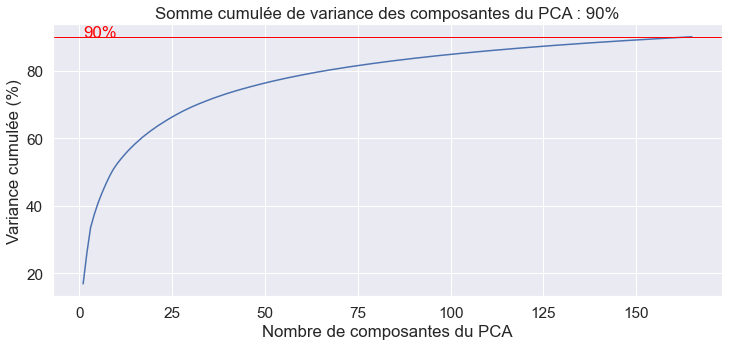

In [105]:
pca_surf, feat_pca_surf = pca_function(im_features_surf)
pca_graph(pca_surf)

In [176]:
print("Dimensions dataset avant réduction PCA : ", im_features_surf.shape)
pca = decomposition.PCA(n_components=0.90)
feat_pca_surf = pca.fit_transform(im_features_surf)
print("Dimensions dataset après réduction PCA : ", feat_pca_surf.shape)

Dimensions dataset avant réduction PCA :  (1050, 1000)
Dimensions dataset après réduction PCA :  (1050, 165)


## 5) Réduction de dimension pour la visualisation par Tsne

In [177]:
tsne = manifold.TSNE(n_components=2, perplexity=30,
                     random_state=6)
X_tsne_surf = tsne.fit_transform(feat_pca_surf)

df_tsne = pd.DataFrame(X_tsne_surf[:, 0:2], columns=['tsne1', 'tsne2'])
df_tsne["class"] = data_pic["categories"]
print(df_tsne.shape)

(1050, 3)


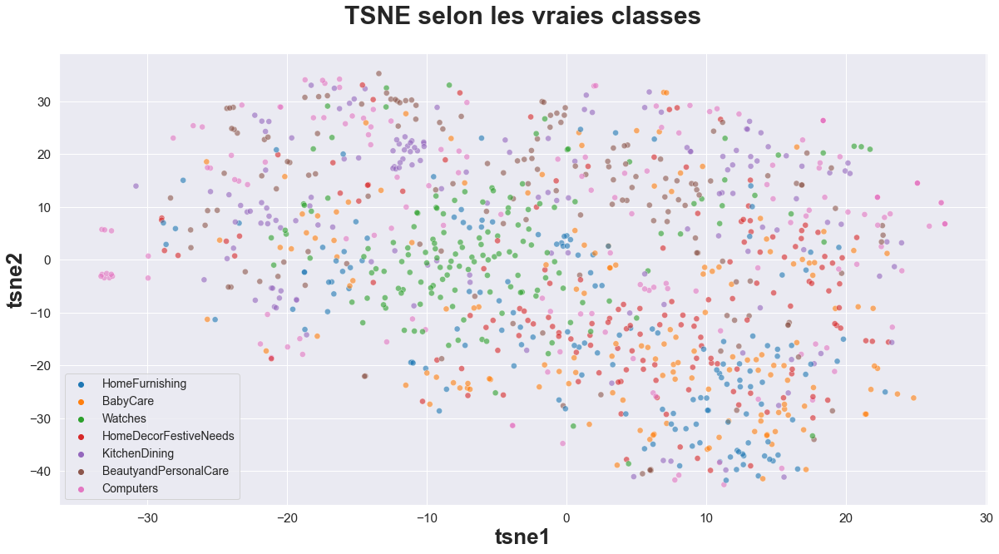

In [178]:
plt.figure(figsize=(20, 10))
sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6)

plt.title('TSNE selon les vraies classes',
          fontsize=30, pad=35, fontweight='bold')
plt.xlabel('tsne1', fontsize=26, fontweight='bold')
plt.ylabel('tsne2', fontsize=26, fontweight='bold')
plt.legend(prop={'size': 14})

plt.show()

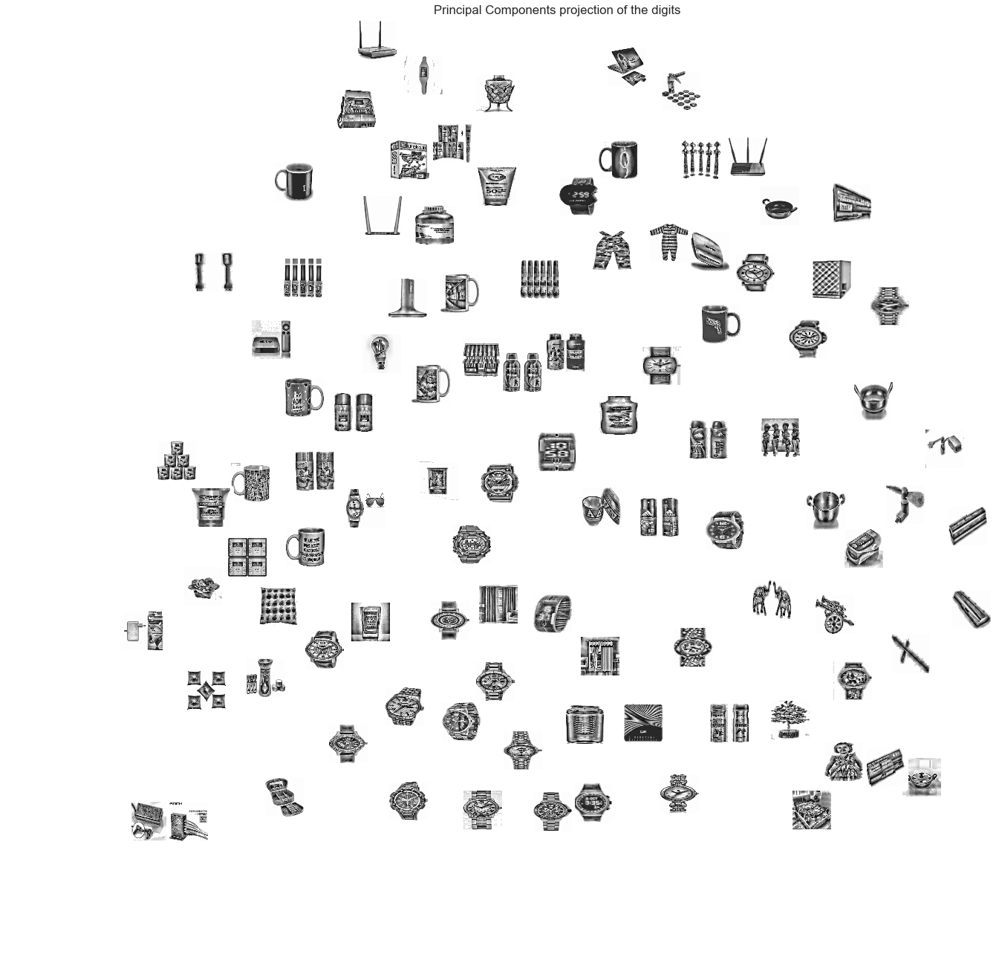

In [179]:
plot_embedding(X_tsne_surf, "Principal Components projection of the digits")
plt.show()

## 6) Analyse de la modélisation 

In [180]:
df_surf = data_pic.copy()

In [181]:
cls = cluster.KMeans(n_clusters=7, random_state=6)
cls.fit(feat_pca_surf)

df_surf["cluster"] = cls.labels_
print(df_tsne.shape)

(1050, 3)


### Silhouette et db score

In [182]:
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import adjusted_rand_score

labels_surf = data_pic["categories"]

ARI_surf = adjusted_rand_score(labels_surf, df_surf["cluster"])
silhouette_surf = metrics.silhouette_score(feat_pca_surf, df_surf["cluster"])
db_score_surf = davies_bouldin_score(feat_pca_surf, df_surf["cluster"])
print(
    f"DB score = {db_score_surf} --- silhouette = {silhouette_surf} ---- ARI = {ARI_surf}")

DB score = 2.234207031491927 --- silhouette = 0.09020777168426389 ---- ARI = 0.06701087166756488


### test avec tsne 

In [183]:
cls = cluster.KMeans(n_clusters=7, random_state=6)
cls.fit(X_tsne_surf)

df_surf["cluster"] = cls.labels_
print(df_tsne.shape)

(1050, 3)


In [184]:
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import adjusted_rand_score

labels_surf = data_pic["categories"]

ARI_surf = adjusted_rand_score(labels_surf, df_surf["cluster"])
silhouette_surf = metrics.silhouette_score(X_tsne_surf, df_surf["cluster"])
db_score_surf = davies_bouldin_score(X_tsne_surf, df_surf["cluster"])
print(
    f"DB score = {db_score_surf} --- silhouette = {silhouette_surf} ---- ARI = {ARI_surf}")

DB score = 0.8373887742872668 --- silhouette = 0.3844575881958008 ---- ARI = 0.08698570661373622


In [115]:
label_surf = pd.concat(
    [df_surf["cluster"], data_pic['label_categories'], data_pic["categories"]], axis=1)

### Confusion matrix

In [116]:
confusion_matrix(label_surf["cluster"], label_surf['label_categories'])

array([[24, 11, 77,  6, 13, 12,  7],
       [59, 52,  3, 29, 12, 10, 14],
       [ 6, 19,  6, 36, 14, 17, 32],
       [30, 33, 20, 50,  5,  8, 16],
       [22, 15, 22,  9, 32, 15, 20],
       [ 4, 12, 15,  9, 32, 49, 26],
       [ 5,  8,  7, 11, 42, 39, 35]])

In [117]:
table_label_surf = pd.pivot_table(label_surf, values='label_categories', index=['categories'],
                                  columns=['cluster'], aggfunc=lambda x: len(x), fill_value=0)

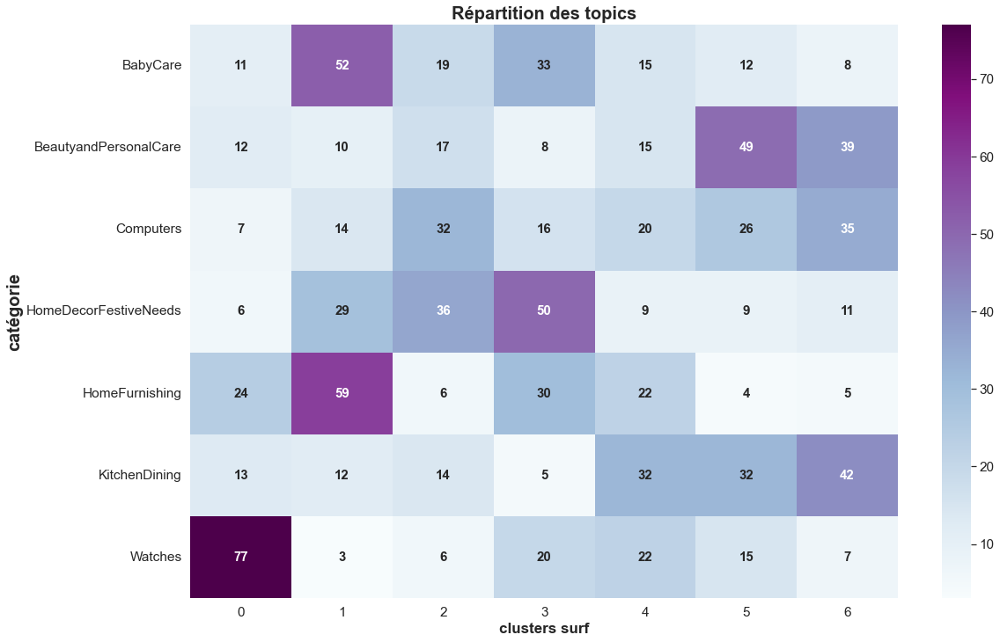

In [118]:
plt.figure(figsize=(18, 12))
plt.title('Répartition des topics', size=20, weight='bold')
sns.set(font_scale=1.4)
sns.heatmap(table_label_surf, annot=True,
            cmap='BuPu',
            annot_kws={"size": 15, 'weight': 'bold'},
            fmt='g')

plt.ylabel("catégorie", weight='bold', size=20)
plt.xlabel('clusters surf', weight='bold', size=17)
plt.show()

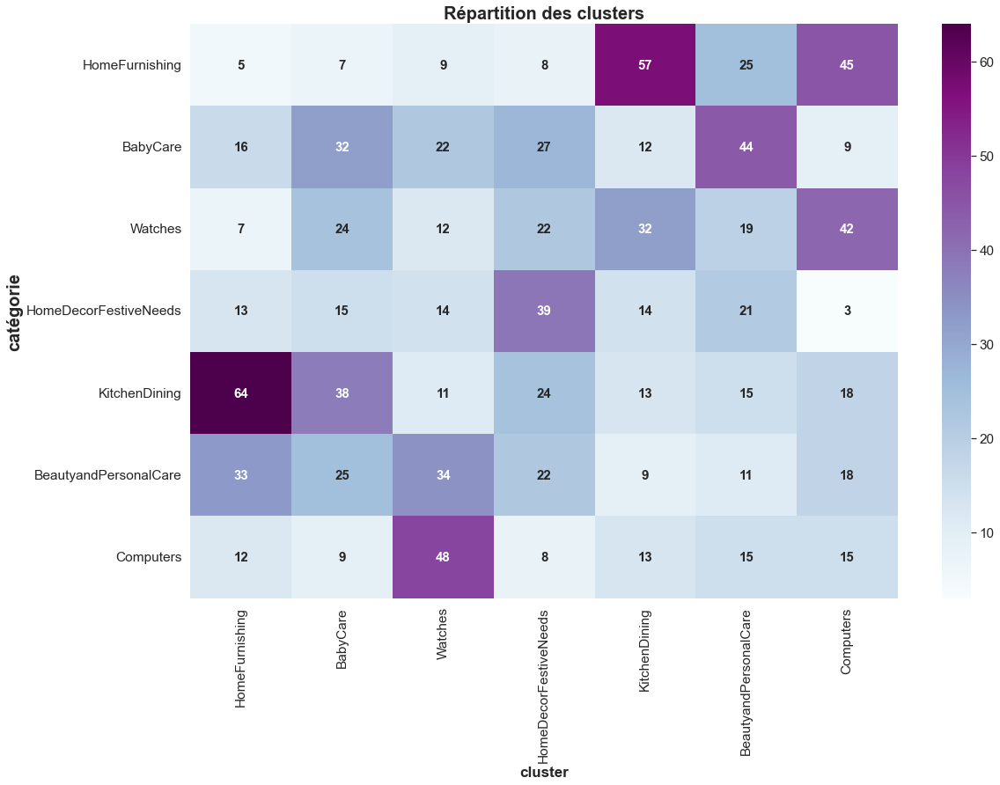

In [119]:
list_labels = ['HomeFurnishing', 'BabyCare', 'Watches', 'HomeDecorFestiveNeeds',
               'KitchenDining', 'BeautyandPersonalCare', 'Computers']
df_cm = pd.DataFrame(conf_mat, index=[label for label in list_labels],
                     columns=[label for label in list_labels])
plt.figure(figsize=(18, 12))
plt.title('Répartition des clusters', size=20, weight='bold')
sns.set(font_scale=1.4)
sns.heatmap(df_cm, annot=True, cmap='BuPu',
            annot_kws={"size": 15, 'weight': 'bold'},
            fmt='g')

plt.ylabel("catégorie", weight='bold', size=20)
plt.xlabel('cluster', weight='bold', size=17)
plt.show()

### Nombre d'erreurs dans le modèle

In [120]:
# Nombre d'erreur
mask = label_surf['label_categories'] == label_surf['cluster']
df_erreur_surf = label_surf[~mask]
display(f'Nombre d\'erreurs : {df_erreur_surf.shape[0]} sur 1050')

"Nombre d'erreurs : 802 sur 1050"

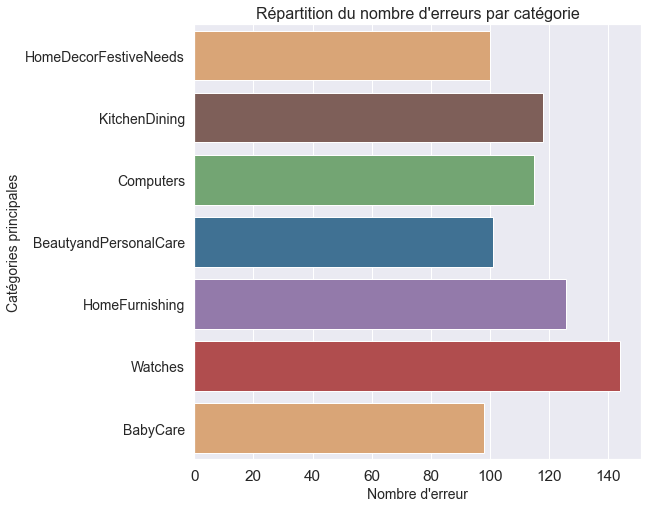

In [121]:
# Répartition des erreurs par catégori
plt.figure(figsize=(8, 8))
sns.countplot(y='categories', data=df_erreur_surf, orient='h',
              order=df_erreur_orb['categories'].value_counts().index,
              palette=['#e9a467', '#845b53', '#6bad6b', '#3274a1',
                       '#9372b2', '#c03d3e'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=16)
plt.xlabel('Nombre d\'erreur', fontsize=14)
plt.ylabel('Catégories principales', fontsize=14)
plt.yticks(fontsize=14)
plt.show()

# Pour aller plus loins : 

# Réseau de neurones convolutif :
transfert learning entrainer sur 16 couches 

In [122]:
from keras.layers import Flatten, Dense

In [123]:
from keras.applications.vgg16 import VGG16
from keras.layers import Dense
from keras import Model
from keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import preprocess_input
import glob
# Charger VGG-16 pré-entraîné sur ImageNet et sans les couches fully-connected
model = VGG16(weights="imagenet", include_top=True, input_shape=(224, 224, 3))

# Récupérer la sortie de ce réseau
x = model.output

# Ajouter la nouvelle couche fully-connected pour la classification à 7 classes
predictions = Dense(7, activation='softmax')(x)


for layer in model.layers:
    layer.trainable = False

# Définir le nouveau modèle
new_model = Model(inputs=model.input, outputs=model.layers[-2].output)

2021-12-09 22:32:17.034149: I tensorflow/core/platform/cpu_feature_guard.cc:145] This TensorFlow binary is optimized with Intel(R) MKL-DNN to use the following CPU instructions in performance critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in non-MKL-DNN operations, rebuild TensorFlow with the appropriate compiler flags.
2021-12-09 22:32:17.035671: I tensorflow/core/common_runtime/process_util.cc:115] Creating new thread pool with default inter op setting: 8. Tune using inter_op_parallelism_threads for best performance.


In [124]:
new_model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0   

In [125]:
def preprocess_VGG16(img):
    # VGG16 expects a 224x224 image np.array
    img = load_img(img, target_size=(224, 224))
    img = np.array(img)
    img = img.reshape(1, 224, 224, 3)
    img = preprocess_input(img)  # for VGG16
    return img

In [126]:
def model_vgg16(img, model=new_model):
    features = model.predict(img)
    return features

In [127]:
df['path'] = df['image'].apply(
    lambda x: '/Users/vincentMalfroy/Desktop/OpenClassrooms/projet 6/Flipkart/Images/'+str(x))

In [128]:
df['resize_VGG16'] = df['path'].apply(preprocess_VGG16)

/Users/vincentMalfroy/opt/anaconda3/envs/Tensor/lib/python3.7/site-packages/PIL/Image.py:2921: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


In [129]:
df['preprocess_VGG16'] = df['resize_VGG16'].apply(model_vgg16)

In [130]:
vgg16_feat = np.array(df['preprocess_VGG16'].values.tolist())
print('Shape:', vgg16_feat.shape)
vgg16_feat = vgg16_feat.reshape(-1, vgg16_feat.shape[2])
print('Reshape Shape:', vgg16_feat.shape)

Shape: (1050, 1, 4096)
Reshape Shape: (1050, 4096)


In [131]:
print("Dimensions dataset avant réduction PCA : ", vgg16_feat.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca_VGG = pca.fit_transform(vgg16_feat)
print("Dimensions dataset après réduction PCA : ", feat_pca_VGG.shape)

Dimensions dataset avant réduction PCA :  (1050, 4096)
Dimensions dataset après réduction PCA :  (1050, 803)


In [188]:
tsne = manifold.TSNE(n_components=2, perplexity=30,
                     random_state=6)
X_tsne_vgg = tsne.fit_transform(feat_pca_VGG)

df_tsne = pd.DataFrame(X_tsne_vgg[:, 0:2], columns=['tsne1', 'tsne2'])
df_tsne["class"] = data_pic["categories"]
print(df_tsne.shape)

(1050, 3)


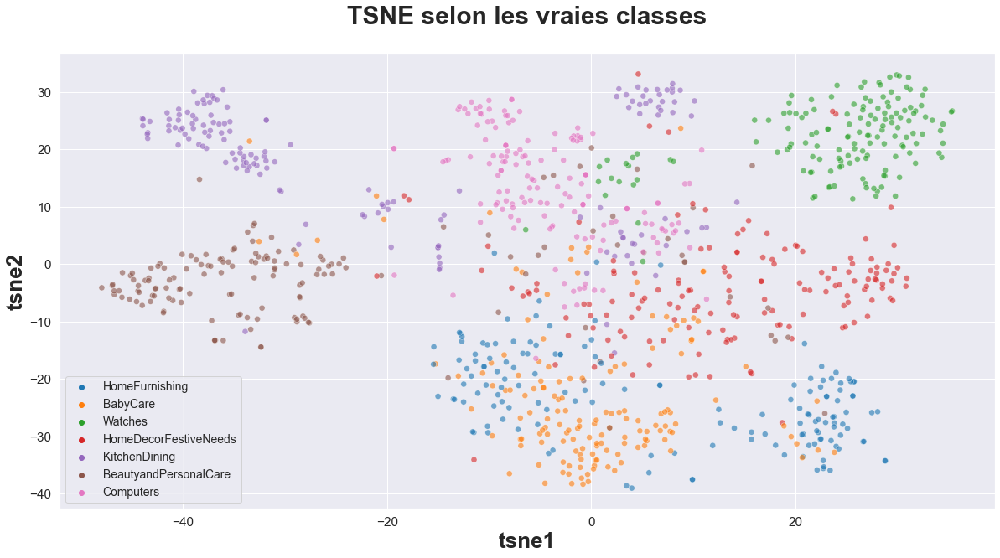

In [133]:
plt.figure(figsize=(20, 10))
sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6)

plt.title('TSNE selon les vraies classes',
          fontsize=30, pad=35, fontweight='bold')
plt.xlabel('tsne1', fontsize=26, fontweight='bold')
plt.ylabel('tsne2', fontsize=26, fontweight='bold')
plt.legend(prop={'size': 14})

plt.show()

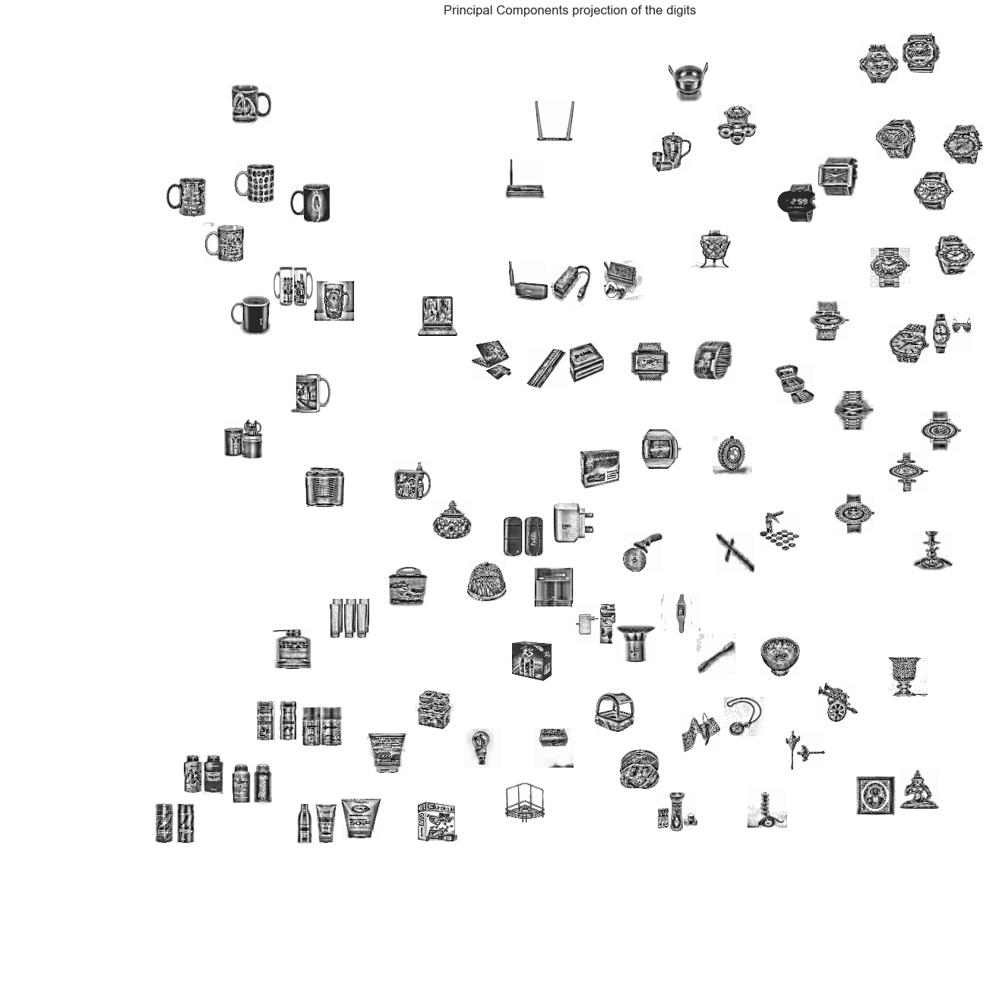

In [134]:
plot_embedding(X_tsne_vgg, "Principal Components projection of the digits")
plt.show()

In [135]:
df_vgg = data_pic.copy()

In [190]:
from sklearn.cluster import KMeans
cls = KMeans(n_clusters=7, random_state=6)
cls_vgg16 = cls.fit(X_tsne_vgg)  # utiliser PCA "feat_pca"

df_vgg["cluster"] = cls_vgg16.labels_
print(df_vgg.shape)

(1050, 6)


Les clusters créer ne correspondent pas à nos cluster de se fait nous devons reatribuer le bon label de clusters manuelement

In [229]:
df_vgg[df_vgg['categories'] == 'HomeFurnishing']

,image,categories,label_categories,cluster,cluster_retablit,cluster_inverse
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,HomeFurnishing,0,6,4,KitchenDining
3,d4684dcdc759dd9cdf41504698d737d8.jpg,HomeFurnishing,0,6,4,KitchenDining
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,HomeFurnishing,0,6,4,KitchenDining
33,b85f8843bb1c297dd5712f0bd287006d.jpg,HomeFurnishing,0,6,4,KitchenDining
34,a4b09aa7927c59fbb39960b3d7919909.jpg,HomeFurnishing,0,6,4,KitchenDining
35,81e739c7f3be737152f2e6f520e3494b.jpg,HomeFurnishing,0,4,0,HomeFurnishing
39,66191b4a311b5d9babfc00a71ef97c5b.jpg,HomeFurnishing,0,4,0,HomeFurnishing
41,a79117ea49a0533f641facdb4c99f502.jpg,HomeFurnishing,0,4,0,HomeFurnishing
67,707b160df4c4dece6cde52b222ce624b.jpg,HomeFurnishing,0,6,4,KitchenDining
71,f2658bad8c2b7d5b08984c6ac34267f7.jpg,HomeFurnishing,0,6,4,KitchenDining


In [227]:
label_vgg = df_vgg[df_vgg['cluster'] == 6]

In [228]:
label_vgg['categories'].value_counts()

HomeFurnishing           72
BabyCare                  9
HomeDecorFestiveNeeds     5
BeautyandPersonalCare     1
Name: categories, dtype: int64

### Retablissement des bon clusters

In [230]:
clusters_invers = {0: 3,
                   1: 6,
                   2: 5,
                   3: 2,
                   4: 1,
                   5: 4,
                   6: 0}

df_vgg["cluster_retablit"] = df_vgg["cluster"].map(clusters_invers)

In [231]:
labels = df_vgg["categories"]
ARI = adjusted_rand_score(labels, df_vgg["cluster_retablit"])
db_score = davies_bouldin_score(X_tsne_vgg, df_vgg["cluster_retablit"])
silhouette_vgg = metrics.silhouette_score(X_tsne_vgg, df_vgg["cluster"])
print(f"DB score = {db_score} --- ARI = {ARI} ---- silhouette{silhouette_vgg}")

DB score = 0.6797887016475299 --- ARI = 0.48241760249700066 ---- silhouette0.4792441427707672


In [232]:
label_vgg = pd.concat(
    [df_vgg["cluster_retablit"], df_vgg['label_categories'], df_vgg['categories']], axis=1)

In [233]:
conf_mat = confusion_matrix(
    label_vgg["cluster_retablit"], label_vgg['label_categories'])

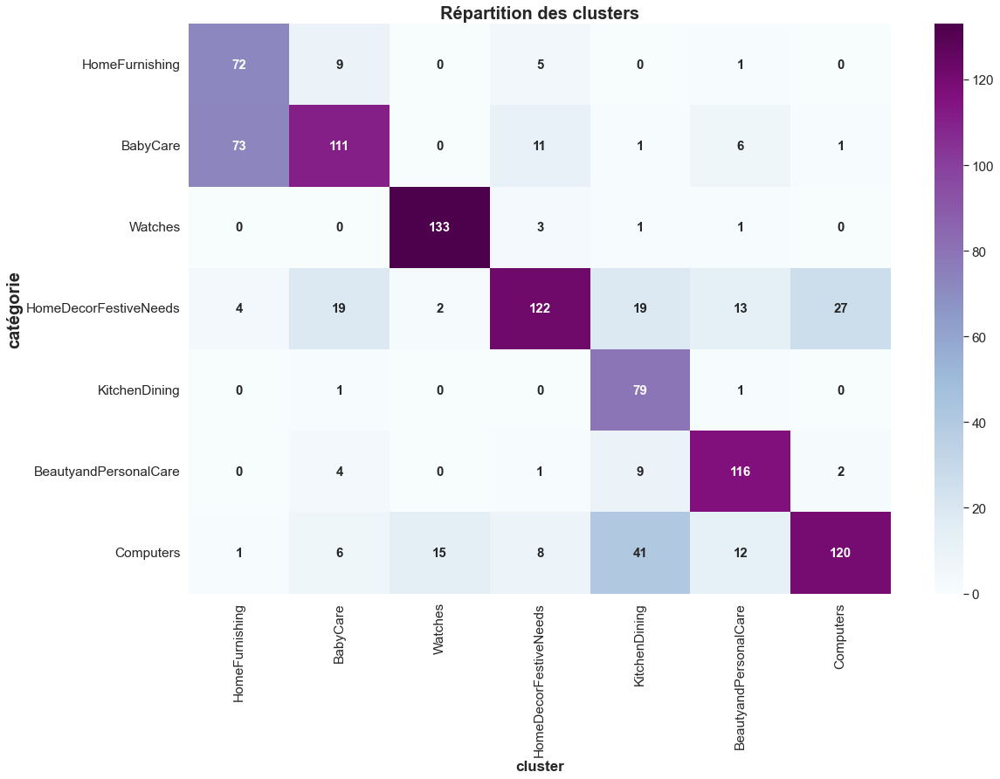

In [234]:
list_labels = ['HomeFurnishing', 'BabyCare', 'Watches', 'HomeDecorFestiveNeeds',
               'KitchenDining', 'BeautyandPersonalCare', 'Computers']
df_cm = pd.DataFrame(conf_mat, index=[label for label in list_labels],
                     columns=[label for label in list_labels])
plt.figure(figsize=(18, 12))
plt.title('Répartition des clusters', size=20, weight='bold')
sns.set(font_scale=1.4)
sns.heatmap(df_cm, annot=True, cmap='BuPu',
            annot_kws={"size": 15, 'weight': 'bold'},
            fmt='g')

plt.ylabel("catégorie", weight='bold', size=20)
plt.xlabel('cluster', weight='bold', size=17)
plt.show()

In [235]:
# Nombre d'erreur
mask = label_vgg['label_categories'] == label_vgg['cluster_retablit']
df_erreur_vgg = label_vgg[~mask]
display(f'Nombre d\'erreurs : {df_erreur_vgg.shape[0]} sur 1050')

"Nombre d'erreurs : 297 sur 1050"

In [236]:
df_vgg["cluster_retablit"] = df_vgg["cluster"].map(clusters_invers)

In [237]:
clusters_noms = {0: 'HomeFurnishing',
                 1: 'BabyCare',
                 2: 'Watches',
                 3: 'HomeDecorFestiveNeeds',
                 4: 'KitchenDining',
                 5: 'BeautyandPersonalCare',
                 6: 'Computers'}

df_vgg["cluster_inverse"] = df_vgg["cluster_retablit"].map(clusters_noms)

In [238]:
path = ('/Users/vincentMalfroy/Desktop/OpenClassrooms/projet 6/Flipkart/Images/')


def evaluation_comp(index):
    im = Image.open(path+data_pic.image[index])
    print('Name:  ', df['product_name'].iloc[index])
    print('categorie: ', df["categories"].iloc[index])

    print('cluster: ', df_vgg["cluster_inverse"].iloc[index])

    plt.figure(figsize=(7, 7))
    plt.imshow(im)

Name:   Baby Bucket Cartoon Single Blanket blue
categorie:  HomeFurnishing
cluster:  BabyCare


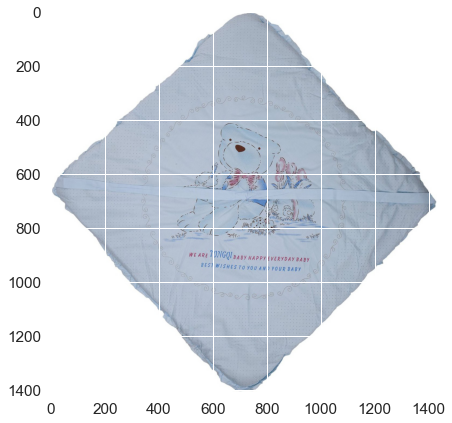

In [276]:
evaluation_comp(920)

Name:   fastrack 38015PL01 Analog Watch  - For Men, Boys
categorie:  Watches
cluster:  BeautyandPersonalCare


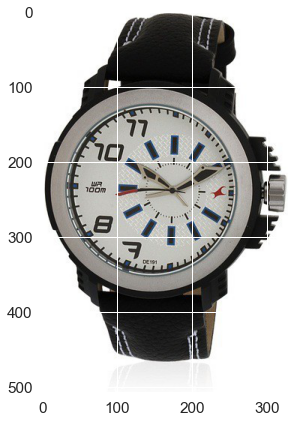

In [209]:
evaluation_comp(24)

Name:   fastrack 38015PL01 Analog Watch  - For Men, Boys
categorie:  Watches
cluster:  Watches


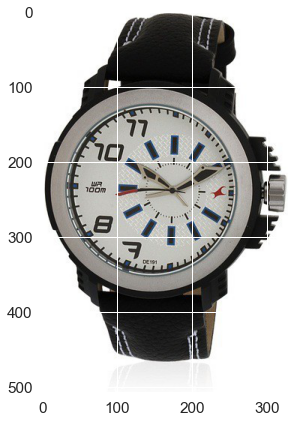

In [151]:
evaluation_comp(24)

Name:   Ech oly Ceramic Inside Fitting Hookah Mouth Tip
categorie:  HomeDecorFestiveNeeds
cluster:  HomeDecorFestiveNeeds


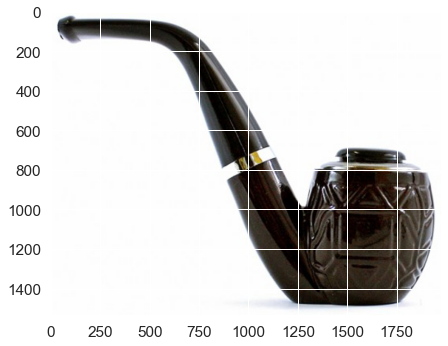

In [152]:
evaluation_comp(1012)

## Texte et images

La partie texte combiné avec les images se trouvent sur le notebook "NLP - Computer"